# WT

In [1]:
%matplotlib inline
# Import modules

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

import graphviz
from sklearn import tree
from sklearn.metrics import accuracy_score, roc_curve, auc, confusion_matrix, ConfusionMatrixDisplay
from sklearn.ensemble import RandomForestClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.model_selection import train_test_split

# Local modules
import constantes
import auxiliary
import models
import plots

In [2]:
# Used dataset
data_frame = auxiliary.read_dataframe("../data/WT_KI_CD3_in-tumor.csv", index_col=0)

In [3]:
data_frame.head()

,Condition,FileName,X,Y,Coherency100,Energy100,MeanInt100,VarInt100,Density100,VarDensity100,...,Cells100um,MinDist100um,MedDist100um,CellArea100um,CellEcc100um,Frac,class_t_plus,class_t_enriched,class_t_enriched_2,class_density
107048,WT,./12c_ZF_ MAX_12c_MW137_CD3FITC_SHG.tif,4987,625,-3.0,-3.0,-3.0,-3.0,0.0,-3.0,...,0.0,0.0,0.0,0.0,0.0,NaN,0,0,0,0
107205,WT,./12c_ZF_ MAX_12c_MW137_CD3FITC_SHG.tif,4867,665,-3.0,-3.0,-3.0,-3.0,0.0,-3.0,...,0.0,0.0,0.0,0.0,0.0,NaN,0,0,0,0
107206,WT,./12c_ZF_ MAX_12c_MW137_CD3FITC_SHG.tif,4907,665,-3.0,-3.0,-3.0,-3.0,0.0,-3.0,...,0.0,0.0,0.0,0.0,0.0,NaN,0,0,0,0
107207,WT,./12c_ZF_ MAX_12c_MW137_CD3FITC_SHG.tif,4947,665,-3.0,-3.0,-3.0,-3.0,0.0,-3.0,...,0.0,0.0,0.0,0.0,0.0,NaN,0,0,0,0
107208,WT,./12c_ZF_ MAX_12c_MW137_CD3FITC_SHG.tif,4987,665,-3.0,-3.0,-3.0,-3.0,0.0,-3.0,...,0.0,0.0,0.0,0.0,0.0,NaN,0,0,0,0


In [4]:
# Mask for the studied phenotype
MASK = data_frame["Condition"] == "WT"
data = data_frame[MASK]

#### T plus

Prédiction des fenêtres de classe T+

##### Jeu de données d'apprentissage et de validation (avec valeurs abérrantes)

In [5]:
# Features columns (without Dist & Angle information)
x_columns = [
    *constantes.float20_columns,
    *constantes.float60_columns,
    *constantes.float100_columns,
    *constantes.float140_columns
]

x_columns.remove("Angle20")
x_columns.remove("Angle60")
x_columns.remove("Angle100")
x_columns.remove("Angle140")

# Features columns with Dist & Angle attributes
x_columns_dist = [
    *constantes.float20_columns,
    *constantes.float60_columns,
    *constantes.float100_columns,
    *constantes.float140_columns,
    *constantes.dist_columns
]

# Target column
y_column = "class_t_plus"

# Define X and Y dataframe

XY = data.dropna()[x_columns_dist + [y_column]]
X = XY[x_columns].values  # X
X_dist = XY[x_columns_dist].values  # X_dist
Y = XY[y_column].values  # Y

# Train and Validation set
X_train, X_test, Y_train, Y_test = train_test_split(
    X, Y, test_size=0.3, random_state=42, stratify=Y
)

# Train and Validation set & (Angle & Dist) (to validate the model)
X_dist_train, X_dist_test, Y_dist_train, Y_dist_test = train_test_split(
    X_dist, Y, test_size=0.3, random_state=42, stratify=Y
)

In [6]:
print(f"----- T plus -----")
print(f"{'Classe :':^45s}{'0':>6s}{'':2s}{'1':>6s}")
print(f"{'Comptage des classes au sein de Y:':45s}{sum(Y == 0):>6d}{'':2s}{sum(Y == 1):>6d}")
print(f"{'Comptage des classes au sein de Y_train:':45s}{sum(Y_train == 0):>6d}{'':2s}{sum(Y_train == 1):>6d}")
print(f"{'Comptage des classes au sein de Y_test:':45s}{sum(Y_test == 0):>6d}{'':2s}{sum(Y_test == 1):>6d}")
print(f"\nNombre d'observations totales : {Y.shape[0]:_}")

----- T plus -----
                  Classe :                        0       1
Comptage des classes au sein de Y:            79264  291142
Comptage des classes au sein de Y_train:      55485  203799
Comptage des classes au sein de Y_test:       23779   87343

Nombre d'observations totales : 370_406


##### Arbre de décision

In [7]:
max_depths_clf = [2, 4, 6, 8, 10, 15, 20]

# Best number of depth
results_t_plus = models.forest_depth_acc(
    X_train, Y_train, X_test, Y_test,
    depths=max_depths_clf, 
    classifier=DecisionTreeClassifier,
    class_weight="balanced"
)

# Best number of depth with Dist & Angle
results_dist_t_plus = models.forest_depth_acc(
    X_dist_train, Y_dist_train, X_dist_test, Y_dist_test,
    depths=max_depths_clf, 
    classifier=DecisionTreeClassifier,
    class_weight="balanced"
)

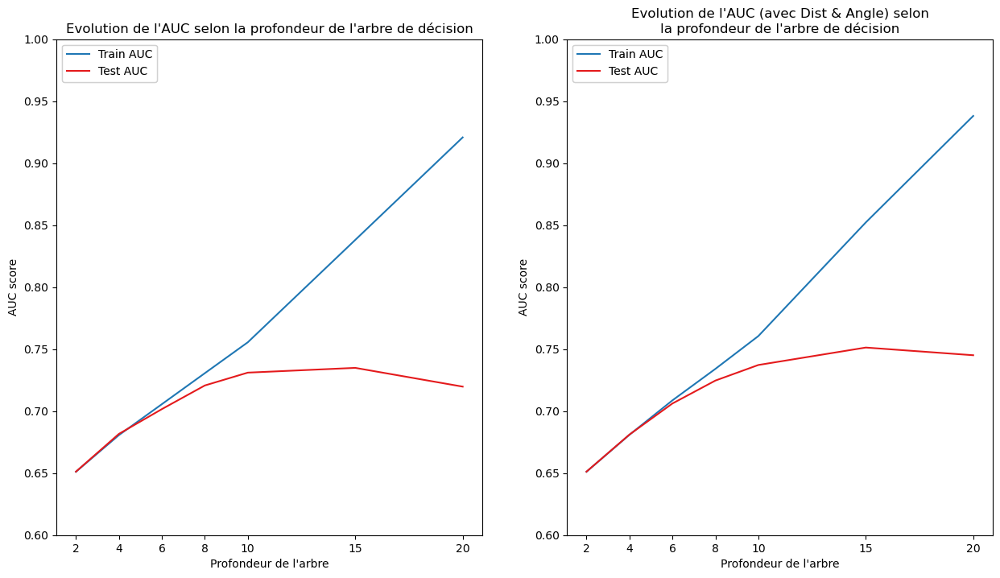

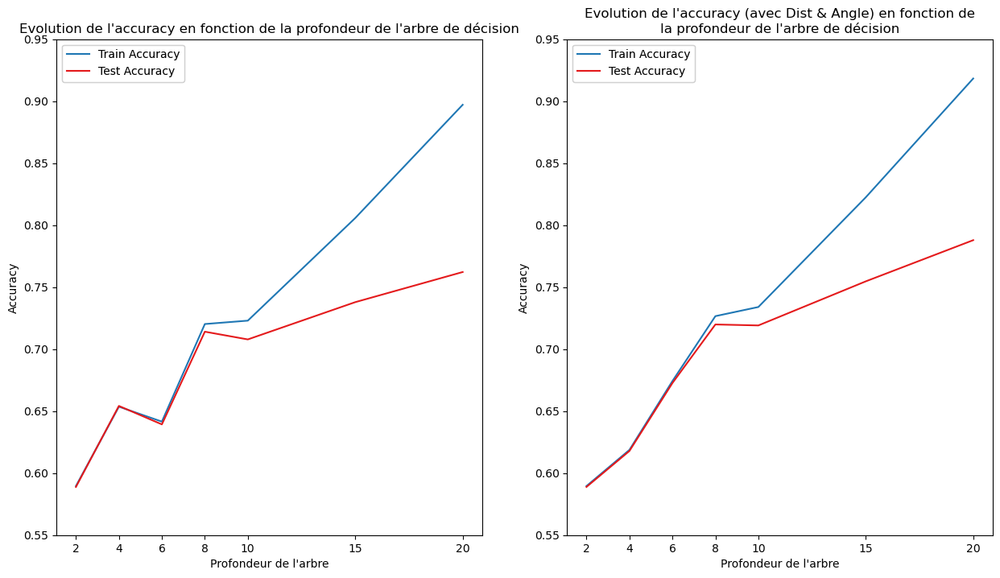

In [8]:
# Plot
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(15, 8))
plots.plot(
    results_t_plus["auc_train"],
    results_t_plus["auc_test"],
    indices=max_depths_clf,
    label=("Train AUC", "Test AUC"),
    title="Evolution de l'AUC selon la profondeur de l'arbre de décision",
    xlabel="Profondeur de l'arbre", ylabel="AUC score",
    xticks=max_depths_clf, showR2=False, showY=False,
    ytop=1, ybottom=0.6, figure=(fig, ax1)
)

plots.plot(
    results_dist_t_plus["auc_train"],
    results_dist_t_plus["auc_test"],
    indices=max_depths_clf,
    label=("Train AUC", "Test AUC"),
    title="Evolution de l'AUC (avec Dist & Angle) selon\nla profondeur de l'arbre de décision",
    xlabel="Profondeur de l'arbre", ylabel="AUC score",
    xticks=max_depths_clf, showR2=False, showY=False,
    ytop=1, ybottom=0.6, figure=(fig, ax2)
)
plt.show()

# Plot
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(15, 8))

plots.plot(
    results_t_plus["acc_train"],
    results_t_plus["acc_test"],
    indices=max_depths_clf,
    label=("Train Accuracy", "Test Accuracy"),
    title="Evolution de l'accuracy en fonction de la profondeur de l'arbre de décision",
    xlabel="Profondeur de l'arbre", ylabel="Accuracy",
    xticks=max_depths_clf, showR2=False, showY=False,
    ytop=0.95, ybottom=0.55, figure=(fig, ax1)
)

plots.plot(
    results_dist_t_plus["acc_train"],
    results_dist_t_plus["acc_test"],
    indices=max_depths_clf,
    label=("Train Accuracy", "Test Accuracy"),
    title="Evolution de l'accuracy (avec Dist & Angle) en fonction de\nla profondeur de l'arbre de décision",
    xlabel="Profondeur de l'arbre", ylabel="Accuracy",
    xticks=max_depths_clf, showR2=False, showY=False,
    ytop=0.95, ybottom=0.55, figure=(fig, ax2)
)
plt.show()

In [9]:
print("----- Résumé des performances T plus, arbre de décision -----")
print(f"{'Profondeur':<20s}:", end=" ") ; [print(f"{i:<4d}", end="  ") for i in results_t_plus["depths"]] ; print("\n")
print(f"{'AUC_train':<20s}:", end=" ") ; [print(f"{i:<.2f}", end="  ") for i in results_t_plus["auc_train"]] ; print()
print(f"{'AUC_test':<20s}:", end=" ") ; [print(f"{i:<.2f}", end="  ") for i in results_t_plus["auc_test"]] ; print("\n")

print(f"{'Accuracy_train':<20s}:", end=" ") ; [print(f"{i:<.2f}", end="  ") for i in results_t_plus["acc_train"]] ; print()
print(f"{'Accuracy_test':<20s}:", end=" ") ; [print(f"{i:<.2f}", end="  ") for i in results_t_plus["acc_test"]] ; print("\n")

print("---")
print(f"{'AUC_train_dist':<20s}:", end=" ") ; [print(f"{i:<.2f}", end="  ") for i in results_dist_t_plus["auc_train"]] ; print()
print(f"{'AUC_test_dist':<20s}:", end=" ") ; [print(f"{i:<.2f}", end="  ") for i in results_dist_t_plus["auc_test"]] ; print("\n")

print(f"{'Accuracy_train_dist':<20s}:", end=" ") ; [print(f"{i:<.2f}", end="  ") for i in results_dist_t_plus["acc_train"]] ; print()
print(f"{'Accuracy_test_dist':<20s}:", end=" ") ; [print(f"{i:<.2f}", end="  ") for i in results_dist_t_plus["acc_test"]] ; print()

----- Résumé des performances T plus, arbre de décision -----
Profondeur          : 2     4     6     8     10    15    20    

AUC_train           : 0.65  0.68  0.71  0.73  0.76  0.84  0.92  
AUC_test            : 0.65  0.68  0.70  0.72  0.73  0.73  0.72  

Accuracy_train      : 0.59  0.65  0.64  0.72  0.72  0.81  0.90  
Accuracy_test       : 0.59  0.65  0.64  0.71  0.71  0.74  0.76  

---
AUC_train_dist      : 0.65  0.68  0.71  0.73  0.76  0.85  0.94  
AUC_test_dist       : 0.65  0.68  0.71  0.72  0.74  0.75  0.75  

Accuracy_train_dist : 0.59  0.62  0.67  0.73  0.73  0.82  0.92  
Accuracy_test_dist  : 0.59  0.62  0.67  0.72  0.72  0.75  0.79  


In [10]:
# Decision Tree (CART)
clf_plus = DecisionTreeClassifier(
    criterion="entropy",
    max_depth=12,
    random_state=42,
    class_weight="balanced"
)

clf_plus.fit(X_train, Y_train)
y_train_pred = clf_plus.predict(X_train)
y_test_pred = clf_plus.predict(X_test)

# Decision Tree (CART) with Dist column
clf_dist_plus = DecisionTreeClassifier(
    criterion="entropy",
    max_depth=12,
    random_state=42,
    class_weight="balanced"
)

clf_dist_plus.fit(X_dist_train, Y_dist_train)
y_dist_train_pred = clf_dist_plus.predict(X_dist_train)
y_dist_test_pred = clf_dist_plus.predict(X_dist_test)
clf_dist_plus

DecisionTreeClassifier(class_weight='balanced', criterion='entropy',
                       max_depth=12, random_state=42)

In [11]:
labels_class = pd.Series(clf_plus.classes_).map({0: 'not_plus', 1: 'plus'}).values

In [12]:
false_pos_rate_train, true_pos_rate_train, _ = roc_curve(Y_train, y_train_pred)
false_pos_rate_test, true_pos_rate_test, _ = roc_curve(Y_test, y_test_pred)

false_pos_rate_dist_train, true_pos_rate_dist_train, _ = roc_curve(Y_dist_train, y_dist_train_pred)
false_pos_rate_dist_test, true_pos_rate_dist_test, _ = roc_curve(Y_dist_test, y_dist_test_pred)

----- Arbre de décision -----
Accuracy Train: 0.7575245676555438
AUC Train: 0.7809810574602046

Accuracy Test: 0.7285596011590864
AUC Test: 0.7364645336535274



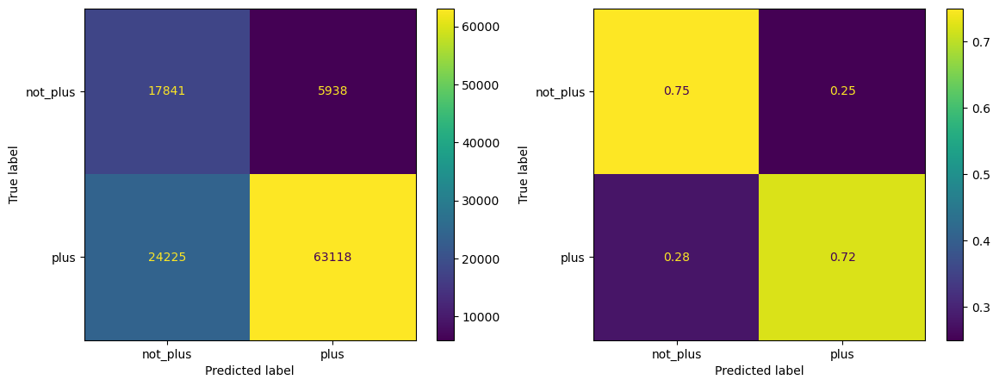

In [13]:
# Model Accuracy, how often is the classifier correct?
print("----- Arbre de décision -----")
print("Accuracy Train:", accuracy_score(Y_train, y_train_pred))
print("AUC Train:", auc(false_pos_rate_train, true_pos_rate_train))
print()
print("Accuracy Test:", accuracy_score(Y_test, y_test_pred))
print("AUC Test:", auc(false_pos_rate_test, true_pos_rate_test))
print()

fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(14, 5))
cm = confusion_matrix(Y_test, y_test_pred)
cm2 = confusion_matrix(Y_test, y_test_pred, normalize="true")
ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=labels_class).plot(ax=ax1)
ConfusionMatrixDisplay(confusion_matrix=cm2, display_labels=labels_class).plot(ax=ax2)
plt.show()

Arbre de décision acc, Angle avec Dist
Accuracy Train: 0.9199989201030531
AUC Train: 0.9399285007800388

Accuracy Test: 0.882399524846565
AUC Test: 0.8775912005518272


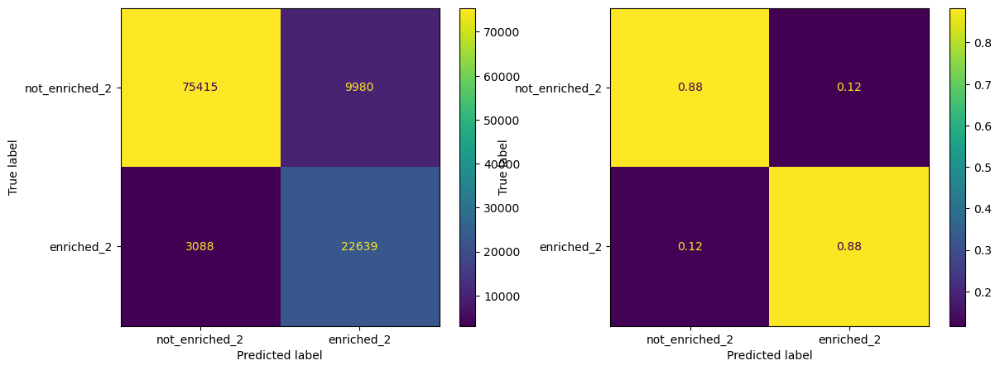

In [143]:
print("Arbre de décision acc, Angle avec Dist")
print("Accuracy Train:", accuracy_score(Y_dist_train, y_dist_train_pred))
print("AUC Train:", auc(false_pos_rate_dist_train, true_pos_rate_dist_train))
print()
print("Accuracy Test:", accuracy_score(Y_dist_test, y_dist_test_pred))
print("AUC Test:", auc(false_pos_rate_dist_test, true_pos_rate_dist_test))

fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(14, 5))
cm_dist = confusion_matrix(Y_dist_test, y_dist_test_pred)
cm2_dist = confusion_matrix(Y_dist_test, y_dist_test_pred, normalize="true")
ConfusionMatrixDisplay(confusion_matrix=cm_dist, display_labels=labels_class).plot(ax=ax1)
ConfusionMatrixDisplay(confusion_matrix=cm2_dist, display_labels=labels_class).plot(ax=ax2)
plt.show()

In [15]:
# Arbre de Décision
fig = plt.figure(figsize=(10, 30))
dot_data = tree.export_graphviz(
    clf_plus,
    feature_names=x_columns,
    class_names=labels_class,
    filled=True
)
graph = graphviz.Source(dot_data, format="png")
graph.render("../out/tree_analysis/WT_decision_tree_t-plus")
graph

dot: graph is too large for cairo-renderer bitmaps. Scaling by 0.0821613 to fit


<Figure size 1000x3000 with 0 Axes>

In [16]:
# Arbre de décision avec l'ajout de Dist & Angle
fig = plt.figure(figsize=(10, 25))
dot_data = tree.export_graphviz(
    clf_dist_plus,
    feature_names=x_columns_dist,
    class_names=labels_class,
    filled=True
)
graph = graphviz.Source(dot_data, format="png")
graph.render("../out/WT_decision_tree_t-plus_dist")
graph

dot: graph is too large for cairo-renderer bitmaps. Scaling by 0.082659 to fit


<Figure size 1000x2500 with 0 Axes>

##### Random Forest

In [17]:
max_depths_rd = [2, 6, 10, 15, 20]
results_t_plus_rf = models.forest_depth_acc(
    X_train, Y_train, X_test, Y_test,
    depths=max_depths_rd, 
    classifier=RandomForestClassifier,
    n_estimators = 100,
    class_weight="balanced",
    n_jobs=-1
)

results_dist_t_plus_rf = models.forest_depth_acc(
    X_dist_train, Y_dist_train, X_dist_test, Y_dist_test,
    depths=max_depths_rd, 
    classifier=RandomForestClassifier,
    n_estimators = 100,
    class_weight="balanced",
    n_jobs=-1
)

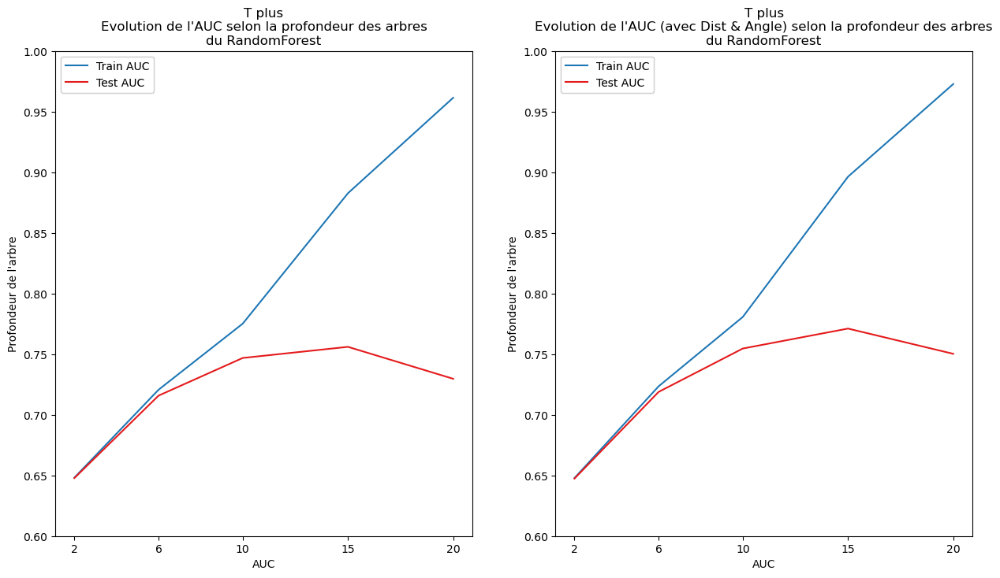

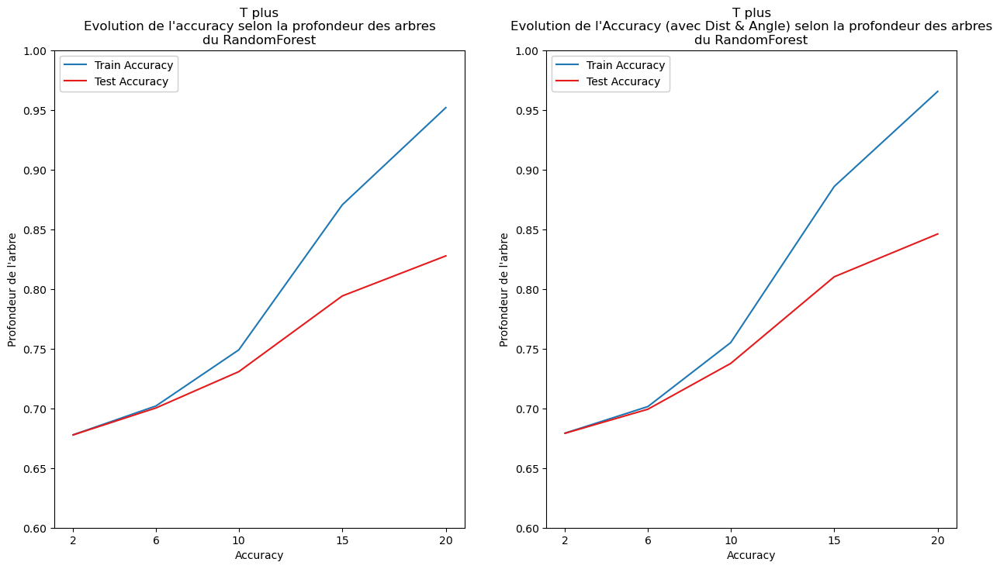

In [18]:
# Plot
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(15, 8))

plots.plot(
    results_t_plus_rf["auc_train"],
    results_t_plus_rf["auc_test"],
    indices=results_t_plus_rf["depths"],
    label=("Train AUC", "Test AUC"),
    title="T plus\nEvolution de l'AUC selon la profondeur des arbres\ndu RandomForest",
    xlabel="AUC", ylabel="Profondeur de l'arbre",
    xticks=results_t_plus_rf["depths"], showR2=False, showY=False,
    ytop=1, ybottom=0.6, figure=(fig, ax1)
)

plots.plot(
    results_dist_t_plus_rf["auc_train"],
    results_dist_t_plus_rf["auc_test"],
    indices=results_dist_t_plus_rf["depths"],
    label=("Train AUC", "Test AUC"),
    title="T plus\nEvolution de l'AUC (avec Dist & Angle) selon la profondeur des arbres\ndu RandomForest",
    xlabel="AUC", ylabel="Profondeur de l'arbre",
    xticks=results_dist_t_plus_rf["depths"], showR2=False, showY=False,
    ytop=1, ybottom=0.6, figure=(fig, ax2)
)

plt.show()

# Plot
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(15, 8))

plots.plot(
    results_t_plus_rf["acc_train"],
    results_t_plus_rf["acc_test"],
    indices=results_t_plus_rf["depths"],
    label=("Train Accuracy", "Test Accuracy"),
    title="T plus\nEvolution de l'accuracy selon la profondeur des arbres\ndu RandomForest",
    xlabel="Accuracy", ylabel="Profondeur de l'arbre",
    xticks=results_t_plus_rf["depths"], showR2=False, showY=False,
    ytop=1, ybottom=0.6, figure=(fig, ax1)
)

plots.plot(
    results_dist_t_plus_rf["acc_train"],
    results_dist_t_plus_rf["acc_test"],
    indices=results_dist_t_plus_rf["depths"],
    label=("Train Accuracy", "Test Accuracy"),
    title="T plus\nEvolution de l'Accuracy (avec Dist & Angle) selon la profondeur des arbres\ndu RandomForest",
    xlabel="Accuracy", ylabel="Profondeur de l'arbre",
    xticks=results_dist_t_plus_rf["depths"], showR2=False, showY=False,
    ytop=1, ybottom=0.6, figure=(fig, ax2)
)

plt.show()

In [19]:
print("----- Résumé des performances T plus, arbre de décision -----")
print(f"{'Profondeur':<20s}:", end=" ") ; [print(f"{i:<4d}", end="  ") for i in results_t_plus_rf["depths"]] ; print("\n")
print(f"{'AUC_train':<20s}:", end=" ") ; [print(f"{i:<.2f}", end="  ") for i in results_t_plus_rf["auc_train"]] ; print()
print(f"{'AUC_test':<20s}:", end=" ") ; [print(f"{i:<.2f}", end="  ") for i in results_t_plus_rf["auc_test"]] ; print("\n")

print(f"{'Accuracy_train':<20s}:", end=" ") ; [print(f"{i:<.2f}", end="  ") for i in results_t_plus_rf["acc_train"]] ; print()
print(f"{'Accuracy_test':<20s}:", end=" ") ; [print(f"{i:<.2f}", end="  ") for i in results_t_plus_rf["acc_test"]] ; print("\n")

print("---")
print(f"{'AUC_train_dist':<20s}:", end=" ") ; [print(f"{i:<.2f}", end="  ") for i in results_dist_t_plus_rf["auc_train"]] ; print()
print(f"{'AUC_test_dist':<20s}:", end=" ") ; [print(f"{i:<.2f}", end="  ") for i in results_dist_t_plus_rf["auc_test"]] ; print("\n")

print(f"{'Accuracy_train_dist':<20s}:", end=" ") ; [print(f"{i:<.2f}", end="  ") for i in results_dist_t_plus_rf["acc_train"]] ; print()
print(f"{'Accuracy_test_dist':<20s}:", end=" ") ; [print(f"{i:<.2f}", end="  ") for i in results_dist_t_plus_rf["acc_test"]] ; print()

----- Résumé des performances T plus, arbre de décision -----
Profondeur          : 2     6     10    15    20    

AUC_train           : 0.65  0.72  0.78  0.88  0.96  
AUC_test            : 0.65  0.72  0.75  0.76  0.73  

Accuracy_train      : 0.68  0.70  0.75  0.87  0.95  
Accuracy_test       : 0.68  0.70  0.73  0.79  0.83  

---
AUC_train_dist      : 0.65  0.72  0.78  0.90  0.97  
AUC_test_dist       : 0.65  0.72  0.75  0.77  0.75  

Accuracy_train_dist : 0.68  0.70  0.76  0.89  0.97  
Accuracy_test_dist  : 0.68  0.70  0.74  0.81  0.85  


Best hyperparameters: {'n_estimators': 20, 'max_depth': 20}
Test Accuracy: 0.8215924839365742
Elapsed time to compute the importances: 0.010 seconds
Elapsed time to compute the importances: 37.976 seconds


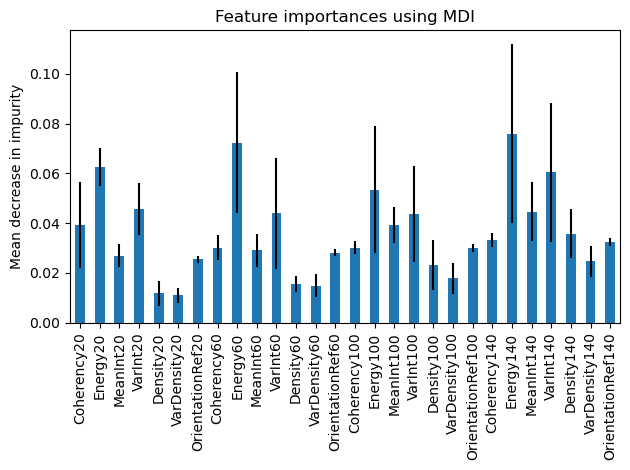

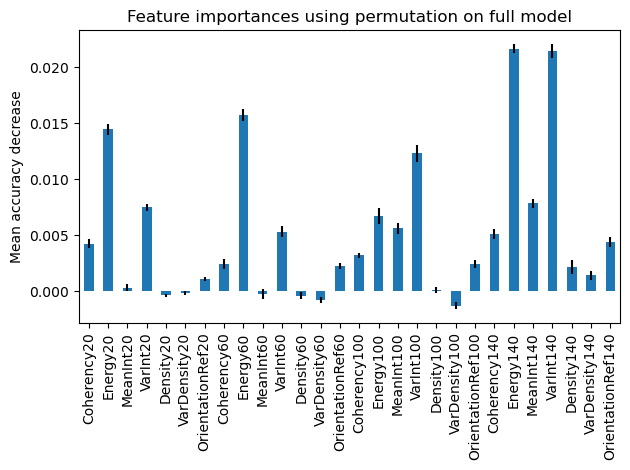

In [20]:
# RandomForest model (20, 20)
results_rf_plus = models.perform_random_forest(
    X_train=X_train,
    X_test=X_test,
    y_train=Y_train,
    y_test=Y_test,
    columns=x_columns,
    class_weight="balanced",
    scale=False
)
rf_plus = results_rf_plus["model"]

In [21]:
df_mdi = pd.DataFrame(
    {
        "mean": results_rf_plus["importance_mdi"]["mean"],
        "std": results_rf_plus["importance_mdi"]["std"]
    }, index=x_columns
)

df_mdi.to_csv("WT_CD3_t-plus_importance-mdi.csv")

df_permutation = pd.DataFrame(
    {
        "mean": results_rf_plus["importance_permutation"]["mean"],
        "std": results_rf_plus["importance_permutation"]["std"]
    }, index=x_columns
)

df_permutation.to_csv("WT_CD3_t-plus_importance-permutation.csv")

Best hyperparameters: {'n_estimators': 30, 'max_depth': 15}
Test Accuracy: 0.8053130793182268
Elapsed time to compute the importances: 0.008 seconds
Elapsed time to compute the importances: 39.378 seconds


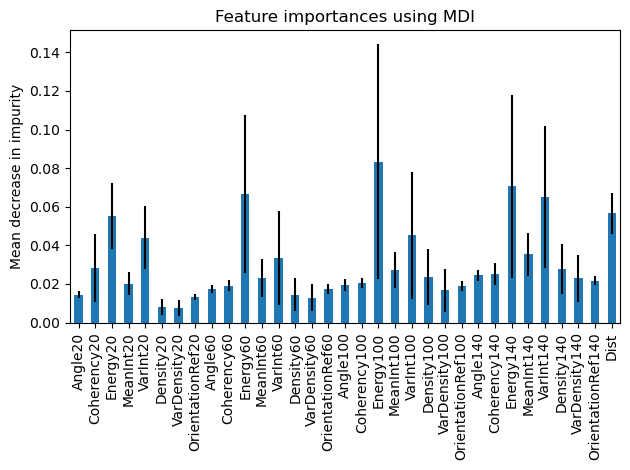

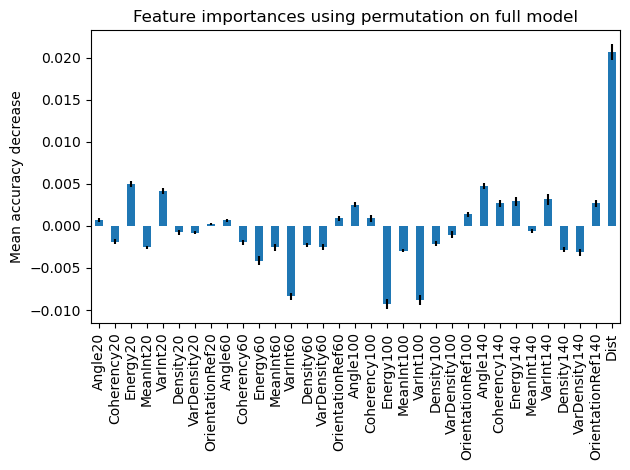

In [22]:
# RandomForest model with Dist & Angle columns (40, 20)
results_rf_dist_plus = models.perform_random_forest(
    X_train=X_dist_train,
    X_test=X_dist_test,
    y_train=Y_dist_train,
    y_test=Y_dist_test,
    columns=x_columns_dist,
    n_estimators=(10, 15, 20, 30),
    n_depths=(2, 4, 8, 10, 15),
    class_weight="balanced",
    scale=False
)
rf_dist_plus = results_rf_dist_plus["model"]

In [23]:
df_mdi = pd.DataFrame(
    {
        "mean": results_rf_dist_plus["importance_mdi"]["mean"],
        "std": results_rf_dist_plus["importance_mdi"]["std"]
    }, index=x_columns_dist
)

df_mdi.to_csv("WT_CD3_t-plus-dist_importance-mdi.csv")

df_permutation = pd.DataFrame(
    {
        "mean": results_rf_dist_plus["importance_permutation"]["mean"],
        "std": results_rf_dist_plus["importance_permutation"]["std"]
    }, index=x_columns_dist
)

df_permutation.to_csv("WT_CD3_t-plus-dist_importance-permutation.csv")

In [24]:
# Model Accuracy, how often is the classifier correct?
y_train_pred = rf_plus.predict(X_train)
y_test_pred = rf_plus.predict(X_test)
y_dist_train_pred = rf_dist_plus.predict(X_dist_train)
y_dist_test_pred = rf_dist_plus.predict(X_dist_test)

In [25]:
labels_class = pd.Series(rf_plus.classes_).map({0: 'not_plus', 1: 'plus'}).values

----- Random Forest -----
Accuracy Train: 0.9448905447308743
AUC Train: 0.9514010334231151

Accuracy Test: 0.8215924839365742
AUC Test: 0.726921930550529



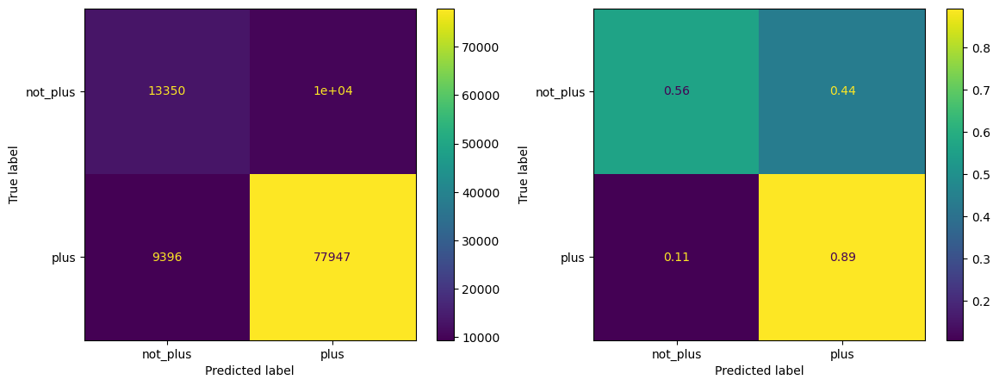

In [26]:
# Model Accuracy, how often is the classifier correct?
false_pos_rate_train, true_pos_rate_train, _ = roc_curve(Y_train, y_train_pred)
false_pos_rate_test, true_pos_rate_test, _ = roc_curve(Y_test, y_test_pred)

false_pos_rate_dist_train, true_pos_rate_dist_train, _ = roc_curve(Y_dist_train, y_dist_train_pred)
false_pos_rate_dist_test, true_pos_rate_dist_test, _ = roc_curve(Y_dist_test, y_dist_test_pred)

# Model Accuracy, how often is the classifier correct?
print("----- Random Forest -----")
print("Accuracy Train:", accuracy_score(Y_train, y_train_pred))
print("AUC Train:", auc(false_pos_rate_train, true_pos_rate_train))
print()
print("Accuracy Test:", accuracy_score(Y_test, y_test_pred))
print("AUC Test:", auc(false_pos_rate_test, true_pos_rate_test))
print()

fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(14, 5))
cm = confusion_matrix(Y_test, y_test_pred)
cm2 = confusion_matrix(Y_test, y_test_pred, normalize="true")
ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=labels_class).plot(ax=ax1)
ConfusionMatrixDisplay(confusion_matrix=cm2, display_labels=labels_class).plot(ax=ax2)
plt.show()

Random Forest, Angle avec Dist
Accuracy Train: 0.8791479613088351
AUC Train: 0.8895259088621105

Accuracy Test: 0.8053130793182268
AUC Test: 0.76709472922875


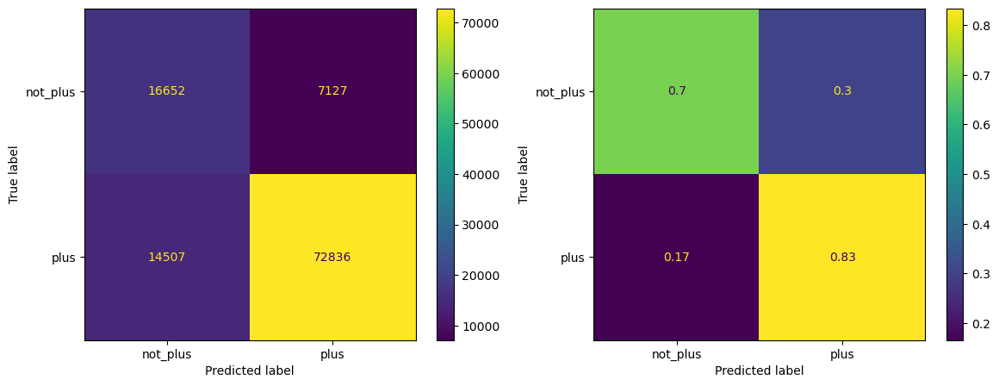

In [27]:
print("Random Forest, Angle avec Dist")
print("Accuracy Train:", accuracy_score(Y_dist_train, y_dist_train_pred))
print("AUC Train:", auc(false_pos_rate_dist_train, true_pos_rate_dist_train))
print()
print("Accuracy Test:", accuracy_score(Y_dist_test, y_dist_test_pred))
print("AUC Test:", auc(false_pos_rate_dist_test, true_pos_rate_dist_test))

fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(14, 5))
cm_dist = confusion_matrix(Y_dist_test, y_dist_test_pred)
cm2_dist = confusion_matrix(Y_dist_test, y_dist_test_pred, normalize="true")
ConfusionMatrixDisplay(confusion_matrix=cm_dist, display_labels=labels_class).plot(ax=ax1)
ConfusionMatrixDisplay(confusion_matrix=cm2_dist, display_labels=labels_class).plot(ax=ax2)
plt.show()

#### T plus & Density20 > 0

##### Jeu de données d'apprentissage et de validation (à densité20 > 0)

In [28]:
mask_cd3_density_in = data["Density20"] > 0

In [29]:
x_columns = [
    *constantes.float20_columns,
    *constantes.float60_columns,
    *constantes.float100_columns,
    *constantes.float140_columns
]
x_columns.remove("Angle20") ; x_columns.remove("Angle60") ; x_columns.remove("Angle100") ; x_columns.remove("Angle140")

# Features columns with Dist & Angle attributes
x_columns_dist = [
    *constantes.float20_columns,
    *constantes.float60_columns,
    *constantes.float100_columns,
    *constantes.float140_columns,
    *constantes.dist_columns
]

# Target column
y_column = "class_t_plus"

# Define X and Y dataframe
dt_XY = data[mask_cd3_density_in][[*x_columns_dist, y_column]].dropna()
X_density = dt_XY[x_columns].values  # X
X_density_dist = dt_XY[x_columns_dist].values  # X_dist
Y_density = dt_XY[y_column].values  # Y

# Train and Validation set
X_density_train, X_density_test, Y_density_train, Y_density_test = train_test_split(
    X_density, Y_density, test_size=0.3, random_state=42, stratify=Y_density
)

# Train and Validation set (with Angle & Dist)
X_density_dist_train, X_density_dist_test, Y_density_dist_train, Y_density_dist_test = train_test_split(
    X_density_dist, Y_density, test_size=0.3, random_state=42, stratify=Y_density
)

In [30]:
print(f"----- T plus (density20 > 0)-----")
print(f"{'Classe :':^45s}{'0':>6s}{'':2s}{'1':>6s}")
print(f"{'Comptage des classes au sein de Y:':45s}{sum(Y_density == 0):>6d}{'':2s}{sum(Y_density == 1):>6d}")
print(f"{'Comptage des classes au sein de Y_train:':45s}{sum(Y_density_train == 0):>6d}{'':2s}{sum(Y_density_train == 1):>6d}")
print(f"{'Comptage des classes au sein de Y_test:':45s}{sum(Y_density_test == 0):>6d}{'':2s}{sum(Y_density_test == 1):>6d}")
print(f"\nNombre d'observations totales : {Y_density.shape[0]:_}")

----- T plus (density20 > 0)-----
                  Classe :                        0       1
Comptage des classes au sein de Y:            79460  291680
Comptage des classes au sein de Y_train:      55622  204176
Comptage des classes au sein de Y_test:       23838   87504

Nombre d'observations totales : 371_140


#### Arbre de décision

In [31]:
max_depths_clf = [2, 4, 6, 8, 10, 15, 20]

# Best number of depth
results_density_t_plus = models.forest_depth_acc(
    X_density_train, Y_density_train,
    X_density_test, Y_density_test,
    depths=max_depths_clf, 
    classifier=DecisionTreeClassifier,
    class_weight="balanced",
)

# Best number of depth with Dist & Angle
results_density_dist_t_plus = models.forest_depth_acc(
    X_density_dist_train, Y_density_dist_train,
    X_density_dist_test, Y_density_dist_test,
    depths=max_depths_clf, 
    classifier=DecisionTreeClassifier,
    class_weight="balanced",
)

##### Performances en fonction de la profondeur

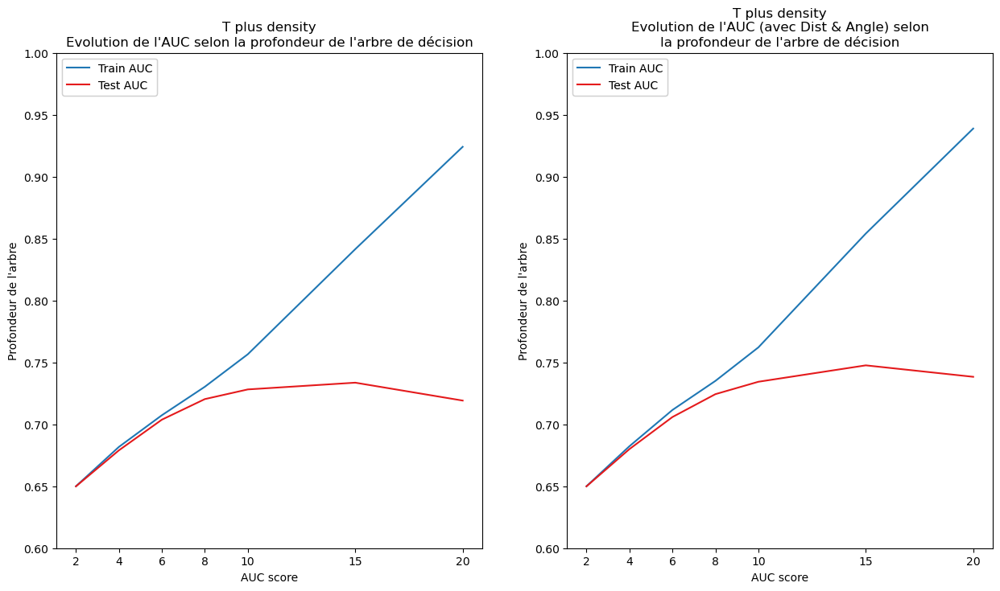

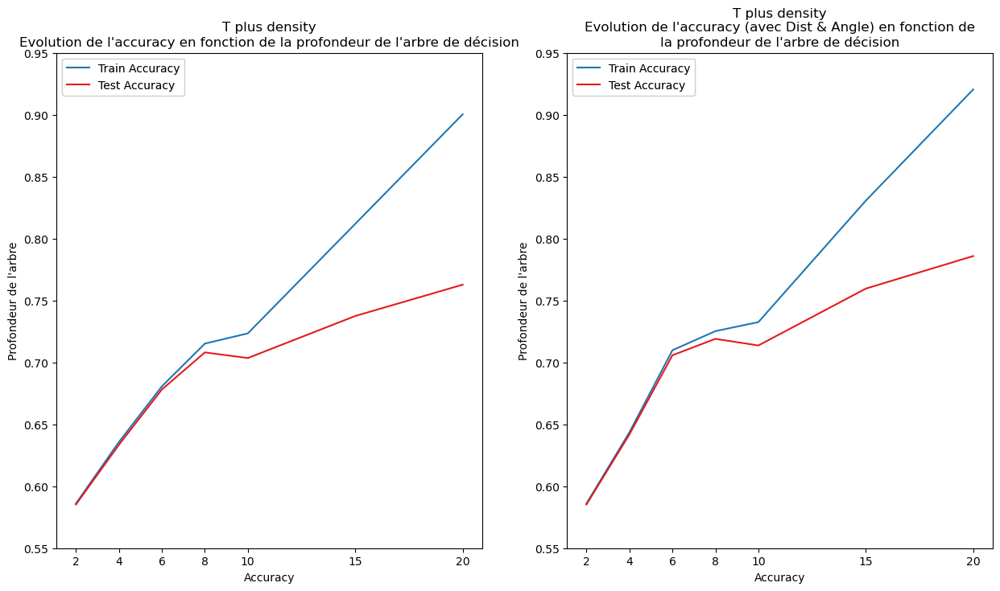

In [32]:
# Plot AUC
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(15, 8))
plots.plot(
    results_density_t_plus["auc_train"],
    results_density_t_plus["auc_test"],
    indices=results_density_t_plus["depths"],
    label=("Train AUC", "Test AUC"),
    title="T plus density\nEvolution de l'AUC selon la profondeur de l'arbre de décision",
    xlabel="AUC score", ylabel="Profondeur de l'arbre",
    xticks=results_density_t_plus["depths"], showR2=False, showY=False,
    ytop=1, ybottom=0.6, figure=(fig, ax1)
)

plots.plot(
    results_density_dist_t_plus["auc_train"],
    results_density_dist_t_plus["auc_test"],
    indices=results_density_dist_t_plus["depths"],
    label=("Train AUC", "Test AUC"),
    title="T plus density\nEvolution de l'AUC (avec Dist & Angle) selon\nla profondeur de l'arbre de décision",
    xlabel="AUC score", ylabel="Profondeur de l'arbre",
    xticks=results_density_dist_t_plus["depths"], showR2=False, showY=False,
    ytop=1, ybottom=0.6, figure=(fig, ax2)
)
plt.show()

# Plot accuracy
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(15, 8))

plots.plot(
    results_density_t_plus["acc_train"],
    results_density_t_plus["acc_test"],
    indices=results_density_t_plus["depths"],
    label=("Train Accuracy", "Test Accuracy"),
    title="T plus density\nEvolution de l'accuracy en fonction de la profondeur de l'arbre de décision",
    xlabel="Accuracy", ylabel="Profondeur de l'arbre",
    xticks=results_density_t_plus["depths"], showR2=False, showY=False,
    ytop=0.95, ybottom=0.55, figure=(fig, ax1)
)

plots.plot(
    results_density_dist_t_plus["acc_train"],
    results_density_dist_t_plus["acc_test"],
    indices=results_density_dist_t_plus["depths"],
    label=("Train Accuracy", "Test Accuracy"),
    title="T plus density\nEvolution de l'accuracy (avec Dist & Angle) en fonction de\nla profondeur de l'arbre de décision",
    xlabel="Accuracy", ylabel="Profondeur de l'arbre",
    xticks=results_density_dist_t_plus["depths"], showR2=False, showY=False,
    ytop=0.95, ybottom=0.55, figure=(fig, ax2)
)
plt.show()

In [33]:
print("----- Résumé des performances T plus (density20 > 0), arbre de décision -----")
print(f"{'Profondeur':<20s}:", end=" ") ; [print(f"{i:<4d}", end="  ") for i in results_density_t_plus["depths"]] ; print("\n")
print(f"{'AUC_train':<20s}:", end=" ") ; [print(f"{i:<.2f}", end="  ") for i in results_density_t_plus["auc_train"]] ; print()
print(f"{'AUC_test':<20s}:", end=" ") ; [print(f"{i:<.2f}", end="  ") for i in results_density_t_plus["auc_test"]] ; print("\n")

print(f"{'Accuracy_train':<20s}:", end=" ") ; [print(f"{i:<.2f}", end="  ") for i in results_density_t_plus["acc_train"]] ; print()
print(f"{'Accuracy_test':<20s}:", end=" ") ; [print(f"{i:<.2f}", end="  ") for i in results_density_t_plus["acc_test"]] ; print("\n")

print("---")
print(f"{'AUC_train_dist':<20s}:", end=" ") ; [print(f"{i:<.2f}", end="  ") for i in results_density_dist_t_plus["auc_train"]] ; print()
print(f"{'AUC_test_dist':<20s}:", end=" ") ; [print(f"{i:<.2f}", end="  ") for i in results_density_dist_t_plus["auc_test"]] ; print("\n")

print(f"{'Accuracy_train_dist':<20s}:", end=" ") ; [print(f"{i:<.2f}", end="  ") for i in results_density_dist_t_plus["acc_train"]] ; print()
print(f"{'Accuracy_test_dist':<20s}:", end=" ") ; [print(f"{i:<.2f}", end="  ") for i in results_density_dist_t_plus["acc_test"]] ; print()

----- Résumé des performances T plus (density20 > 0), arbre de décision -----
Profondeur          : 2     4     6     8     10    15    20    

AUC_train           : 0.65  0.68  0.71  0.73  0.76  0.84  0.92  
AUC_test            : 0.65  0.68  0.70  0.72  0.73  0.73  0.72  

Accuracy_train      : 0.59  0.64  0.68  0.72  0.72  0.81  0.90  
Accuracy_test       : 0.59  0.63  0.68  0.71  0.70  0.74  0.76  

---
AUC_train_dist      : 0.65  0.68  0.71  0.74  0.76  0.85  0.94  
AUC_test_dist       : 0.65  0.68  0.71  0.72  0.73  0.75  0.74  

Accuracy_train_dist : 0.59  0.64  0.71  0.73  0.73  0.83  0.92  
Accuracy_test_dist  : 0.59  0.64  0.71  0.72  0.71  0.76  0.79  


In [34]:
# Decision Tree (CART)
clf_density_plus = DecisionTreeClassifier(
    criterion="entropy",
    max_depth=10,
    random_state=42,
    class_weight="balanced",
)

clf_density_plus.fit(X_density_train, Y_density_train)
y_density_train_pred = clf_density_plus.predict(X_density_train)
y_density_test_pred = clf_density_plus.predict(X_density_test)

# Decision Tree (CART) with Dist column
clf_density_dist_plus = DecisionTreeClassifier(
    criterion="entropy",
    max_depth=10,
    random_state=42,
    class_weight="balanced",
)

clf_density_dist_plus.fit(X_density_dist_train, Y_density_dist_train)
y_density_dist_train_pred = clf_density_dist_plus.predict(X_density_dist_train)
y_density_dist_test_pred = clf_density_dist_plus.predict(X_density_dist_test)

# Performance
false_pos_rate_train, true_pos_rate_train, _ = roc_curve(Y_density_train, y_density_train_pred)
false_pos_rate_test, true_pos_rate_test, _ = roc_curve(Y_density_test, y_density_test_pred)

false_pos_rate_dist_train, true_pos_rate_dist_train, _ = roc_curve(Y_density_dist_train, y_density_dist_train_pred)
false_pos_rate_dist_test, true_pos_rate_dist_test, _ = roc_curve(Y_density_dist_test, y_density_dist_test_pred)

# Model Accuracy, how often is the classifier correct?
print("----- Arbre de décision (density20 > 0) -----")
print("Accuracy Train:", accuracy_score(Y_density_train, y_density_train_pred))
print("AUC Train:", auc(false_pos_rate_train, true_pos_rate_train))
print()
print("Accuracy Test:", accuracy_score(Y_density_test, y_density_test_pred))
print("AUC Test:", auc(false_pos_rate_test, true_pos_rate_test))
print()

----- Arbre de décision (density20 > 0) -----
Accuracy Train: 0.7142356754093565
AUC Train: 0.7542875524219168

Accuracy Test: 0.6971942303892511
AUC Test: 0.7296126928052524



In [35]:
labels_class = pd.Series(clf_density_plus.classes_).map({0: 'not_plus', 1: 'plus'}).values

----- Arbre de décision (density20 > 0) -----
Accuracy Train: 0.7142356754093565
AUC Train: 0.7542875524219168

Accuracy Test: 0.6971942303892511
AUC Test: 0.7296126928052524



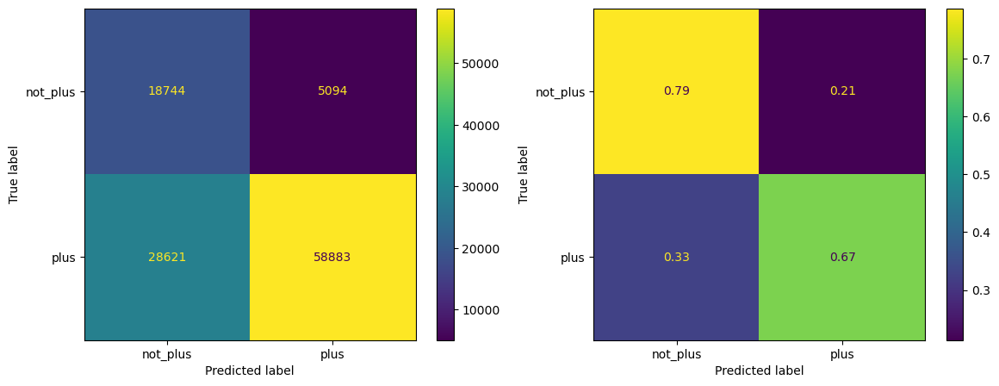

In [36]:
# Performance
false_pos_rate_train, true_pos_rate_train, _ = roc_curve(Y_density_train, y_density_train_pred)
false_pos_rate_test, true_pos_rate_test, _ = roc_curve(Y_density_test, y_density_test_pred)

false_pos_rate_dist_train, true_pos_rate_dist_train, _ = roc_curve(Y_density_dist_train, y_density_dist_train_pred)
false_pos_rate_dist_test, true_pos_rate_dist_test, _ = roc_curve(Y_density_dist_test, y_density_dist_test_pred)

# Model Accuracy, how often is the classifier correct?
print("----- Arbre de décision (density20 > 0) -----")
print("Accuracy Train:", accuracy_score(Y_density_train, y_density_train_pred))
print("AUC Train:", auc(false_pos_rate_train, true_pos_rate_train))
print()
print("Accuracy Test:", accuracy_score(Y_density_test, y_density_test_pred))
print("AUC Test:", auc(false_pos_rate_test, true_pos_rate_test))
print()

fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(14, 5))
cm = confusion_matrix(Y_density_test, y_density_test_pred)
cm2 = confusion_matrix(Y_density_test, y_density_test_pred, normalize="true")
ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=labels_class).plot(ax=ax1)
ConfusionMatrixDisplay(confusion_matrix=cm2, display_labels=labels_class).plot(ax=ax2)
plt.show()

Arbre de décision acc, Angle avec Dist
Accuracy Train: 0.736733924048684
AUC Train: 0.755199942689717

Accuracy Test: 0.7217132798045661
AUC Test: 0.7325759631880709


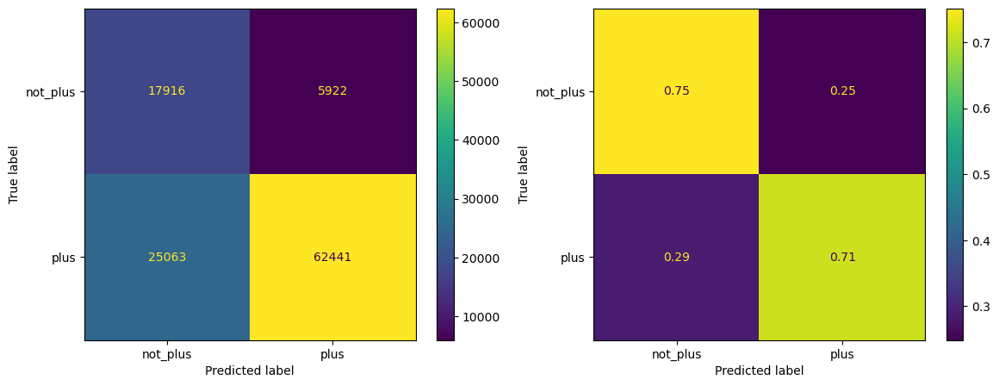

In [37]:
print("Arbre de décision acc, Angle avec Dist")
print("Accuracy Train:", accuracy_score(Y_density_dist_train, y_density_dist_train_pred))
print("AUC Train:", auc(false_pos_rate_dist_train, true_pos_rate_dist_train))
print()
print("Accuracy Test:", accuracy_score(Y_density_dist_test, y_density_dist_test_pred))
print("AUC Test:", auc(false_pos_rate_dist_test, true_pos_rate_dist_test))

fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(14, 5))
cm_dist = confusion_matrix(Y_density_dist_test, y_density_dist_test_pred)
cm2_dist = confusion_matrix(Y_density_dist_test, y_density_dist_test_pred, normalize="true")
ConfusionMatrixDisplay(confusion_matrix=cm_dist, display_labels=labels_class).plot(ax=ax1)
ConfusionMatrixDisplay(confusion_matrix=cm2_dist, display_labels=labels_class).plot(ax=ax2)
plt.show()

In [38]:
# Arbre de Décision
fig = plt.figure(figsize=(10, 30))
dot_data = tree.export_graphviz(
    clf_density_plus,
    feature_names=x_columns,
    class_names=labels_class,
    filled=True
)
graph = graphviz.Source(dot_data, format="png")
#graph.render("../out/WT_decision_tree_density_t-plus_dist")
graph

<Figure size 1000x3000 with 0 Axes>

In [39]:
# Arbre de décision avec l'ajout de Dist & Angle
fig = plt.figure(figsize=(10, 30))
dot_data = tree.export_graphviz(
    clf_density_dist_plus,
    feature_names=x_columns_dist,
    class_names=labels_class,
    filled=True
)

graph = graphviz.Source(dot_data, format="png")
#graph.render("../out/WT_decision_tree_density_t-plus_dist")
graph

<Figure size 1000x3000 with 0 Axes>

##### Random Forest

In [40]:
max_depths_rd = [2, 6, 10, 20, 25]
results_density_t_plus_rf = models.forest_depth_acc(
    X_density_train, Y_density_train,
    X_density_test, Y_density_test,
    depths=max_depths_rd, 
    classifier=RandomForestClassifier,
    n_estimators = 40,
    class_weight="balanced",
    n_jobs=-1
)

results_density_dist_t_plus_rf = models.forest_depth_acc(
    X_density_dist_train, Y_density_dist_train,
    X_density_dist_test, Y_density_dist_test,
    depths=max_depths_rd, 
    classifier=RandomForestClassifier,
    n_estimators = 20,
    class_weight="balanced",
    n_jobs=-1
)

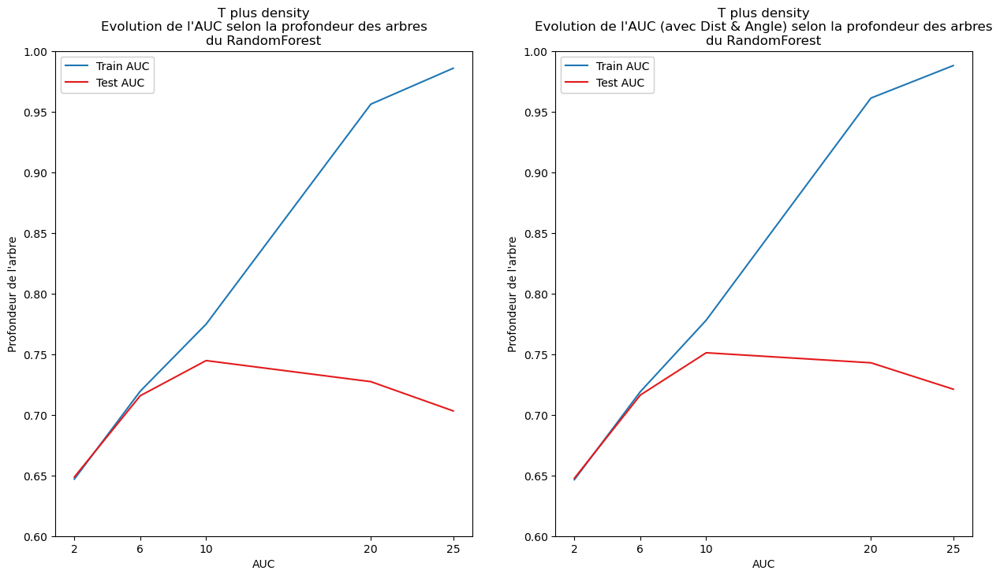

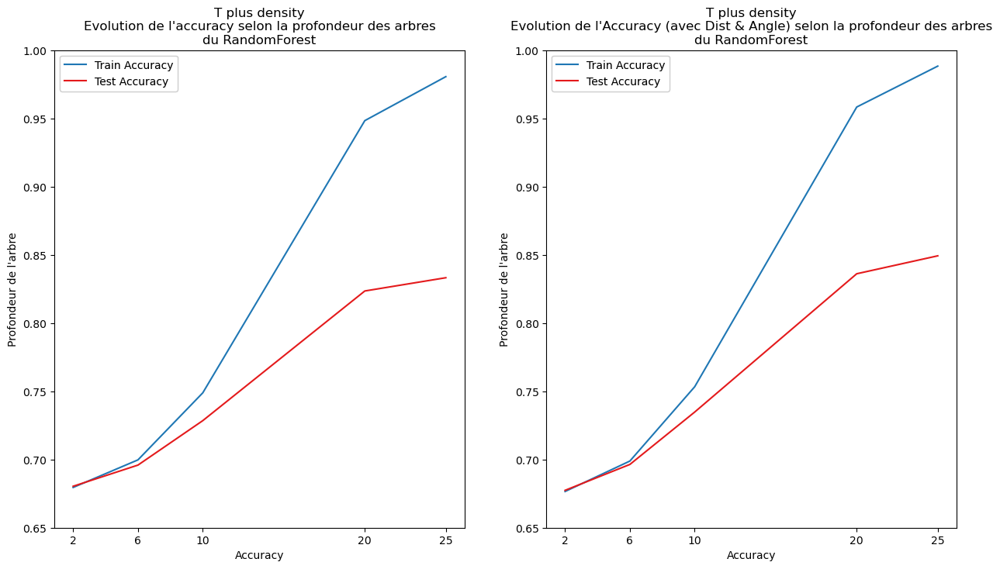

In [41]:
# Plot
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(15, 8))

plots.plot(
    results_density_t_plus_rf["auc_train"],
    results_density_t_plus_rf["auc_test"],
    indices=results_density_t_plus_rf["depths"],
    label=("Train AUC", "Test AUC"),
    title="T plus density\nEvolution de l'AUC selon la profondeur des arbres\ndu RandomForest",
    xlabel="AUC", ylabel="Profondeur de l'arbre",
    xticks=results_density_t_plus_rf["depths"], showR2=False, showY=False,
    ytop=1, ybottom=0.6, figure=(fig, ax1)
)

plots.plot(
    results_density_dist_t_plus_rf["auc_train"],
    results_density_dist_t_plus_rf["auc_test"],
    indices=results_density_dist_t_plus_rf["depths"],
    label=("Train AUC", "Test AUC"),
    title="T plus density\nEvolution de l'AUC (avec Dist & Angle) selon la profondeur des arbres\ndu RandomForest",
    xlabel="AUC", ylabel="Profondeur de l'arbre",
    xticks=results_density_dist_t_plus_rf["depths"], showR2=False, showY=False,
    ytop=1, ybottom=0.6, figure=(fig, ax2)
)

plt.show()

# Plot
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(15, 8))

plots.plot(
    results_density_t_plus_rf["acc_train"],
    results_density_t_plus_rf["acc_test"],
    indices=results_density_t_plus_rf["depths"],
    label=("Train Accuracy", "Test Accuracy"),
    title="T plus density\nEvolution de l'accuracy selon la profondeur des arbres\ndu RandomForest",
    xlabel="Accuracy", ylabel="Profondeur de l'arbre",
    xticks=results_density_t_plus_rf["depths"], showR2=False, showY=False,
    ytop=1, ybottom=0.65, figure=(fig, ax1)
)

plots.plot(
    results_density_dist_t_plus_rf["acc_train"],
    results_density_dist_t_plus_rf["acc_test"],
    indices=results_density_dist_t_plus_rf["depths"],
    label=("Train Accuracy", "Test Accuracy"),
    title="T plus density\nEvolution de l'Accuracy (avec Dist & Angle) selon la profondeur des arbres\ndu RandomForest",
    xlabel="Accuracy", ylabel="Profondeur de l'arbre",
    xticks=results_density_dist_t_plus_rf["depths"], showR2=False, showY=False,
    ytop=1, ybottom=0.65, figure=(fig, ax2)
)

plt.show()

In [42]:
print("----- Résumé des performances T plus (density20 > 0), Random Forest -----")
print(f"{'Profondeur':<20s}:", end=" ") ; [print(f"{i:<4d}", end="  ") for i in results_density_t_plus_rf["depths"]] ; print("\n")
print(f"{'AUC_train':<20s}:", end=" ") ; [print(f"{i:<.2f}", end="  ") for i in results_density_t_plus_rf["auc_train"]] ; print()
print(f"{'AUC_test':<20s}:", end=" ") ; [print(f"{i:<.2f}", end="  ") for i in results_density_t_plus_rf["auc_test"]] ; print("\n")

print(f"{'Accuracy_train':<20s}:", end=" ") ; [print(f"{i:<.2f}", end="  ") for i in results_density_t_plus_rf["acc_train"]] ; print()
print(f"{'Accuracy_test':<20s}:", end=" ") ; [print(f"{i:<.2f}", end="  ") for i in results_density_t_plus_rf["acc_test"]] ; print("\n")

print("---")

print(f"{'AUC_train_dist':<20s}:", end=" ") ; [print(f"{i:<.2f}", end="  ") for i in results_density_dist_t_plus_rf["auc_train"]] ; print()
print(f"{'AUC_test_dist':<20s}:", end=" ") ; [print(f"{i:<.2f}", end="  ") for i in results_density_dist_t_plus_rf["auc_test"]] ; print("\n")

print(f"{'Accuracy_train_dist':<20s}:", end=" ") ; [print(f"{i:<.2f}", end="  ") for i in results_density_dist_t_plus_rf["acc_train"]] ; print()
print(f"{'Accuracy_test_dist':<20s}:", end=" ") ; [print(f"{i:<.2f}", end="  ") for i in results_density_dist_t_plus_rf["acc_test"]] ; print()

----- Résumé des performances T plus (density20 > 0), Random Forest -----
Profondeur          : 2     6     10    20    25    

AUC_train           : 0.65  0.72  0.77  0.96  0.99  
AUC_test            : 0.65  0.72  0.74  0.73  0.70  

Accuracy_train      : 0.68  0.70  0.75  0.95  0.98  
Accuracy_test       : 0.68  0.70  0.73  0.82  0.83  

---
AUC_train_dist      : 0.65  0.72  0.78  0.96  0.99  
AUC_test_dist       : 0.65  0.72  0.75  0.74  0.72  

Accuracy_train_dist : 0.68  0.70  0.75  0.96  0.99  
Accuracy_test_dist  : 0.68  0.70  0.73  0.84  0.85  


Best hyperparameters: {'n_estimators': 20, 'max_depth': 15}
Test Accuracy: 0.7847802266889404
Elapsed time to compute the importances: 0.007 seconds
Elapsed time to compute the importances: 45.021 seconds


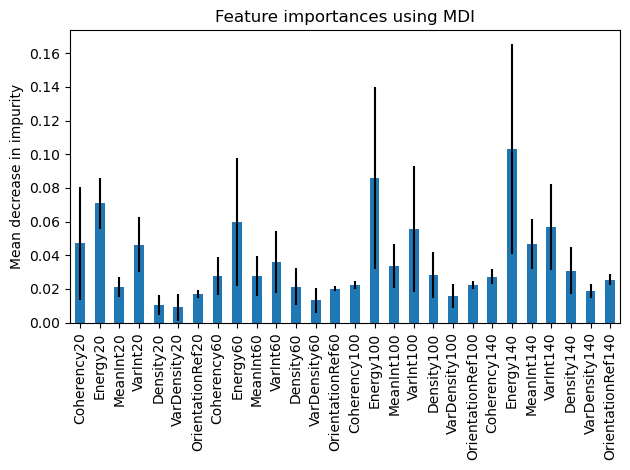

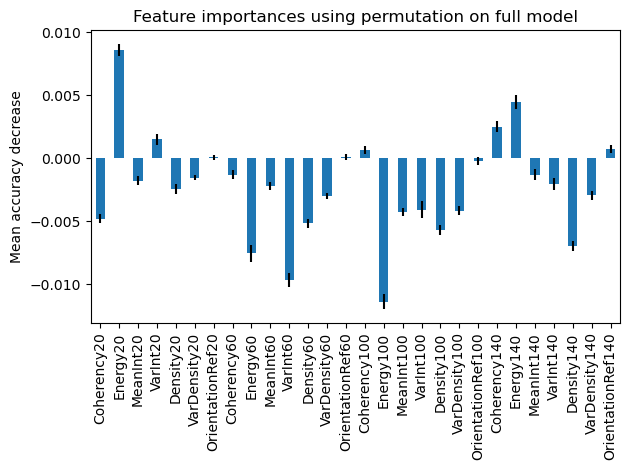

In [43]:
# Random forest (30, 20)
results_density_plus = models.perform_random_forest(
    X_train=X_density_train,
    X_test=X_density_test,
    y_train=Y_density_train,
    y_test=Y_density_test,
    columns=x_columns,
    n_estimators=(10, 15, 20, 30),
    n_depths=(2, 4, 8, 10, 15),
    class_weight="balanced",
    scale=False
)

rf_density_plus = results_density_plus["model"]

In [44]:
df_mdi = pd.DataFrame(
    {
        "mean": results_density_plus["importance_mdi"]["mean"],
        "std": results_density_plus["importance_mdi"]["std"]
    }, index=x_columns
)

df_mdi.to_csv("WT_CD3_t-plus_density_importance-mdi.csv")

df_permutation = pd.DataFrame(
    {
        "mean": results_density_plus["importance_permutation"]["mean"],
        "std": results_density_plus["importance_permutation"]["std"]
    }, index=x_columns
)

df_permutation.to_csv("WT_CD3_t-plus_density_importance-permutation.csv")

Best hyperparameters: {'n_estimators': 20, 'max_depth': 10}
Test Accuracy: 0.7333890176213828
Elapsed time to compute the importances: 0.012 seconds
Elapsed time to compute the importances: 16.536 seconds


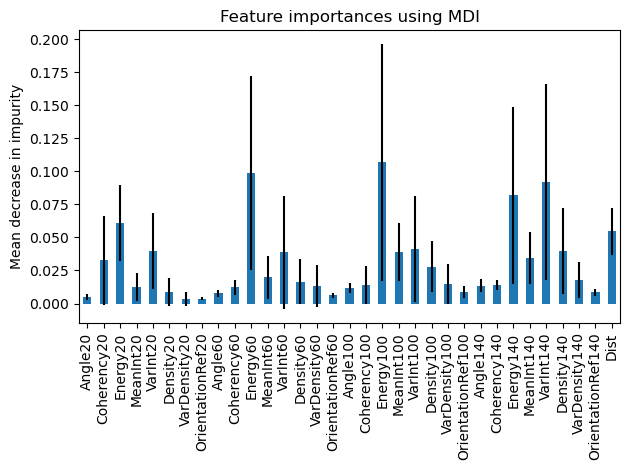

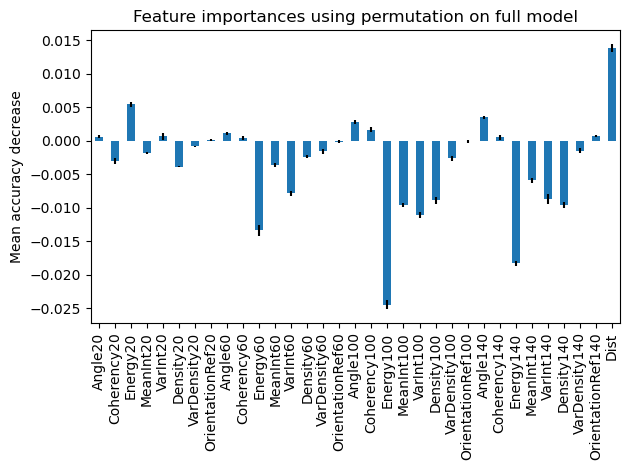

In [45]:
# Random forest with Dist & Angle (20, 25)
results_density_dist_plus = models.perform_random_forest(
    X_train=X_density_dist_train,
    X_test=X_density_dist_test,
    y_train=Y_density_dist_train,
    y_test=Y_density_dist_test,
    columns=x_columns_dist,
    n_estimators=(10, 15, 20, 30),
    n_depths=(2, 4, 8, 10, 15),
    class_weight="balanced",
    scale=False
)

rf_density_dist_plus = results_density_dist_plus["model"]

In [46]:
df_mdi = pd.DataFrame(
    {
        "mean": results_density_dist_plus["importance_mdi"]["mean"],
        "std": results_density_dist_plus["importance_mdi"]["std"]
    }, index=x_columns_dist
)

df_mdi.to_csv("WT_CD3_t-plus-dist_density_importance-mdi.csv")

df_permutation = pd.DataFrame(
    {
        "mean": results_density_dist_plus["importance_permutation"]["mean"],
        "std": results_density_dist_plus["importance_permutation"]["std"]
    }, index=x_columns_dist
)

df_permutation.to_csv("WT_CD3_t-plus-dist_density_importance-permutation.csv")

In [47]:
# Model Accuracy, how often is the classifier correct?
y_density_train_pred = rf_density_plus.predict(X_density_train)
y_density_test_pred = rf_density_plus.predict(X_density_test)
y_density_dist_train_pred = rf_density_dist_plus.predict(X_density_dist_train)
y_density_dist_test_pred = rf_density_dist_plus.predict(X_density_dist_test)

# Performance
# Model Accuracy, how often is the classifier correct?
false_pos_rate_train, true_pos_rate_train, _ = roc_curve(Y_density_train, y_density_train_pred)
false_pos_rate_test, true_pos_rate_test, _ = roc_curve(Y_density_test, y_density_test_pred)

false_pos_rate_dist_train, true_pos_rate_dist_train, _ = roc_curve(Y_density_dist_train, y_density_dist_train_pred)
false_pos_rate_dist_test, true_pos_rate_dist_test, _ = roc_curve(Y_density_dist_test, y_density_dist_test_pred)

In [48]:
labels_class = pd.Series(rf_density_plus.classes_).map({0: 'not_plus', 1: 'plus'}).values

In [144]:
labels_class

array(['not_enriched_2', 'enriched_2'], dtype=object)

----- Random Forest -----
Accuracy Train: 0.8607033156529303
AUC Train: 0.8693494391596296

Accuracy Test: 0.7847802266889404
AUC Test: 0.7479466804684591



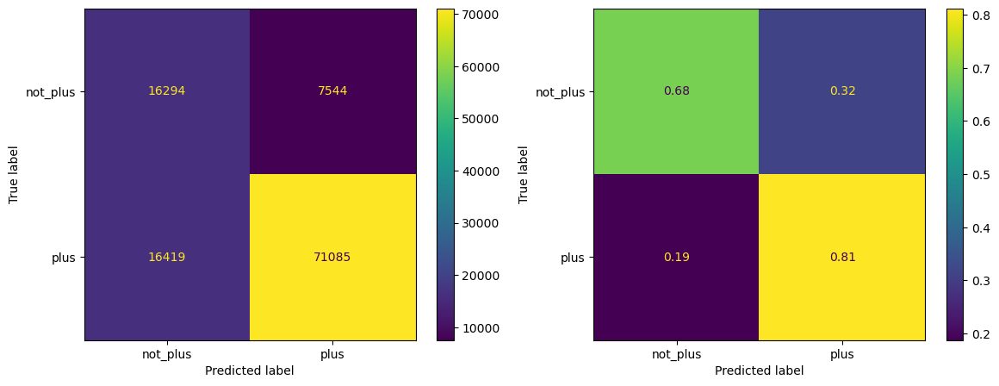

In [49]:
print("----- Random Forest -----")
print("Accuracy Train:", accuracy_score(Y_density_train, y_density_train_pred))
print("AUC Train:", auc(false_pos_rate_train, true_pos_rate_train))
print()
print("Accuracy Test:", accuracy_score(Y_density_test, y_density_test_pred))
print("AUC Test:", auc(false_pos_rate_test, true_pos_rate_test))
print()

fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(14, 5))
cm = confusion_matrix(Y_density_test, y_density_test_pred)
cm2 = confusion_matrix(Y_density_test, y_density_test_pred, normalize="true")
ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=labels_class).plot(ax=ax1)
ConfusionMatrixDisplay(confusion_matrix=cm2, display_labels=labels_class).plot(ax=ax2)
plt.show()

Random Forest, Angle avec Dist
Accuracy Train: 0.7524538295136991
AUC Train: 0.7793218011888609

Accuracy Test: 0.7333890176213828
AUC Test: 0.7514346012766646


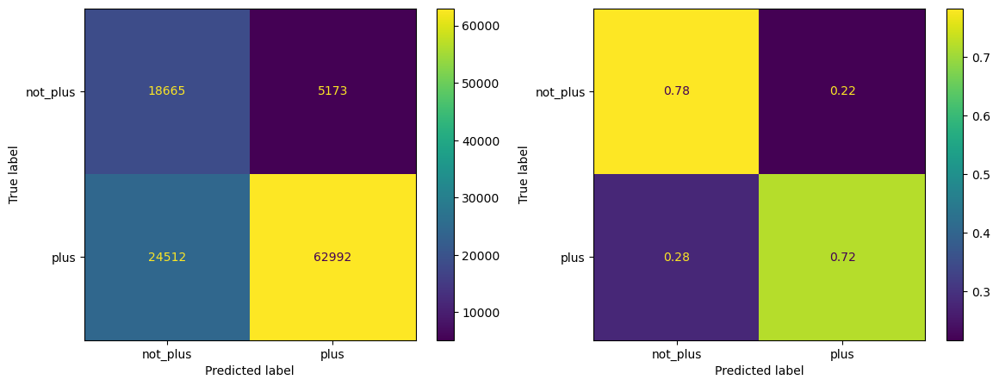

In [50]:
print("Random Forest, Angle avec Dist")
print("Accuracy Train:", accuracy_score(Y_density_dist_train, y_density_dist_train_pred))
print("AUC Train:", auc(false_pos_rate_dist_train, true_pos_rate_dist_train))
print()
print("Accuracy Test:", accuracy_score(Y_density_dist_test, y_density_dist_test_pred))
print("AUC Test:", auc(false_pos_rate_dist_test, true_pos_rate_dist_test))

fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(14, 5))
cm_dist = confusion_matrix(Y_density_dist_test, y_density_dist_test_pred)
cm2_dist = confusion_matrix(Y_density_dist_test, y_density_dist_test_pred, normalize="true")
ConfusionMatrixDisplay(confusion_matrix=cm_dist, display_labels=labels_class).plot(ax=ax1)
ConfusionMatrixDisplay(confusion_matrix=cm2_dist, display_labels=labels_class).plot(ax=ax2)
plt.show()

#### T enrichie

##### Arbre de décision

In [51]:
# Features columns
x_columns = [
    *constantes.float20_columns,
    *constantes.float60_columns,
    *constantes.float100_columns,
    *constantes.float140_columns
]
x_columns.remove("Angle20") ; x_columns.remove("Angle60") ; x_columns.remove("Angle100") ; x_columns.remove("Angle140")

# Features columns with Dist & Angle attributes
x_columns_dist = [
    *constantes.float20_columns,
    *constantes.float60_columns,
    *constantes.float100_columns,
    *constantes.float140_columns,
    *constantes.dist_columns
]

# Target column
y_column = "class_t_enriched"

# Define X and Y dataframe
X = data.dropna()[x_columns].values
X_dist = data.dropna()[x_columns_dist].values
Y = data.dropna()[y_column].values  # t plus class

# Train and Validation set
X_train, X_test, Y_train, Y_test = train_test_split(
    X, Y, test_size=0.3, random_state=42, stratify=Y
)

# Train and Validation set & (Angle & Dist) (to validate the model)
X_dist_train, X_dist_test, Y_dist_train, Y_dist_test = train_test_split(
    X_dist, Y, test_size=0.3, random_state=42, stratify=Y
)

In [52]:
print(f"----- T enrichie -----")
print(f"{'Classe :':^45s}{'0':>6s}{'':2s}{'1':>6s}")
print(f"{'Comptage des classes au sein de Y:':45s}{sum(Y == 0):>6d}{'':2s}{sum(Y == 1):>6d}")
print(f"{'Comptage des classes au sein de Y_train:':45s}{sum(Y_train == 0):>6d}{'':2s}{sum(Y_train == 1):>6d}")
print(f"{'Comptage des classes au sein de Y_test:':45s}{sum(Y_test == 0):>6d}{'':2s}{sum(Y_test == 1):>6d}")
print(f"\nNombre d'observations totales : {Y.shape[0]:_}")

----- T enrichie -----
                  Classe :                        0       1
Comptage des classes au sein de Y:           257455  112951
Comptage des classes au sein de Y_train:     180218   79066
Comptage des classes au sein de Y_test:       77237   33885

Nombre d'observations totales : 370_406


In [53]:
max_depths_clf = [2, 4, 6, 8, 10, 15, 20]

# Best number of depth
results_t_enriched = models.forest_depth_acc(
    X_train, Y_train, X_test, Y_test,
    depths=max_depths_clf, 
    classifier=DecisionTreeClassifier,
    class_weight="balanced"
)

# Best number of depth with Dist & Angle
results_dist_t_enriched = models.forest_depth_acc(
    X_dist_train, Y_dist_train, X_dist_test, Y_dist_test,
    depths=max_depths_clf, 
    classifier=DecisionTreeClassifier,
    class_weight="balanced"
)

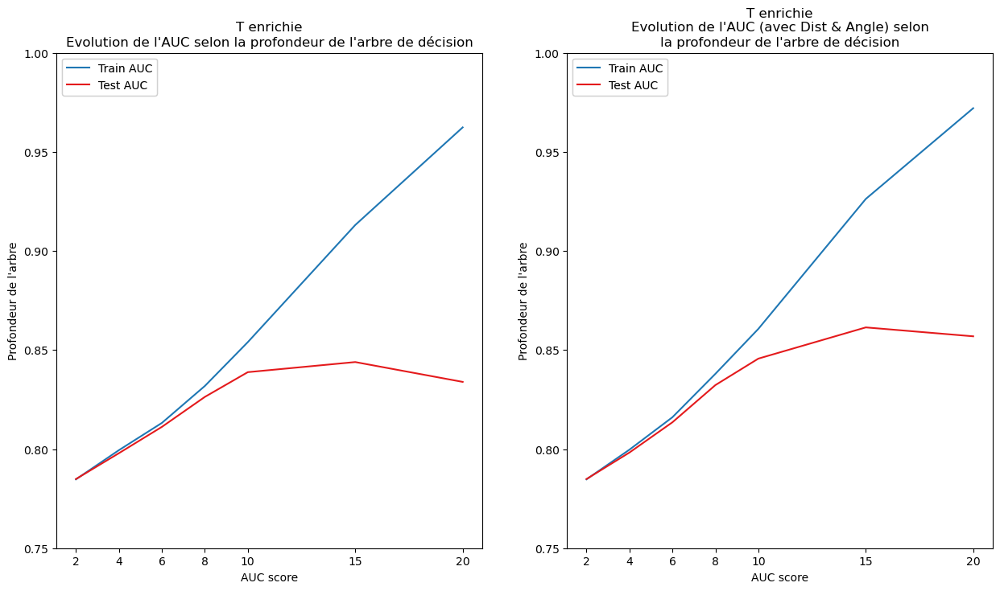

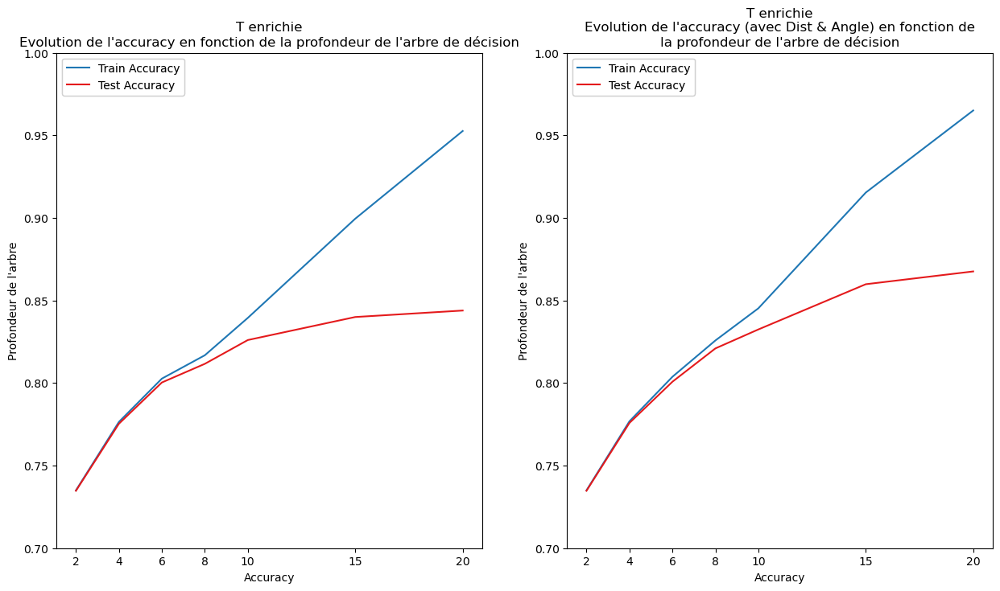

In [54]:
# Plot
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(15, 8))
plots.plot(
    results_t_enriched["auc_train"],
    results_t_enriched["auc_test"],
    indices=max_depths_clf,
    label=("Train AUC", "Test AUC"),
    title="T enrichie\nEvolution de l'AUC selon la profondeur de l'arbre de décision",
    xlabel="AUC score", ylabel="Profondeur de l'arbre",
    xticks=max_depths_clf, showR2=False, showY=False,
    ytop=1, ybottom=0.75, figure=(fig, ax1)
)

plots.plot(
    results_dist_t_enriched["auc_train"],
    results_dist_t_enriched["auc_test"],
    indices=max_depths_clf,
    label=("Train AUC", "Test AUC"),
    title="T enrichie\nEvolution de l'AUC (avec Dist & Angle) selon\nla profondeur de l'arbre de décision",
    xlabel="AUC score", ylabel="Profondeur de l'arbre",
    xticks=max_depths_clf, showR2=False, showY=False,
    ytop=1, ybottom=0.75, figure=(fig, ax2)
)
plt.show()

# Plot
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(15, 8))

plots.plot(
    results_t_enriched["acc_train"],
    results_t_enriched["acc_test"],
    indices=max_depths_clf,
    label=("Train Accuracy", "Test Accuracy"),
    title="T enrichie\nEvolution de l'accuracy en fonction de la profondeur de l'arbre de décision",
    xlabel="Accuracy", ylabel="Profondeur de l'arbre",
    xticks=max_depths_clf, showR2=False, showY=False,
    ytop=1, ybottom=0.7, figure=(fig, ax1)
)

plots.plot(
    results_dist_t_enriched["acc_train"],
    results_dist_t_enriched["acc_test"],
    indices=max_depths_clf,
    label=("Train Accuracy", "Test Accuracy"),
    title="T enrichie\nEvolution de l'accuracy (avec Dist & Angle) en fonction de\nla profondeur de l'arbre de décision",
    xlabel="Accuracy", ylabel="Profondeur de l'arbre",
    xticks=max_depths_clf, showR2=False, showY=False,
    ytop=1, ybottom=0.7, figure=(fig, ax2)
)

plt.show()

In [55]:
print("----- Résumé des performances T enrichie, arbre de décision -----")
print(f"{'Profondeur':<20s}:", end=" ") ; [print(f"{i:<4d}", end="  ") for i in results_t_enriched["depths"]] ; print("\n")
print(f"{'AUC_train':<20s}:", end=" ") ; [print(f"{i:<.2f}", end="  ") for i in results_t_enriched["auc_train"]] ; print()
print(f"{'AUC_test':<20s}:", end=" ") ; [print(f"{i:<.2f}", end="  ") for i in results_t_enriched["auc_test"]] ; print("\n")

print(f"{'Accuracy_train':<20s}:", end=" ") ; [print(f"{i:<.2f}", end="  ") for i in results_t_enriched["acc_train"]] ; print()
print(f"{'Accuracy_test':<20s}:", end=" ") ; [print(f"{i:<.2f}", end="  ") for i in results_t_enriched["acc_test"]] ; print("\n")

print("---")
print(f"{'AUC_train_dist':<20s}:", end=" ") ; [print(f"{i:<.2f}", end="  ") for i in results_dist_t_enriched["auc_train"]] ; print()
print(f"{'AUC_test_dist':<20s}:", end=" ") ; [print(f"{i:<.2f}", end="  ") for i in results_dist_t_enriched["auc_test"]] ; print("\n")

print(f"{'Accuracy_train_dist':<20s}:", end=" ") ; [print(f"{i:<.2f}", end="  ") for i in results_dist_t_enriched["acc_train"]] ; print()
print(f"{'Accuracy_test_dist':<20s}:", end=" ") ; [print(f"{i:<.2f}", end="  ") for i in results_dist_t_enriched["acc_test"]] ; print()

----- Résumé des performances T enrichie, arbre de décision -----
Profondeur          : 2     4     6     8     10    15    20    

AUC_train           : 0.78  0.80  0.81  0.83  0.85  0.91  0.96  
AUC_test            : 0.78  0.80  0.81  0.83  0.84  0.84  0.83  

Accuracy_train      : 0.73  0.78  0.80  0.82  0.84  0.90  0.95  
Accuracy_test       : 0.73  0.78  0.80  0.81  0.83  0.84  0.84  

---
AUC_train_dist      : 0.78  0.80  0.82  0.84  0.86  0.93  0.97  
AUC_test_dist       : 0.78  0.80  0.81  0.83  0.85  0.86  0.86  

Accuracy_train_dist : 0.73  0.78  0.80  0.83  0.85  0.92  0.97  
Accuracy_test_dist  : 0.73  0.78  0.80  0.82  0.83  0.86  0.87  


In [56]:
# Decision Tree (CART)
clf_enriched = DecisionTreeClassifier(
    criterion="entropy",
    max_depth=10,
    random_state=42,
    class_weight="balanced"
)

clf_enriched.fit(X_train, Y_train)
y_train_pred = clf_enriched.predict(X_train)
y_test_pred = clf_enriched.predict(X_test)

# Decision Tree (CART) with Dist column
clf_dist_enriched = DecisionTreeClassifier(
    criterion="entropy",
    max_depth=10,
    random_state=42,
    class_weight="balanced"
)

clf_dist_enriched.fit(X_dist_train, Y_dist_train)
y_dist_train_pred = clf_dist_enriched.predict(X_dist_train)
y_dist_test_pred = clf_dist_enriched.predict(X_dist_test)
clf_dist_enriched

DecisionTreeClassifier(class_weight='balanced', criterion='entropy',
                       max_depth=10, random_state=42)

In [57]:
false_pos_rate_train, true_pos_rate_train, _ = roc_curve(Y_train, y_train_pred)
false_pos_rate_test, true_pos_rate_test, _ = roc_curve(Y_test, y_test_pred)

false_pos_rate_dist_train, true_pos_rate_dist_train, _ = roc_curve(Y_dist_train, y_dist_train_pred)
false_pos_rate_dist_test, true_pos_rate_dist_test, _ = roc_curve(Y_dist_test, y_dist_test_pred)

In [58]:
labels_class = pd.Series(clf_enriched.classes_).map({0: 'not_enriched', 1: 'enriched'}).values

----- Arbre de décision -----
Accuracy Train: 0.8322727202604094
AUC Train: 0.8459717691092523

Accuracy Test: 0.8226093842803405
AUC Test: 0.8352222051484739



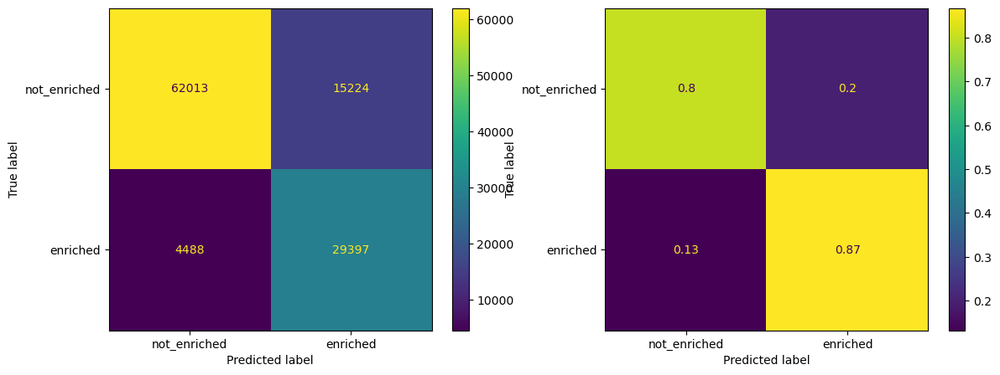

In [59]:
print("----- Arbre de décision -----")
print("Accuracy Train:", accuracy_score(Y_train, y_train_pred))
print("AUC Train:", auc(false_pos_rate_train, true_pos_rate_train))
print()
print("Accuracy Test:", accuracy_score(Y_test, y_test_pred))
print("AUC Test:", auc(false_pos_rate_test, true_pos_rate_test))
print()

fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(14, 5))
cm = confusion_matrix(Y_test, y_test_pred)
cm2 = confusion_matrix(Y_test, y_test_pred, normalize="true")
ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=labels_class).plot(ax=ax1)
ConfusionMatrixDisplay(confusion_matrix=cm2, display_labels=labels_class).plot(ax=ax2)
plt.show()

Arbre de décision, Angle avec Dist
Accuracy Train: 0.8456518720784931
AUC Train: 0.8539634939221608

Accuracy Test: 0.8350641637119562
AUC Test: 0.8422021934182337


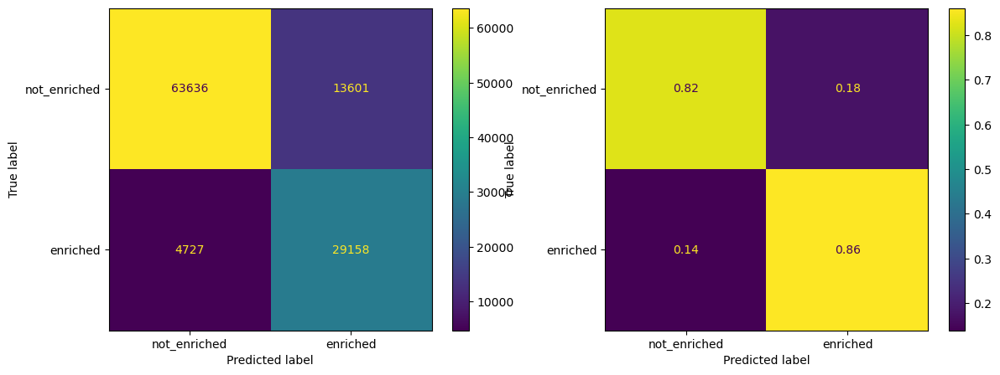

In [60]:
print("Arbre de décision, Angle avec Dist")
print("Accuracy Train:", accuracy_score(Y_dist_train, y_dist_train_pred))
print("AUC Train:", auc(false_pos_rate_dist_train, true_pos_rate_dist_train))
print()
print("Accuracy Test:", accuracy_score(Y_dist_test, y_dist_test_pred))
print("AUC Test:", auc(false_pos_rate_dist_test, true_pos_rate_dist_test))

fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(14, 5))
cm_dist = confusion_matrix(Y_dist_test, y_dist_test_pred)
cm2_dist = confusion_matrix(Y_dist_test, y_dist_test_pred, normalize="true")
ConfusionMatrixDisplay(confusion_matrix=cm_dist, display_labels=labels_class).plot(ax=ax1)
ConfusionMatrixDisplay(confusion_matrix=cm2_dist, display_labels=labels_class).plot(ax=ax2)
plt.show()

In [61]:
# Arbre de Décision
fig = plt.figure(figsize=(10, 30))
dot_data = tree.export_graphviz(
    clf_enriched,
    feature_names=x_columns,
    class_names=labels_class,
    filled=True
)
graph = graphviz.Source(dot_data, format="png")
#graph.render("../out/WT_decision_tree_t-enriched")
graph

<Figure size 1000x3000 with 0 Axes>

In [62]:
# Arbre de décision avec l'ajout de Dist & Angle
fig = plt.figure(figsize=(10, 30))
dot_data = tree.export_graphviz(
    clf_dist_enriched,
    feature_names=x_columns_dist,
    class_names=labels_class,
    filled=True
)
graph = graphviz.Source(dot_data, format="png")
#graph.render("../out/WT_decision_tree_t-enriched_dist")
graph

<Figure size 1000x3000 with 0 Axes>

##### Random Forest


In [63]:
max_depths_rd = [2, 4, 6, 8, 10, 15, 20]
results_t_enriched_rf = models.forest_depth_acc(
    X_train, Y_train, X_test, Y_test,
    depths=max_depths_rd, 
    classifier=RandomForestClassifier,
    n_estimators = 100,
    class_weight="balanced",
    n_jobs=-1
)

results_dist_t_enriched_rf = models.forest_depth_acc(
    X_dist_train, Y_dist_train, X_dist_test, Y_dist_test,
    depths=max_depths_rd, 
    classifier=RandomForestClassifier,
    n_estimators = 100,
    class_weight="balanced",
    n_jobs=-1
)

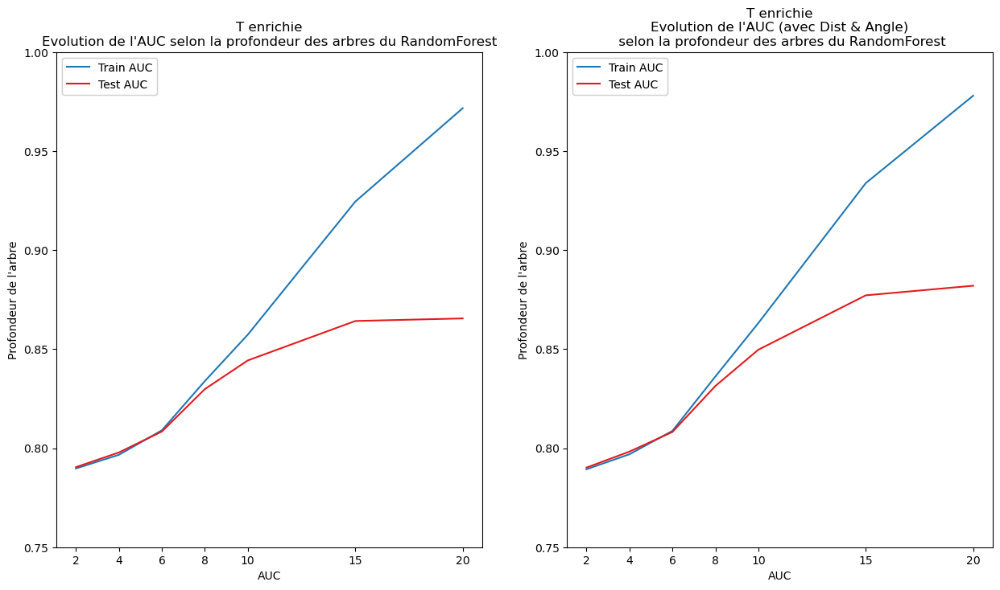

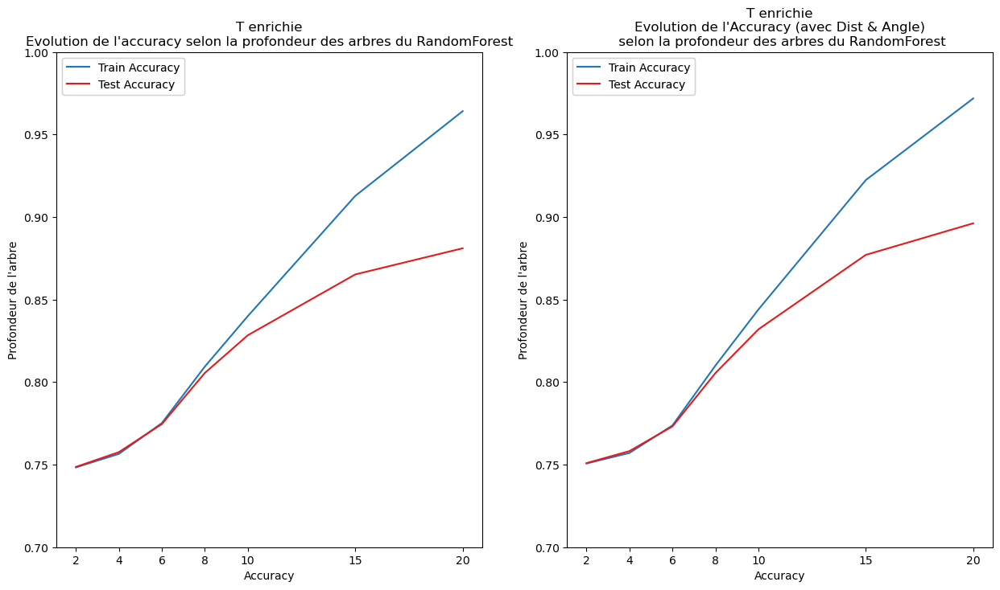

In [64]:
# Plot
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(15, 8))

plots.plot(
    results_t_enriched_rf["auc_train"],
    results_t_enriched_rf["auc_test"],
    indices=max_depths_rd,
    label=("Train AUC", "Test AUC"),
    title="T enrichie\nEvolution de l'AUC selon la profondeur des arbres du RandomForest",
    xlabel="AUC", ylabel="Profondeur de l'arbre",
    xticks=max_depths_rd, showR2=False, showY=False,
    ytop=1, ybottom=0.75, figure=(fig, ax1)
)

plots.plot(
    results_dist_t_enriched_rf["auc_train"],
    results_dist_t_enriched_rf["auc_test"],
    indices=max_depths_rd,
    label=("Train AUC", "Test AUC"),
    title="T enrichie\nEvolution de l'AUC (avec Dist & Angle)\n selon la profondeur des arbres du RandomForest",
    xlabel="AUC", ylabel="Profondeur de l'arbre",
    xticks=max_depths_rd, showR2=False, showY=False,
    ytop=1, ybottom=0.75, figure=(fig, ax2)
)

plt.show()

# Plot
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(15, 8))

plots.plot(
    results_t_enriched_rf["acc_train"],
    results_t_enriched_rf["acc_test"],
    indices=max_depths_clf,
    label=("Train Accuracy", "Test Accuracy"),
    title="T enrichie\nEvolution de l'accuracy selon la profondeur des arbres du RandomForest",
    xlabel="Accuracy", ylabel="Profondeur de l'arbre",
    xticks=max_depths_rd, showR2=False, showY=False,
    ytop=1, ybottom=0.7, figure=(fig, ax1)
)

plots.plot(
    results_dist_t_enriched_rf["acc_train"],
    results_dist_t_enriched_rf["acc_test"],
    indices=max_depths_rd,
    label=("Train Accuracy", "Test Accuracy"),
    title="T enrichie\nEvolution de l'Accuracy (avec Dist & Angle)\n selon la profondeur des arbres du RandomForest",
    xlabel="Accuracy", ylabel="Profondeur de l'arbre",
    xticks=max_depths_rd, showR2=False, showY=False,
    ytop=1, ybottom=0.7, figure=(fig, ax2)
)

plt.show()

In [65]:
print("----- Résumé des performances T enrichie, arbre de décision -----")
print(f"{'Profondeur':<20s}:", end=" ") ; [print(f"{i:<4d}", end="  ") for i in results_t_enriched_rf["depths"]] ; print("\n")
print(f"{'AUC_train':<20s}:", end=" ") ; [print(f"{i:<.2f}", end="  ") for i in results_t_enriched_rf["auc_train"]] ; print()
print(f"{'AUC_test':<20s}:", end=" ") ; [print(f"{i:<.2f}", end="  ") for i in results_t_enriched_rf["auc_test"]] ; print("\n")

print(f"{'Accuracy_train':<20s}:", end=" ") ; [print(f"{i:<.2f}", end="  ") for i in results_t_enriched_rf["acc_train"]] ; print()
print(f"{'Accuracy_test':<20s}:", end=" ") ; [print(f"{i:<.2f}", end="  ") for i in results_t_enriched_rf["acc_test"]] ; print("\n")

print("---")
print(f"{'AUC_train_dist':<20s}:", end=" ") ; [print(f"{i:<.2f}", end="  ") for i in results_dist_t_enriched_rf["auc_train"]] ; print()
print(f"{'AUC_test_dist':<20s}:", end=" ") ; [print(f"{i:<.2f}", end="  ") for i in results_dist_t_enriched_rf["auc_test"]] ; print("\n")

print(f"{'Accuracy_train_dist':<20s}:", end=" ") ; [print(f"{i:<.2f}", end="  ") for i in results_dist_t_enriched_rf["acc_train"]] ; print()
print(f"{'Accuracy_test_dist':<20s}:", end=" ") ; [print(f"{i:<.2f}", end="  ") for i in results_dist_t_enriched_rf["acc_test"]] ; print()

----- Résumé des performances T enrichie, arbre de décision -----
Profondeur          : 2     4     6     8     10    15    20    

AUC_train           : 0.79  0.80  0.81  0.83  0.86  0.92  0.97  
AUC_test            : 0.79  0.80  0.81  0.83  0.84  0.86  0.87  

Accuracy_train      : 0.75  0.76  0.78  0.81  0.84  0.91  0.96  
Accuracy_test       : 0.75  0.76  0.77  0.81  0.83  0.87  0.88  

---
AUC_train_dist      : 0.79  0.80  0.81  0.84  0.86  0.93  0.98  
AUC_test_dist       : 0.79  0.80  0.81  0.83  0.85  0.88  0.88  

Accuracy_train_dist : 0.75  0.76  0.77  0.81  0.84  0.92  0.97  
Accuracy_test_dist  : 0.75  0.76  0.77  0.81  0.83  0.88  0.90  


Best hyperparameters: {'n_estimators': 30, 'max_depth': 10}
Test Accuracy: 0.8281618401396663
Elapsed time to compute the importances: 0.004 seconds
Elapsed time to compute the importances: 33.832 seconds


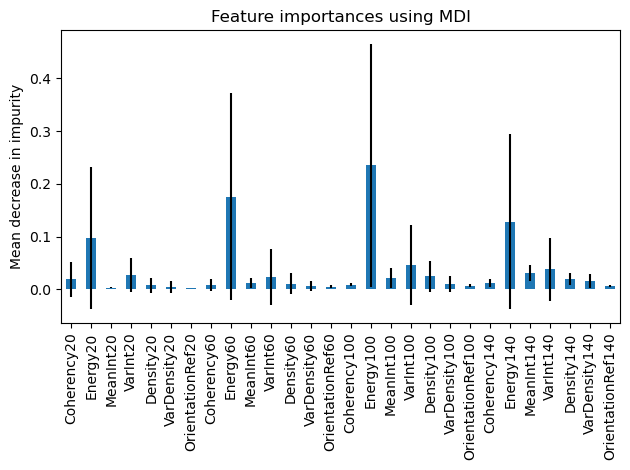

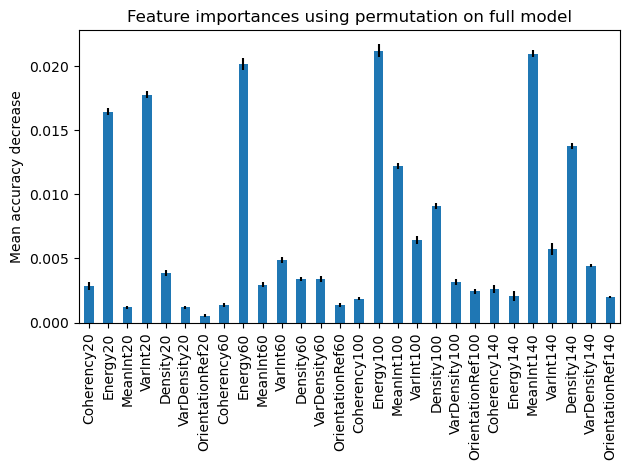

In [66]:
# RandomForest model
results_enriched = models.perform_random_forest(
    X_train=X_train,
    X_test=X_test,
    y_train=Y_train,
    y_test=Y_test,
    columns=x_columns,
    n_estimators=(10, 15, 20, 30),
    n_depths=(2, 4, 8, 10, 15),
    class_weight="balanced",
    scale=False
)

rf_enriched = results_enriched["model"]

In [67]:
df_mdi = pd.DataFrame(
    {
        "mean": results_enriched["importance_mdi"]["mean"],
        "std": results_enriched["importance_mdi"]["std"]
    }, index=x_columns
)

df_mdi.to_csv("WT_CD3_enriched_importance-mdi.csv")

df_permutation = pd.DataFrame(
    {
        "mean": results_enriched["importance_permutation"]["mean"],
        "std": results_enriched["importance_permutation"]["std"]
    }, index=x_columns
)

df_permutation.to_csv("WT_CD3_enriched_importance-permutation.csv")

Best hyperparameters: {'n_estimators': 20, 'max_depth': 8}
Test Accuracy: 0.8058980219938446
Elapsed time to compute the importances: 0.001 seconds
Elapsed time to compute the importances: 13.985 seconds


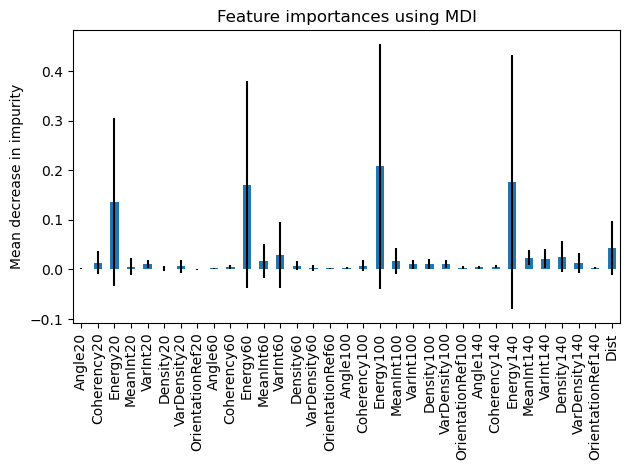

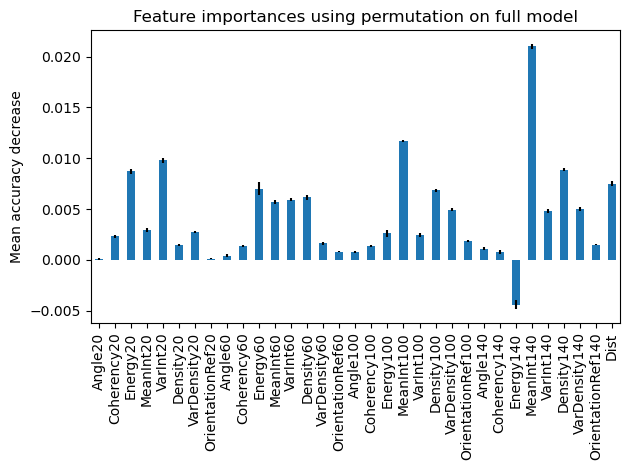

In [68]:
# RandomForest model with Dist & Angle columns
results_dist_enriched = models.perform_random_forest(
    X_train=X_dist_train,
    X_test=X_dist_test,
    y_train=Y_dist_train,
    y_test=Y_dist_test,
    columns=x_columns_dist,
    n_estimators=(10, 15, 20, 30),
    n_depths=(2, 4, 8, 10, 15),
    class_weight="balanced",
    scale=False
)

rf_dist_enriched = results_dist_enriched["model"]

In [69]:
df_mdi = pd.DataFrame(
    {
        "mean": results_dist_enriched["importance_mdi"]["mean"],
        "std": results_dist_enriched["importance_mdi"]["std"]
    }, index=x_columns_dist
)

df_mdi.to_csv("WT_CD3_enriched-dist_importance-mdi.csv")

df_permutation = pd.DataFrame(
    {
        "mean": results_dist_enriched["importance_permutation"]["mean"],
        "std": results_dist_enriched["importance_permutation"]["std"]
    }, index=x_columns_dist
)

df_permutation.to_csv("WT_CD3_enriched-dist_importance-permutation.csv")

In [70]:
# Model Accuracy, how often is the classifier correct?
y_train_pred = rf_enriched.predict(X_train)
y_test_pred = rf_enriched.predict(X_test)
y_dist_train_pred = rf_dist_enriched.predict(X_dist_train)
y_dist_test_pred = rf_dist_enriched.predict(X_dist_test)

In [71]:
false_pos_rate_train, true_pos_rate_train, _ = roc_curve(Y_train, y_train_pred)
false_pos_rate_test, true_pos_rate_test, _ = roc_curve(Y_test, y_test_pred)

false_pos_rate_dist_train, true_pos_rate_dist_train, _ = roc_curve(Y_dist_train, y_dist_train_pred)
false_pos_rate_dist_test, true_pos_rate_dist_test, _ = roc_curve(Y_dist_test, y_dist_test_pred)

In [72]:
labels_class = pd.Series(rf_enriched.classes_).map({0: 'not_enriched', 1: 'enriched'}).values

----- Random Forest -----
Accuracy Train: 0.8387212477437868
AUC Train: 0.8557714420291533

Accuracy Test: 0.8281618401396663
AUC Test: 0.8439869579717505



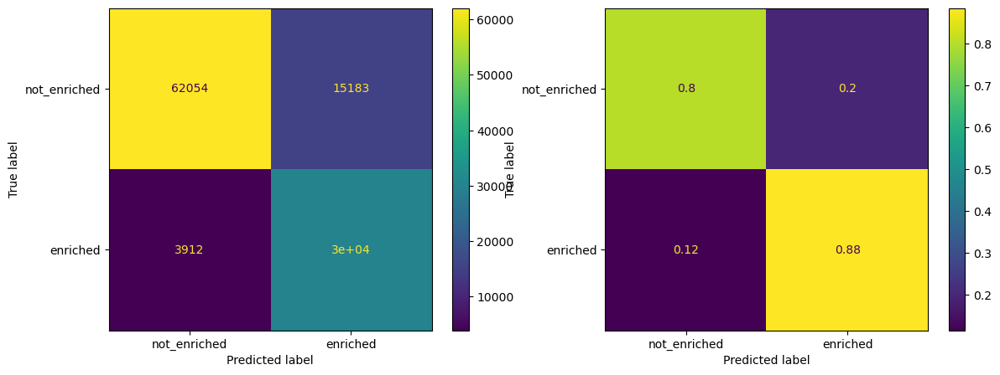

In [73]:
print("----- Random Forest -----")
print("Accuracy Train:", accuracy_score(Y_train, y_train_pred))
print("AUC Train:", auc(false_pos_rate_train, true_pos_rate_train))
print()
print("Accuracy Test:", accuracy_score(Y_test, y_test_pred))
print("AUC Test:", auc(false_pos_rate_test, true_pos_rate_test))
print()

fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(14, 5))
cm = confusion_matrix(Y_test, y_test_pred)
cm2 = confusion_matrix(Y_test, y_test_pred, normalize="true")
ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=labels_class).plot(ax=ax1)
ConfusionMatrixDisplay(confusion_matrix=cm2, display_labels=labels_class).plot(ax=ax2)
plt.show()

Random Forest, Angle avec Dist
Accuracy Train: 0.8103006741642369
AUC Train: 0.8362389575282625

Accuracy Test: 0.8058980219938446
AUC Test: 0.8318722388664045


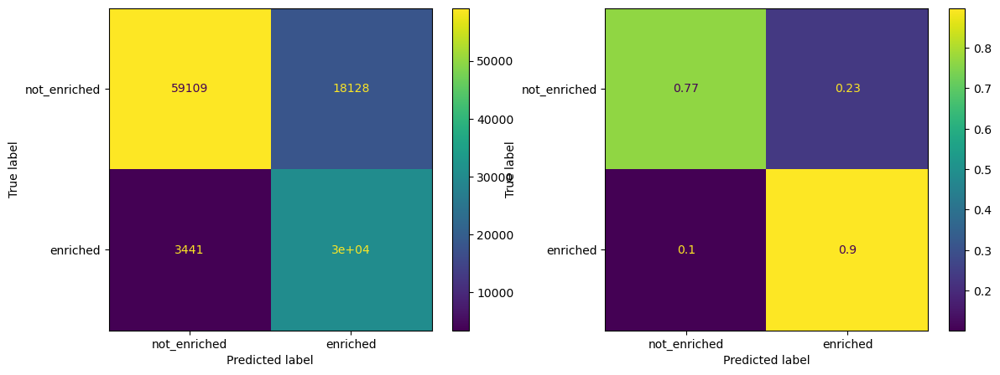

In [74]:
print("Random Forest, Angle avec Dist")
print("Accuracy Train:", accuracy_score(Y_dist_train, y_dist_train_pred))
print("AUC Train:", auc(false_pos_rate_dist_train, true_pos_rate_dist_train))
print()
print("Accuracy Test:", accuracy_score(Y_dist_test, y_dist_test_pred))
print("AUC Test:", auc(false_pos_rate_dist_test, true_pos_rate_dist_test))

fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(14, 5))
cm_dist = confusion_matrix(Y_dist_test, y_dist_test_pred)
cm2_dist = confusion_matrix(Y_dist_test, y_dist_test_pred, normalize="true")
ConfusionMatrixDisplay(confusion_matrix=cm_dist, display_labels=labels_class).plot(ax=ax1)
ConfusionMatrixDisplay(confusion_matrix=cm2_dist, display_labels=labels_class).plot(ax=ax2)
plt.show()

#### T enrichie & Density20 > 0

##### Jeu de données d'apprentissage et de validation (à densité20 > 0)

In [75]:
# Features columns
x_columns = [
    *constantes.float20_columns,
    *constantes.float60_columns,
    *constantes.float100_columns,
    *constantes.float140_columns
]
x_columns.remove("Angle20") ; x_columns.remove("Angle60") ; x_columns.remove("Angle100") ; x_columns.remove("Angle140")

# Features columns with Dist & Angle attributes
x_columns_dist = [
    *constantes.float20_columns,
    *constantes.float60_columns,
    *constantes.float100_columns,
    *constantes.float140_columns,
    *constantes.dist_columns
]

# Target column
y_column = "class_t_enriched"

# Define X and Y dataframe
dt_XY = data[mask_cd3_density_in][[*x_columns_dist, y_column]].dropna()
X_density = dt_XY[x_columns].values  # X
X_density_dist = dt_XY[x_columns_dist].values  # X_dist
Y_density = dt_XY[y_column].values  # Y

# Train and Validation set
X_density_train, X_density_test, Y_density_train, Y_density_test = train_test_split(
    X_density, Y_density, test_size=0.3, random_state=42, stratify=Y_density
)

# Train and Validation set (with Angle & Dist)
X_density_dist_train, X_density_dist_test, Y_density_dist_train, Y_density_dist_test = train_test_split(
    X_density_dist, Y_density, test_size=0.3, random_state=42, stratify=Y_density
)

In [76]:
print(f"----- T enrichie (density20 > 0)-----")
print(f"{'Classe :':^45s}{'0':>6s}{'':2s}{'1':>6s}")
print(f"{'Comptage des classes au sein de Y:':45s}{sum(Y_density == 0):>6d}{'':2s}{sum(Y_density == 1):>6d}")
print(f"{'Comptage des classes au sein de Y_train:':45s}{sum(Y_density_train == 0):>6d}{'':2s}{sum(Y_density_train == 1):>6d}")
print(f"{'Comptage des classes au sein de Y_test:':45s}{sum(Y_density_test == 0):>6d}{'':2s}{sum(Y_density_test == 1):>6d}")
print(f"\nNombre d'observations totales : {Y_density.shape[0]:_}")

----- T enrichie (density20 > 0)-----
                  Classe :                        0       1
Comptage des classes au sein de Y:           258104  113036
Comptage des classes au sein de Y_train:     180673   79125
Comptage des classes au sein de Y_test:       77431   33911

Nombre d'observations totales : 371_140


#### Arbre de décision

In [77]:
max_depths_clf = [2, 4, 6, 8, 10, 15, 20]

# Best number of depth
results_density_t_enriched = models.forest_depth_acc(
    X_density_train, Y_density_train,
    X_density_test, Y_density_test,
    depths=max_depths_clf, 
    classifier=DecisionTreeClassifier,
    class_weight="balanced",
)

# Best number of depth with Dist & Angle
results_density_dist_t_enriched = models.forest_depth_acc(
    X_density_dist_train, Y_density_dist_train,
    X_density_dist_test, Y_density_dist_test,
    depths=max_depths_clf, 
    classifier=DecisionTreeClassifier,
    class_weight="balanced",
)

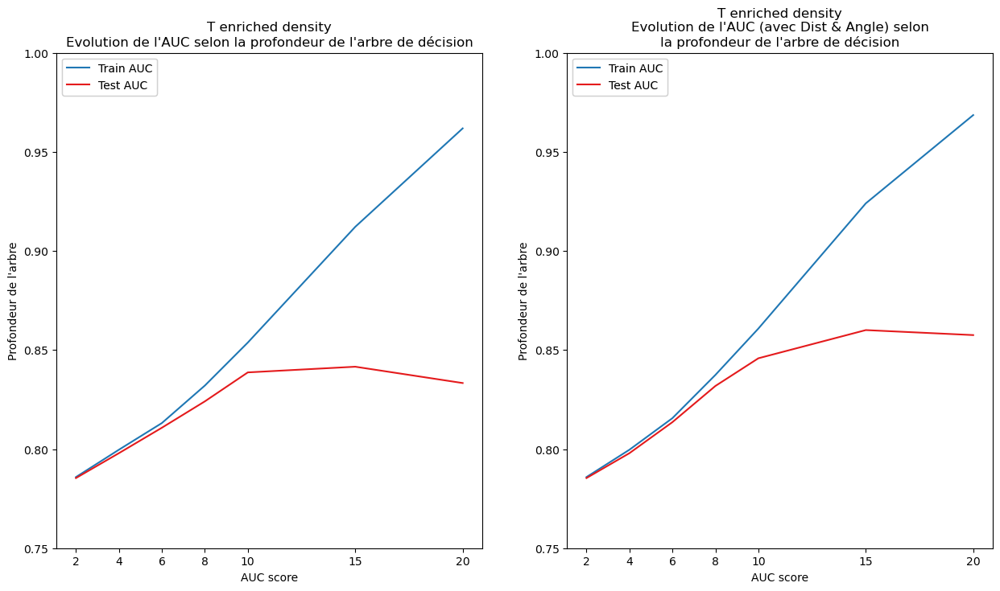

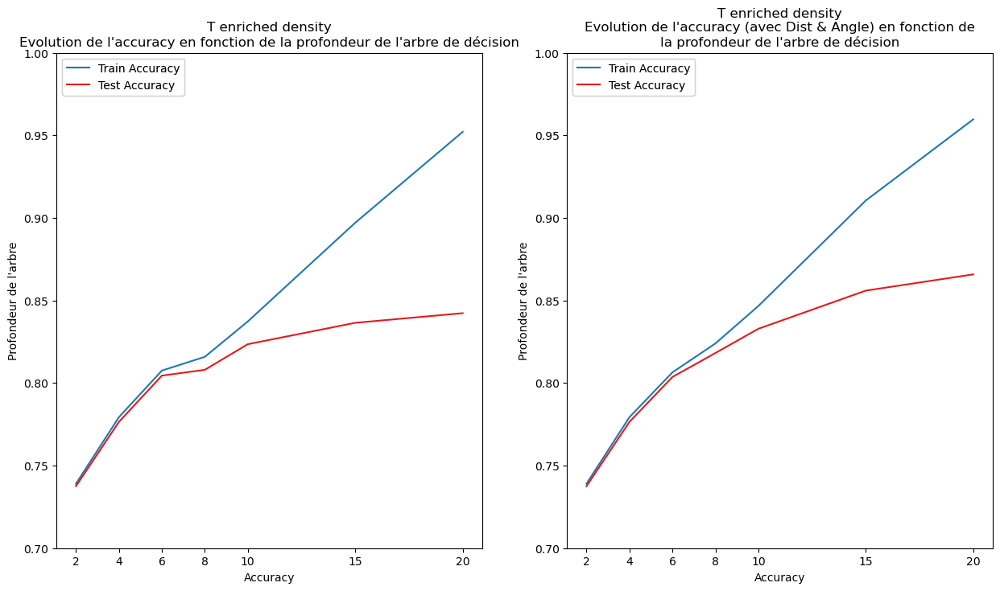

In [78]:
# Plot AUC
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(15, 8))
plots.plot(
    results_density_t_enriched["auc_train"],
    results_density_t_enriched["auc_test"],
    indices=max_depths_clf,
    label=("Train AUC", "Test AUC"),
    title="T enriched density\nEvolution de l'AUC selon la profondeur de l'arbre de décision",
    xlabel="AUC score", ylabel="Profondeur de l'arbre",
    xticks=max_depths_clf, showR2=False, showY=False,
    ytop=1, ybottom=0.75, figure=(fig, ax1)
)

plots.plot(
    results_density_dist_t_enriched["auc_train"],
    results_density_dist_t_enriched["auc_test"],
    indices=max_depths_clf,
    label=("Train AUC", "Test AUC"),
    title="T enriched density\nEvolution de l'AUC (avec Dist & Angle) selon\nla profondeur de l'arbre de décision",
    xlabel="AUC score", ylabel="Profondeur de l'arbre",
    xticks=max_depths_clf, showR2=False, showY=False,
    ytop=1, ybottom=0.75, figure=(fig, ax2)
)
plt.show()

# Plot accuracy
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(15, 8))

plots.plot(
    results_density_t_enriched["acc_train"],
    results_density_t_enriched["acc_test"],
    indices=max_depths_clf,
    label=("Train Accuracy", "Test Accuracy"),
    title="T enriched density\nEvolution de l'accuracy en fonction de la profondeur de l'arbre de décision",
    xlabel="Accuracy", ylabel="Profondeur de l'arbre",
    xticks=max_depths_clf, showR2=False, showY=False,
    ytop=1, ybottom=0.7, figure=(fig, ax1)
)

plots.plot(
    results_density_dist_t_enriched["acc_train"],
    results_density_dist_t_enriched["acc_test"],
    indices=max_depths_clf,
    label=("Train Accuracy", "Test Accuracy"),
    title="T enriched density\nEvolution de l'accuracy (avec Dist & Angle) en fonction de\nla profondeur de l'arbre de décision",
    xlabel="Accuracy", ylabel="Profondeur de l'arbre",
    xticks=max_depths_clf, showR2=False, showY=False,
    ytop=1, ybottom=0.7, figure=(fig, ax2)
)
plt.show()

In [79]:
print("----- Résumé des performances T plus (density20 > 0), arbre de décision -----")
print(f"{'Profondeur':<20s}:", end=" ") ; [print(f"{i:<4d}", end="  ") for i in results_density_t_enriched["depths"]] ; print("\n")
print(f"{'AUC_train':<20s}:", end=" ") ; [print(f"{i:<.2f}", end="  ") for i in results_density_t_enriched["auc_train"]] ; print()
print(f"{'AUC_test':<20s}:", end=" ") ; [print(f"{i:<.2f}", end="  ") for i in results_density_t_enriched["auc_test"]] ; print("\n")

print(f"{'Accuracy_train':<20s}:", end=" ") ; [print(f"{i:<.2f}", end="  ") for i in results_density_t_enriched["acc_train"]] ; print()
print(f"{'Accuracy_test':<20s}:", end=" ") ; [print(f"{i:<.2f}", end="  ") for i in results_density_t_enriched["acc_test"]] ; print("\n")

print("---")
print(f"{'AUC_train_dist':<20s}:", end=" ") ; [print(f"{i:<.2f}", end="  ") for i in results_density_dist_t_enriched["auc_train"]] ; print()
print(f"{'AUC_test_dist':<20s}:", end=" ") ; [print(f"{i:<.2f}", end="  ") for i in results_density_dist_t_enriched["auc_test"]] ; print("\n")

print(f"{'Accuracy_train_dist':<20s}:", end=" ") ; [print(f"{i:<.2f}", end="  ") for i in results_density_dist_t_enriched["acc_train"]] ; print()
print(f"{'Accuracy_test_dist':<20s}:", end=" ") ; [print(f"{i:<.2f}", end="  ") for i in results_density_dist_t_enriched["acc_test"]] ; print()

----- Résumé des performances T plus (density20 > 0), arbre de décision -----
Profondeur          : 2     4     6     8     10    15    20    

AUC_train           : 0.79  0.80  0.81  0.83  0.85  0.91  0.96  
AUC_test            : 0.79  0.80  0.81  0.82  0.84  0.84  0.83  

Accuracy_train      : 0.74  0.78  0.81  0.82  0.84  0.90  0.95  
Accuracy_test       : 0.74  0.78  0.80  0.81  0.82  0.84  0.84  

---
AUC_train_dist      : 0.79  0.80  0.82  0.84  0.86  0.92  0.97  
AUC_test_dist       : 0.79  0.80  0.81  0.83  0.85  0.86  0.86  

Accuracy_train_dist : 0.74  0.78  0.81  0.82  0.85  0.91  0.96  
Accuracy_test_dist  : 0.74  0.78  0.80  0.82  0.83  0.86  0.87  


In [80]:
# Decision Tree (CART)
clf_density_enriched = DecisionTreeClassifier(
    criterion="entropy",
    max_depth=10,
    random_state=42,
    class_weight="balanced",
)

clf_density_enriched.fit(X_density_train, Y_density_train)
y_density_train_pred = clf_density_enriched.predict(X_density_train)
y_density_test_pred = clf_density_enriched.predict(X_density_test)

# Decision Tree (CART) with Dist column
clf_density_dist_enriched = DecisionTreeClassifier(
    criterion="entropy",
    max_depth=10,
    random_state=42,
    class_weight="balanced",
)

clf_density_dist_enriched.fit(X_density_dist_train, Y_density_dist_train)
y_density_dist_train_pred = clf_density_dist_enriched.predict(X_density_dist_train)
y_density_dist_test_pred = clf_density_dist_enriched.predict(X_density_dist_test)

# Performance
false_pos_rate_train, true_pos_rate_train, _ = roc_curve(Y_density_train, y_density_train_pred)
false_pos_rate_test, true_pos_rate_test, _ = roc_curve(Y_density_test, y_density_test_pred)

false_pos_rate_dist_train, true_pos_rate_dist_train, _ = roc_curve(Y_density_dist_train, y_density_dist_train_pred)
false_pos_rate_dist_test, true_pos_rate_dist_test, _ = roc_curve(Y_density_dist_test, y_density_dist_test_pred)

In [81]:
labels_class = pd.Series(clf_density_enriched.classes_).map({0: 'not_enriched', 1: 'enriched'}).values

----- Arbre de décision (density20 > 0) -----
Accuracy Train: 0.839967975119131
AUC Train: 0.8478794733494635

Accuracy Test: 0.8274056510571033
AUC Test: 0.8343324119600039



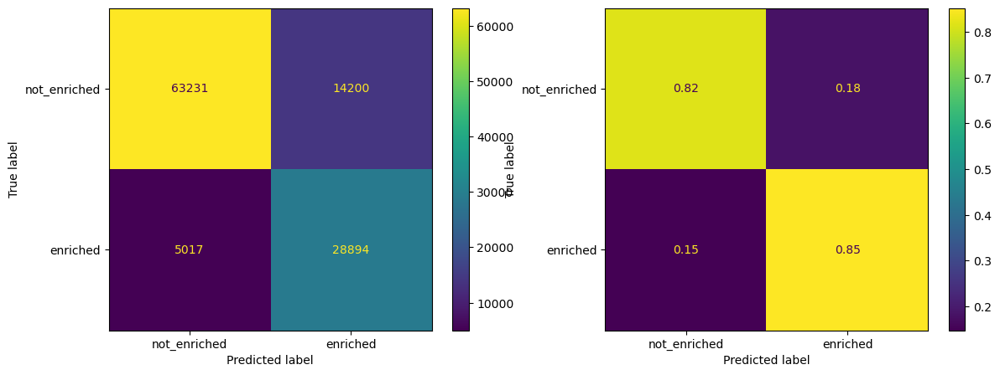

In [82]:
# Model Accuracy, how often is the classifier correct?
print("----- Arbre de décision (density20 > 0) -----")
print("Accuracy Train:", accuracy_score(Y_density_train, y_density_train_pred))
print("AUC Train:", auc(false_pos_rate_train, true_pos_rate_train))
print()
print("Accuracy Test:", accuracy_score(Y_density_test, y_density_test_pred))
print("AUC Test:", auc(false_pos_rate_test, true_pos_rate_test))
print()

fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(14, 5))
cm = confusion_matrix(Y_density_test, y_density_test_pred)
cm2 = confusion_matrix(Y_density_test, y_density_test_pred, normalize="true")
ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=labels_class).plot(ax=ax1)
ConfusionMatrixDisplay(confusion_matrix=cm2, display_labels=labels_class).plot(ax=ax2)
plt.show()

Arbre de décision acc, Angle avec Dist
Accuracy Train: 0.8299640489919091
AUC Train: 0.8499781281342081

Accuracy Test: 0.8196906827612221
AUC Test: 0.8390118393035664


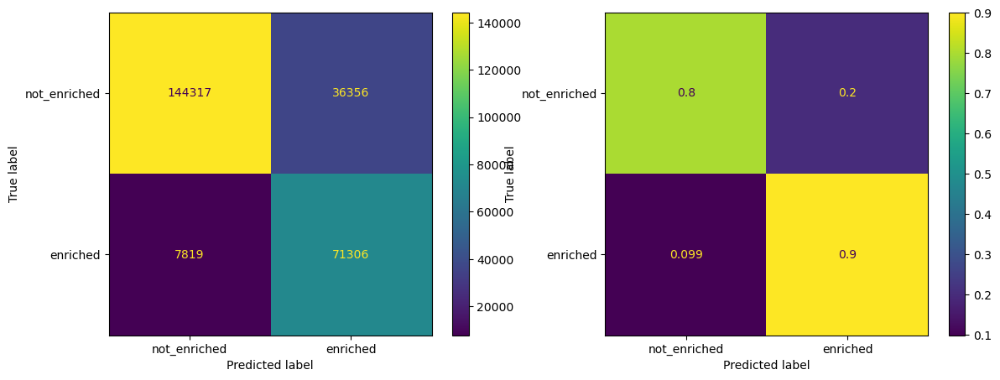

In [83]:
print("Arbre de décision acc, Angle avec Dist")
print("Accuracy Train:", accuracy_score(Y_density_dist_train, y_density_dist_train_pred))
print("AUC Train:", auc(false_pos_rate_dist_train, true_pos_rate_dist_train))
print()
print("Accuracy Test:", accuracy_score(Y_density_dist_test, y_density_dist_test_pred))
print("AUC Test:", auc(false_pos_rate_dist_test, true_pos_rate_dist_test))

fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(14, 5))
cm_dist = confusion_matrix(Y_density_dist_train, y_density_dist_train_pred)
cm2_dist = confusion_matrix(Y_density_dist_train, y_density_dist_train_pred, normalize="true")
ConfusionMatrixDisplay(confusion_matrix=cm_dist, display_labels=labels_class).plot(ax=ax1)
ConfusionMatrixDisplay(confusion_matrix=cm2_dist, display_labels=labels_class).plot(ax=ax2)
plt.show()

In [84]:
# Arbre de Décision
fig = plt.figure(figsize=(10, 30))
dot_data = tree.export_graphviz(
    clf_density_enriched,
    feature_names=x_columns,
    class_names=labels_class,
    filled=True
)
graph = graphviz.Source(dot_data, format="png")
#graph.render("../out/WT_decision_tree_density_t-plus_dist")
graph

<Figure size 1000x3000 with 0 Axes>

In [85]:
# Arbre de décision avec l'ajout de Dist & Angle
fig = plt.figure(figsize=(10, 30))
dot_data = tree.export_graphviz(
    clf_density_dist_enriched,
    feature_names=x_columns_dist,
    class_names=labels_class,
    filled=True
)

graph = graphviz.Source(dot_data, format="png")
graph.render("../out/WT_decision_tree_density_t-plus_dist")
graph

dot: graph is too large for cairo-renderer bitmaps. Scaling by 0.174252 to fit


<Figure size 1000x3000 with 0 Axes>

##### Random Forest

In [86]:
max_depths_rd = [2, 6, 10, 15, 20]
results_density_t_enriched_rf = models.forest_depth_acc(
    X_density_train, Y_density_train,
    X_density_test, Y_density_test,
    depths=max_depths_rd, 
    classifier=RandomForestClassifier,
    n_estimators = 100,
    class_weight="balanced",
    n_jobs=-1
)

results_density_dist_t_enriched_rf = models.forest_depth_acc(
    X_density_dist_train, Y_density_dist_train,
    X_density_dist_test, Y_density_dist_test,
    depths=max_depths_rd, 
    classifier=RandomForestClassifier,
    n_estimators = 100,
    class_weight="balanced",
    n_jobs=-1
)

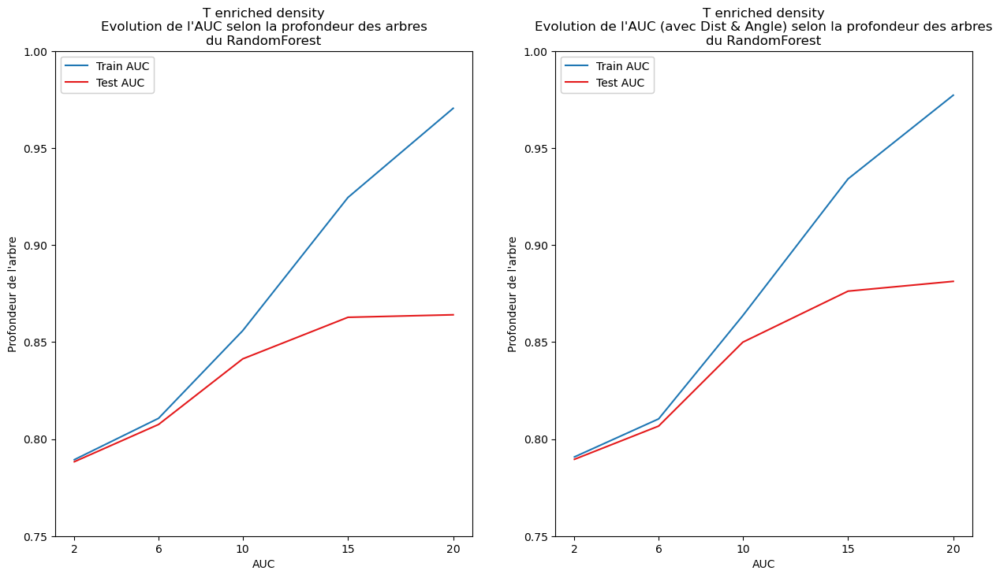

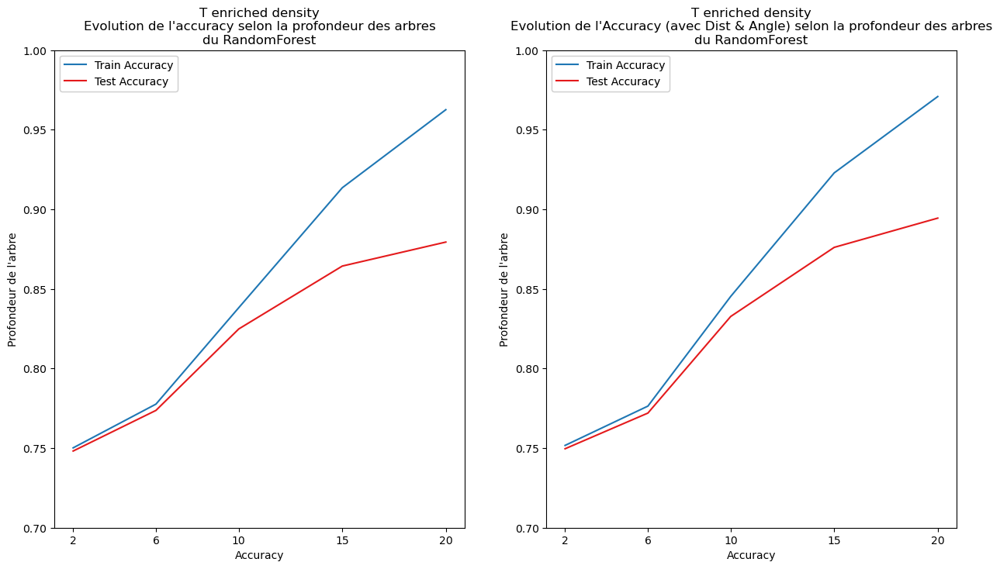

In [87]:
# Plot
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(15, 8))

plots.plot(
    results_density_t_enriched_rf["auc_train"],
    results_density_t_enriched_rf["auc_test"],
    indices=results_density_t_enriched_rf["depths"],
    label=("Train AUC", "Test AUC"),
    title="T enriched density\nEvolution de l'AUC selon la profondeur des arbres\ndu RandomForest",
    xlabel="AUC", ylabel="Profondeur de l'arbre",
    xticks=results_density_t_enriched_rf["depths"], showR2=False, showY=False,
    ytop=1, ybottom=0.75, figure=(fig, ax1)
)

plots.plot(
    results_density_dist_t_enriched_rf["auc_train"],
    results_density_dist_t_enriched_rf["auc_test"],
    indices=results_density_dist_t_enriched_rf["depths"],
    label=("Train AUC", "Test AUC"),
    title="T enriched density\nEvolution de l'AUC (avec Dist & Angle) selon la profondeur des arbres\ndu RandomForest",
    xlabel="AUC", ylabel="Profondeur de l'arbre",
    xticks=results_density_dist_t_enriched_rf["depths"], showR2=False, showY=False,
    ytop=1, ybottom=0.75, figure=(fig, ax2)
)

plt.show()

# Plot
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(15, 8))

plots.plot(
    results_density_t_enriched_rf["acc_train"],
    results_density_t_enriched_rf["acc_test"],
    indices=results_density_t_enriched_rf["depths"],
    label=("Train Accuracy", "Test Accuracy"),
    title="T enriched density\nEvolution de l'accuracy selon la profondeur des arbres\ndu RandomForest",
    xlabel="Accuracy", ylabel="Profondeur de l'arbre",
    xticks=results_density_t_enriched_rf["depths"], showR2=False, showY=False,
    ytop=1, ybottom=0.7, figure=(fig, ax1)
)

plots.plot(
    results_density_dist_t_enriched_rf["acc_train"],
    results_density_dist_t_enriched_rf["acc_test"],
    indices=results_density_dist_t_enriched_rf["depths"],
    label=("Train Accuracy", "Test Accuracy"),
    title="T enriched density\nEvolution de l'Accuracy (avec Dist & Angle) selon la profondeur des arbres\ndu RandomForest",
    xlabel="Accuracy", ylabel="Profondeur de l'arbre",
    xticks=results_density_dist_t_enriched_rf["depths"], showR2=False, showY=False,
    ytop=1, ybottom=0.7, figure=(fig, ax2)
)

plt.show()

In [88]:
print("----- Résumé des performances T enrichie (density20 > 0), Random Forest -----")
print(f"{'Profondeur':<20s}:", end=" ") ; [print(f"{i:<4d}", end="  ") for i in results_density_t_enriched_rf["depths"]] ; print("\n")
print(f"{'AUC_train':<20s}:", end=" ") ; [print(f"{i:<.2f}", end="  ") for i in results_density_t_enriched_rf["auc_train"]] ; print()
print(f"{'AUC_test':<20s}:", end=" ") ; [print(f"{i:<.2f}", end="  ") for i in results_density_t_enriched_rf["auc_test"]] ; print("\n")

print(f"{'Accuracy_train':<20s}:", end=" ") ; [print(f"{i:<.2f}", end="  ") for i in results_density_t_enriched_rf["acc_train"]] ; print()
print(f"{'Accuracy_test':<20s}:", end=" ") ; [print(f"{i:<.2f}", end="  ") for i in results_density_t_enriched_rf["acc_test"]] ; print("\n")

print("---")
print(f"{'AUC_train_dist':<20s}:", end=" ") ; [print(f"{i:<.2f}", end="  ") for i in results_density_dist_t_enriched_rf["auc_train"]] ; print()
print(f"{'AUC_test_dist':<20s}:", end=" ") ; [print(f"{i:<.2f}", end="  ") for i in results_density_dist_t_enriched_rf["auc_test"]] ; print("\n")

print(f"{'Accuracy_train_dist':<20s}:", end=" ") ; [print(f"{i:<.2f}", end="  ") for i in results_density_dist_t_enriched_rf["acc_train"]] ; print()
print(f"{'Accuracy_test_dist':<20s}:", end=" ") ; [print(f"{i:<.2f}", end="  ") for i in results_density_dist_t_enriched_rf["acc_test"]] ; print()

----- Résumé des performances T enrichie (density20 > 0), Random Forest -----
Profondeur          : 2     6     10    15    20    

AUC_train           : 0.79  0.81  0.86  0.92  0.97  
AUC_test            : 0.79  0.81  0.84  0.86  0.86  

Accuracy_train      : 0.75  0.78  0.84  0.91  0.96  
Accuracy_test       : 0.75  0.77  0.82  0.86  0.88  

---
AUC_train_dist      : 0.79  0.81  0.86  0.93  0.98  
AUC_test_dist       : 0.79  0.81  0.85  0.88  0.88  

Accuracy_train_dist : 0.75  0.78  0.85  0.92  0.97  
Accuracy_test_dist  : 0.75  0.77  0.83  0.88  0.89  


Best hyperparameters: {'n_estimators': 10, 'max_depth': 15}
Test Accuracy: 0.8582565429038458
Elapsed time to compute the importances: 0.004 seconds
Elapsed time to compute the importances: 12.261 seconds


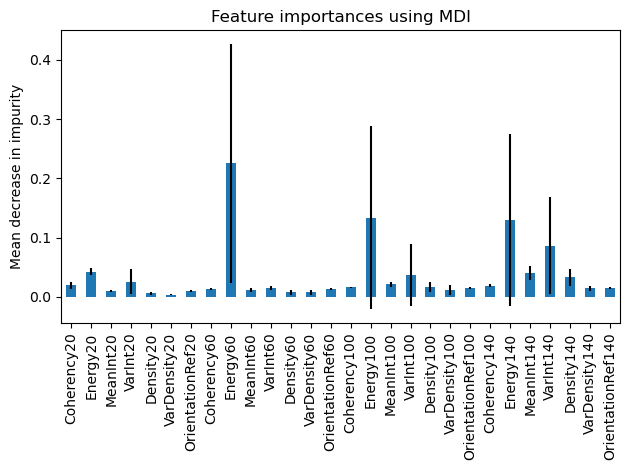

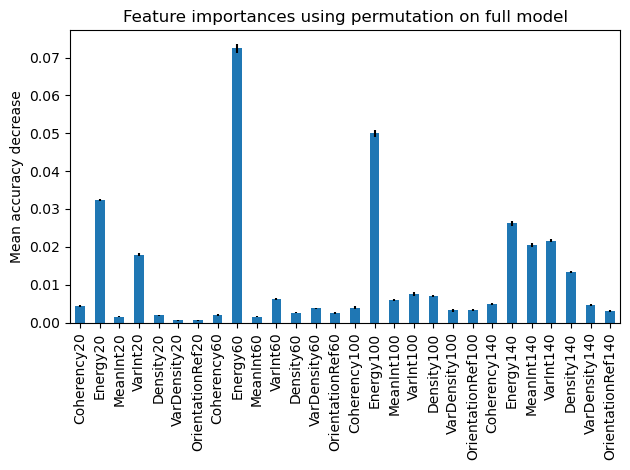

In [89]:
# Random forest
results_density_enriched = models.perform_random_forest(
    X_train=X_density_train,
    X_test=X_density_test,
    y_train=Y_density_train,
    y_test=Y_density_test,
    columns=x_columns,
    n_estimators=(10, 15, 20, 30),
    n_depths=(2, 4, 8, 10, 15),
    class_weight="balanced",
    scale=False
)

rf_density_enriched = results_density_enriched["model"]

In [90]:
df_mdi = pd.DataFrame(
    {
        "mean": results_density_enriched["importance_mdi"]["mean"],
        "std": results_density_enriched["importance_mdi"]["std"]
    }, index=x_columns
)

df_mdi.to_csv("WT_CD3_enriched_density_importance-mdi.csv")

df_permutation = pd.DataFrame(
    {
        "mean": results_density_enriched["importance_permutation"]["mean"],
        "std": results_density_enriched["importance_permutation"]["std"]
    }, index=x_columns
)

df_permutation.to_csv("WT_CD3_enriched_density_importance-permutation.csv")

Best hyperparameters: {'n_estimators': 15, 'max_depth': 15}
Test Accuracy: 0.8703364408758599
Elapsed time to compute the importances: 0.005 seconds
Elapsed time to compute the importances: 18.064 seconds


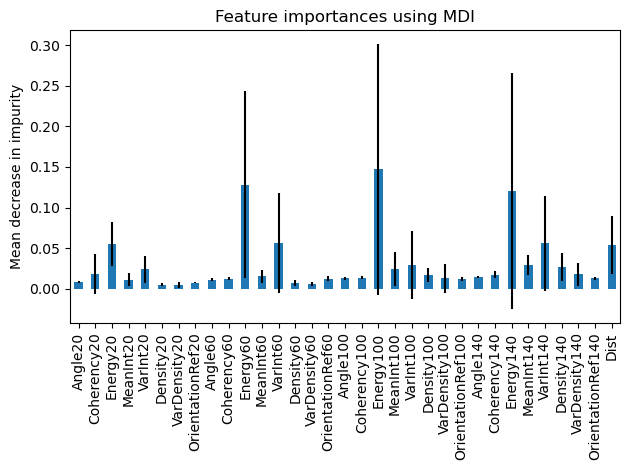

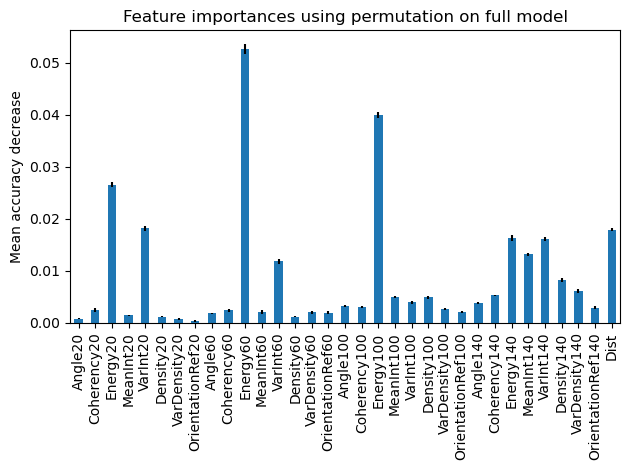

In [91]:
# Random forest with Dist & Angle
results_density_dist_enriched = models.perform_random_forest(
    X_train=X_density_dist_train,
    X_test=X_density_dist_test,
    y_train=Y_density_dist_train,
    y_test=Y_density_dist_test,
    columns=x_columns_dist,
    n_estimators=(10, 15, 20, 30),
    n_depths=(2, 4, 8, 10, 15),
    class_weight="balanced",
    scale=False
)

rf_density_dist_enriched = results_density_dist_enriched["model"]

In [92]:
df_mdi = pd.DataFrame(
    {
        "mean": results_density_dist_enriched["importance_mdi"]["mean"],
        "std": results_density_dist_enriched["importance_mdi"]["std"]
    }, index=x_columns_dist
)

df_mdi.to_csv("WT_CD3_enriched-dist_density_importance-mdi.csv")

df_permutation = pd.DataFrame(
    {
        "mean": results_density_dist_enriched["importance_permutation"]["mean"],
        "std": results_density_dist_enriched["importance_permutation"]["std"]
    }, index=x_columns_dist
)

df_permutation.to_csv("WT_CD3_enriched-dist_density_importance-permutation.csv")

In [93]:
# Model Accuracy, how often is the classifier correct?
y_density_train_pred = rf_density_enriched.predict(X_density_train)
y_density_test_pred = rf_density_enriched.predict(X_density_test)
y_density_dist_train_pred = rf_density_dist_enriched.predict(X_density_dist_train)
y_density_dist_test_pred = rf_density_dist_enriched.predict(X_density_dist_test)

# Performance
# Model Accuracy, how often is the classifier correct?
false_pos_rate_train, true_pos_rate_train, _ = roc_curve(Y_density_train, y_density_train_pred)
false_pos_rate_test, true_pos_rate_test, _ = roc_curve(Y_density_test, y_density_test_pred)

false_pos_rate_dist_train, true_pos_rate_dist_train, _ = roc_curve(Y_density_dist_train, y_density_dist_train_pred)
false_pos_rate_dist_test, true_pos_rate_dist_test, _ = roc_curve(Y_density_dist_test, y_density_dist_test_pred)

# Model Accuracy, how often is the classifier correct?
print("----- Random Forest (density20 > 0) -----")
print("Accuracy Train:", accuracy_score(Y_density_train, y_density_train_pred))
print("AUC Train:", auc(false_pos_rate_train, true_pos_rate_train))
print()
print("Accuracy Test:", accuracy_score(Y_density_test, y_density_test_pred))
print("AUC Test:", auc(false_pos_rate_test, true_pos_rate_test))
print()

print("Random Forest, Angle avec Dist")
print("Accuracy Train:", accuracy_score(Y_density_dist_train, y_density_dist_train_pred))
print("AUC Train:", auc(false_pos_rate_dist_train, true_pos_rate_dist_train))
print()
print("Accuracy Test:", accuracy_score(Y_density_dist_test, y_density_dist_test_pred))
print("AUC Test:", auc(false_pos_rate_dist_test, true_pos_rate_dist_test))

----- Random Forest (density20 > 0) -----
Accuracy Train: 0.907993902955373
AUC Train: 0.9181694171036431

Accuracy Test: 0.8582565429038458
AUC Test: 0.8565134505621141

Random Forest, Angle avec Dist
Accuracy Train: 0.9186521836195813
AUC Train: 0.9292029813508661

Accuracy Test: 0.8703364408758599
AUC Test: 0.8704526341457686


In [94]:
labels_class = pd.Series(rf_density_enriched.classes_).map({0: 'not_enriched', 1: 'enriched'}).values

----- Random Forest (density20 > 0) -----
Accuracy Train: 0.907993902955373
AUC Train: 0.9181694171036431

Accuracy Test: 0.8582565429038458
AUC Test: 0.8565134505621141



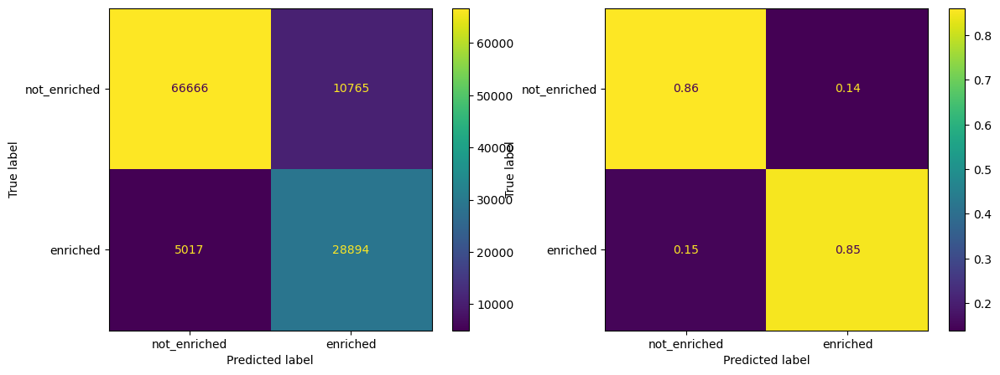

In [95]:
print("----- Random Forest (density20 > 0) -----")
print("Accuracy Train:", accuracy_score(Y_density_train, y_density_train_pred))
print("AUC Train:", auc(false_pos_rate_train, true_pos_rate_train))
print()
print("Accuracy Test:", accuracy_score(Y_density_test, y_density_test_pred))
print("AUC Test:", auc(false_pos_rate_test, true_pos_rate_test))
print()

fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(14, 5))
cm = confusion_matrix(Y_density_test, y_density_test_pred)
cm2 = confusion_matrix(Y_density_test, y_density_test_pred, normalize="true")
ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=labels_class).plot(ax=ax1)
ConfusionMatrixDisplay(confusion_matrix=cm2, display_labels=labels_class).plot(ax=ax2)
plt.show()

Random Forest, Angle avec Dist
Accuracy Train: 0.9186521836195813
AUC Train: 0.9292029813508661

Accuracy Test: 0.8703364408758599
AUC Test: 0.8704526341457686


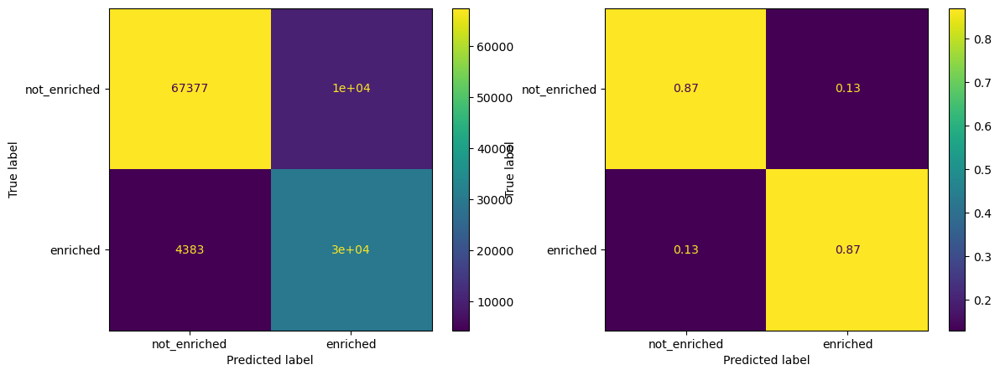

In [96]:
print("Random Forest, Angle avec Dist")
print("Accuracy Train:", accuracy_score(Y_density_dist_train, y_density_dist_train_pred))
print("AUC Train:", auc(false_pos_rate_dist_train, true_pos_rate_dist_train))
print()
print("Accuracy Test:", accuracy_score(Y_density_dist_test, y_density_dist_test_pred))
print("AUC Test:", auc(false_pos_rate_dist_test, true_pos_rate_dist_test))

fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(14, 5))
cm_dist = confusion_matrix(Y_density_dist_test, y_density_dist_test_pred)
cm2_dist = confusion_matrix(Y_density_dist_test, y_density_dist_test_pred, normalize="true")
ConfusionMatrixDisplay(confusion_matrix=cm_dist, display_labels=labels_class).plot(ax=ax1)
ConfusionMatrixDisplay(confusion_matrix=cm2_dist, display_labels=labels_class).plot(ax=ax2)
plt.show()

#### T enrichie 2

##### Arbre de décision

In [97]:
# Features columns
x_columns = [
    *constantes.float20_columns,
    *constantes.float60_columns,
    *constantes.float100_columns,
    *constantes.float140_columns
]
x_columns.remove("Angle20") ; x_columns.remove("Angle60") ; x_columns.remove("Angle100") ; x_columns.remove("Angle140")

# Features columns with Dist & Angle attributes
x_columns_dist = [
    *constantes.float20_columns,
    *constantes.float60_columns,
    *constantes.float100_columns,
    *constantes.float140_columns,
    *constantes.dist_columns
]

# Target column
y_column = "class_t_enriched_2"

# Define X and Y dataframe
X = data.dropna()[x_columns].values
X_dist = data.dropna()[x_columns_dist].values
Y = data.dropna()[y_column].values  # t plus class

# Train and Validation set
X_train, X_test, Y_train, Y_test = train_test_split(
    X, Y, test_size=0.3, random_state=42, stratify=Y
)

# Train and Validation set & (Angle & Dist) (to validate the model)
X_dist_train, X_dist_test, Y_dist_train, Y_dist_test = train_test_split(
    X_dist, Y, test_size=0.3, random_state=42, stratify=Y
)

In [98]:
print(f"----- T enrichie 2 -----")
print(f"{'Classe :':^45s}{'0':>6s}{'':2s}{'1':>6s}")
print(f"{'Comptage des classes au sein de Y:':45s}{sum(Y == 0):>6d}{'':2s}{sum(Y == 1):>6d}")
print(f"{'Comptage des classes au sein de Y_train:':45s}{sum(Y_train == 0):>6d}{'':2s}{sum(Y_train == 1):>6d}")
print(f"{'Comptage des classes au sein de Y_test:':45s}{sum(Y_test == 0):>6d}{'':2s}{sum(Y_test == 1):>6d}")
print(f"\nNombre d'observations totales : {Y.shape[0]:_}")

----- T enrichie 2 -----
                  Classe :                        0       1
Comptage des classes au sein de Y:           284648   85758
Comptage des classes au sein de Y_train:     199253   60031
Comptage des classes au sein de Y_test:       85395   25727

Nombre d'observations totales : 370_406


In [99]:
max_depths_clf = [2, 4, 6, 8, 10, 15, 20]

# Best number of depth
results_t_enriched = models.forest_depth_acc(
    X_train, Y_train, X_test, Y_test,
    depths=max_depths_clf, 
    classifier=DecisionTreeClassifier,
    class_weight="balanced"
)

# Best number of depth with Dist & Angle
results_dist_t_enriched = models.forest_depth_acc(
    X_dist_train, Y_dist_train, X_dist_test, Y_dist_test,
    depths=max_depths_clf, 
    classifier=DecisionTreeClassifier,
    class_weight="balanced"
)

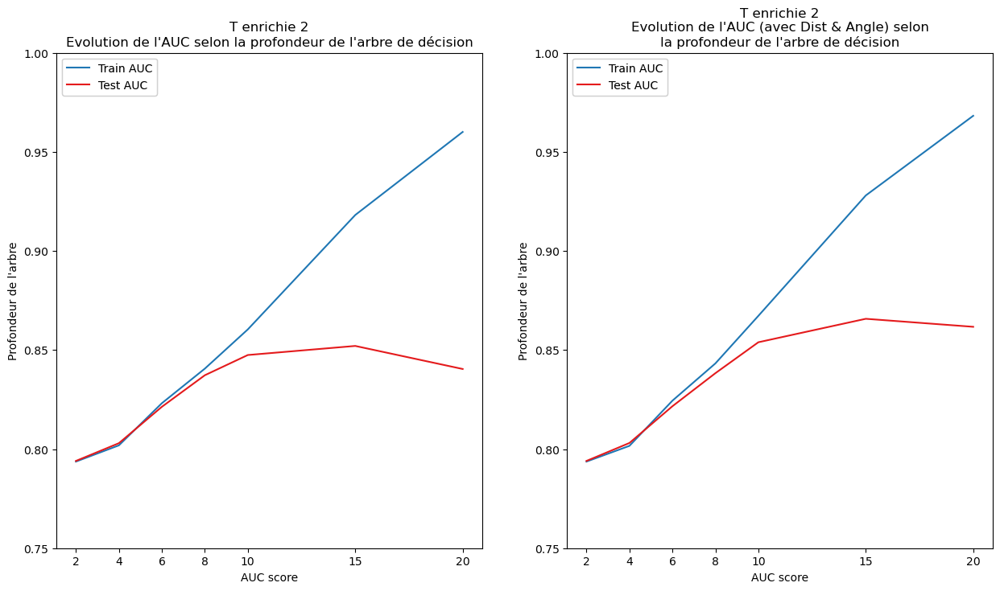

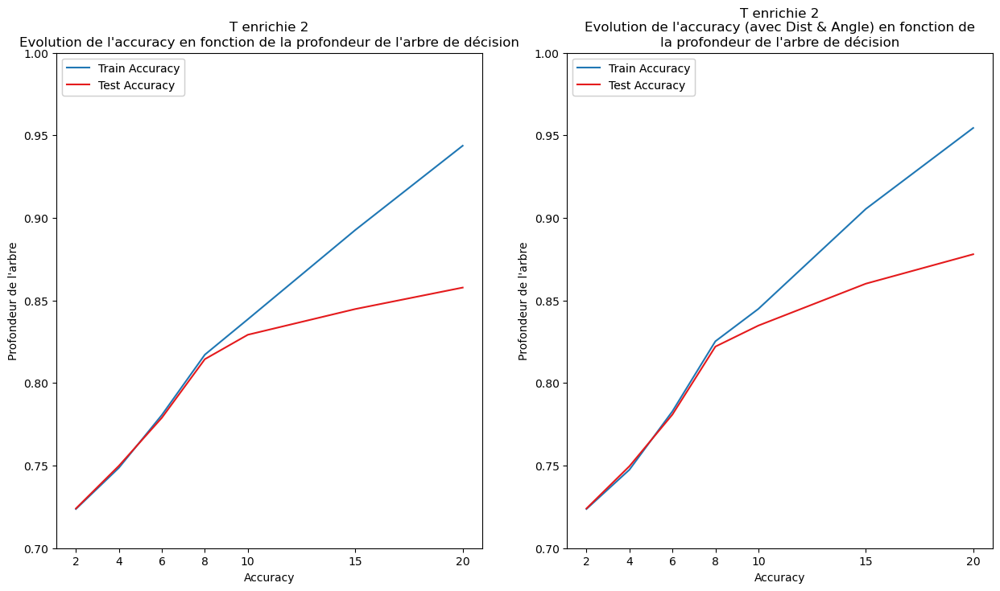

In [100]:
# Plot
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(15, 8))
plots.plot(
    results_t_enriched["auc_train"],
    results_t_enriched["auc_test"],
    indices=max_depths_clf,
    label=("Train AUC", "Test AUC"),
    title="T enrichie 2\nEvolution de l'AUC selon la profondeur de l'arbre de décision",
    xlabel="AUC score", ylabel="Profondeur de l'arbre",
    xticks=max_depths_clf, showR2=False, showY=False,
    ytop=1, ybottom=0.75, figure=(fig, ax1)
)

plots.plot(
    results_dist_t_enriched["auc_train"],
    results_dist_t_enriched["auc_test"],
    indices=max_depths_clf,
    label=("Train AUC", "Test AUC"),
    title="T enrichie 2\nEvolution de l'AUC (avec Dist & Angle) selon\nla profondeur de l'arbre de décision",
    xlabel="AUC score", ylabel="Profondeur de l'arbre",
    xticks=max_depths_clf, showR2=False, showY=False,
    ytop=1, ybottom=0.75, figure=(fig, ax2)
)
plt.show()

# Plot
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(15, 8))

plots.plot(
    results_t_enriched["acc_train"],
    results_t_enriched["acc_test"],
    indices=max_depths_clf,
    label=("Train Accuracy", "Test Accuracy"),
    title="T enrichie 2\nEvolution de l'accuracy en fonction de la profondeur de l'arbre de décision",
    xlabel="Accuracy", ylabel="Profondeur de l'arbre",
    xticks=max_depths_clf, showR2=False, showY=False,
    ytop=1, ybottom=0.7, figure=(fig, ax1)
)

plots.plot(
    results_dist_t_enriched["acc_train"],
    results_dist_t_enriched["acc_test"],
    indices=max_depths_clf,
    label=("Train Accuracy", "Test Accuracy"),
    title="T enrichie 2\nEvolution de l'accuracy (avec Dist & Angle) en fonction de\nla profondeur de l'arbre de décision",
    xlabel="Accuracy", ylabel="Profondeur de l'arbre",
    xticks=max_depths_clf, showR2=False, showY=False,
    ytop=1, ybottom=0.7, figure=(fig, ax2)
)

plt.show()

In [101]:
print("----- Résumé des performances T enrichie 2, arbre de décision -----")
print(f"{'Profondeur':<20s}:", end=" ") ; [print(f"{i:<4d}", end="  ") for i in results_t_enriched["depths"]] ; print("\n")
print(f"{'AUC_train':<20s}:", end=" ") ; [print(f"{i:<.2f}", end="  ") for i in results_t_enriched["auc_train"]] ; print()
print(f"{'AUC_test':<20s}:", end=" ") ; [print(f"{i:<.2f}", end="  ") for i in results_t_enriched["auc_test"]] ; print("\n")

print(f"{'Accuracy_train':<20s}:", end=" ") ; [print(f"{i:<.2f}", end="  ") for i in results_t_enriched["acc_train"]] ; print()
print(f"{'Accuracy_test':<20s}:", end=" ") ; [print(f"{i:<.2f}", end="  ") for i in results_t_enriched["acc_test"]] ; print("\n")

print("---")
print(f"{'AUC_train_dist':<20s}:", end=" ") ; [print(f"{i:<.2f}", end="  ") for i in results_dist_t_enriched["auc_train"]] ; print()
print(f"{'AUC_test_dist':<20s}:", end=" ") ; [print(f"{i:<.2f}", end="  ") for i in results_dist_t_enriched["auc_test"]] ; print("\n")

print(f"{'Accuracy_train_dist':<20s}:", end=" ") ; [print(f"{i:<.2f}", end="  ") for i in results_dist_t_enriched["acc_train"]] ; print()
print(f"{'Accuracy_test_dist':<20s}:", end=" ") ; [print(f"{i:<.2f}", end="  ") for i in results_dist_t_enriched["acc_test"]] ; print()

----- Résumé des performances T enrichie 2, arbre de décision -----
Profondeur          : 2     4     6     8     10    15    20    

AUC_train           : 0.79  0.80  0.82  0.84  0.86  0.92  0.96  
AUC_test            : 0.79  0.80  0.82  0.84  0.85  0.85  0.84  

Accuracy_train      : 0.72  0.75  0.78  0.82  0.84  0.89  0.94  
Accuracy_test       : 0.72  0.75  0.78  0.81  0.83  0.84  0.86  

---
AUC_train_dist      : 0.79  0.80  0.82  0.84  0.87  0.93  0.97  
AUC_test_dist       : 0.79  0.80  0.82  0.84  0.85  0.87  0.86  

Accuracy_train_dist : 0.72  0.75  0.78  0.83  0.84  0.91  0.95  
Accuracy_test_dist  : 0.72  0.75  0.78  0.82  0.83  0.86  0.88  


In [102]:
# Decision Tree (CART)
clf_enriched = DecisionTreeClassifier(
    criterion="entropy",
    max_depth=10,
    random_state=42,
    class_weight="balanced"
)

clf_enriched.fit(X_train, Y_train)
y_train_pred = clf_enriched.predict(X_train)
y_test_pred = clf_enriched.predict(X_test)

# Decision Tree (CART) with Dist column
clf_dist_enriched = DecisionTreeClassifier(
    criterion="entropy",
    max_depth=10,
    random_state=42,
    class_weight="balanced"
)

clf_dist_enriched.fit(X_dist_train, Y_dist_train)
y_dist_train_pred = clf_dist_enriched.predict(X_dist_train)
y_dist_test_pred = clf_dist_enriched.predict(X_dist_test)
clf_dist_enriched

DecisionTreeClassifier(class_weight='balanced', criterion='entropy',
                       max_depth=10, random_state=42)

In [103]:
false_pos_rate_train, true_pos_rate_train, _ = roc_curve(Y_train, y_train_pred)
false_pos_rate_test, true_pos_rate_test, _ = roc_curve(Y_test, y_test_pred)

false_pos_rate_dist_train, true_pos_rate_dist_train, _ = roc_curve(Y_dist_train, y_dist_train_pred)
false_pos_rate_dist_test, true_pos_rate_dist_test, _ = roc_curve(Y_dist_test, y_dist_test_pred)

In [104]:
labels_class = pd.Series(clf_enriched.classes_).map({0: 'not_enriched_2', 1: 'enriched_2'}).values

----- Arbre de décision -----
Accuracy Train: 0.8177751037472424
AUC Train: 0.8503252788543197

Accuracy Test: 0.8108655351775526
AUC Test: 0.8415809279103537



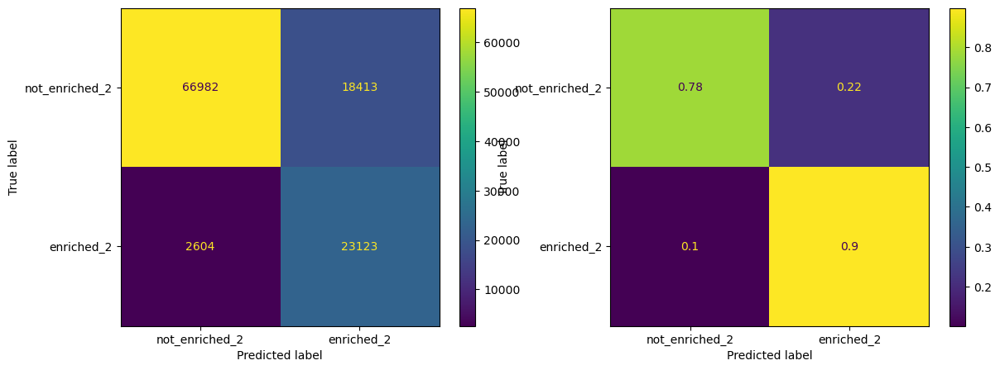

In [105]:
print("----- Arbre de décision -----")
print("Accuracy Train:", accuracy_score(Y_train, y_train_pred))
print("AUC Train:", auc(false_pos_rate_train, true_pos_rate_train))
print()
print("Accuracy Test:", accuracy_score(Y_test, y_test_pred))
print("AUC Test:", auc(false_pos_rate_test, true_pos_rate_test))
print()

fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(14, 5))
cm = confusion_matrix(Y_test, y_test_pred)
cm2 = confusion_matrix(Y_test, y_test_pred, normalize="true")
ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=labels_class).plot(ax=ax1)
ConfusionMatrixDisplay(confusion_matrix=cm2, display_labels=labels_class).plot(ax=ax2)
plt.show()

Arbre de décision, Angle avec Dist
Accuracy Train: 0.8277024421098101
AUC Train: 0.8553236696543558

Accuracy Test: 0.8205305880023758
AUC Test: 0.8464299050181983


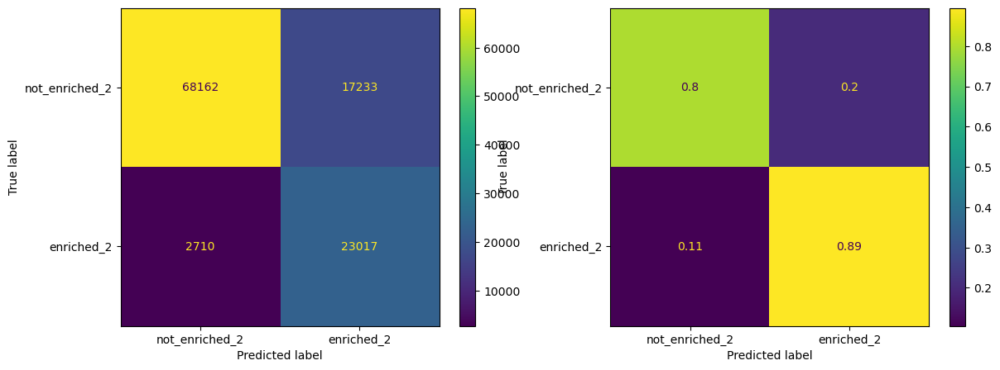

In [106]:
print("Arbre de décision, Angle avec Dist")
print("Accuracy Train:", accuracy_score(Y_dist_train, y_dist_train_pred))
print("AUC Train:", auc(false_pos_rate_dist_train, true_pos_rate_dist_train))
print()
print("Accuracy Test:", accuracy_score(Y_dist_test, y_dist_test_pred))
print("AUC Test:", auc(false_pos_rate_dist_test, true_pos_rate_dist_test))

fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(14, 5))
cm_dist = confusion_matrix(Y_dist_test, y_dist_test_pred)
cm2_dist = confusion_matrix(Y_dist_test, y_dist_test_pred, normalize="true")
ConfusionMatrixDisplay(confusion_matrix=cm_dist, display_labels=labels_class).plot(ax=ax1)
ConfusionMatrixDisplay(confusion_matrix=cm2_dist, display_labels=labels_class).plot(ax=ax2)
plt.show()

In [107]:
# Arbre de Décision
fig = plt.figure(figsize=(10, 30))
dot_data = tree.export_graphviz(
    clf_enriched,
    feature_names=x_columns,
    class_names=labels_class,
    filled=True
)
graph = graphviz.Source(dot_data, format="png")
#graph.render("../out/WT_decision_tree_t-enriched_2")
graph

<Figure size 1000x3000 with 0 Axes>

In [108]:
# Arbre de décision avec l'ajout de Dist & Angle
fig = plt.figure(figsize=(10, 30))
dot_data = tree.export_graphviz(
    clf_dist_enriched,
    feature_names=x_columns_dist,
    class_names=labels_class,
    filled=True
)
graph = graphviz.Source(dot_data, format="png")
#graph.render("../out/WT_decision_tree_t-enriched_2_dist")
graph

<Figure size 1000x3000 with 0 Axes>

##### Random Forest

In [109]:
max_depths_rd = [2, 4, 6, 8, 10, 15, 20]
results_t_enriched_rf = models.forest_depth_acc(
    X_train, Y_train, X_test, Y_test,
    depths=max_depths_rd, 
    classifier=RandomForestClassifier,
    n_estimators = 100,
    class_weight="balanced",
    n_jobs=-1
)

results_dist_t_enriched_rf = models.forest_depth_acc(
    X_dist_train, Y_dist_train, X_dist_test, Y_dist_test,
    depths=max_depths_rd, 
    classifier=RandomForestClassifier,
    n_estimators = 100,
    class_weight="balanced",
    n_jobs=-1
)

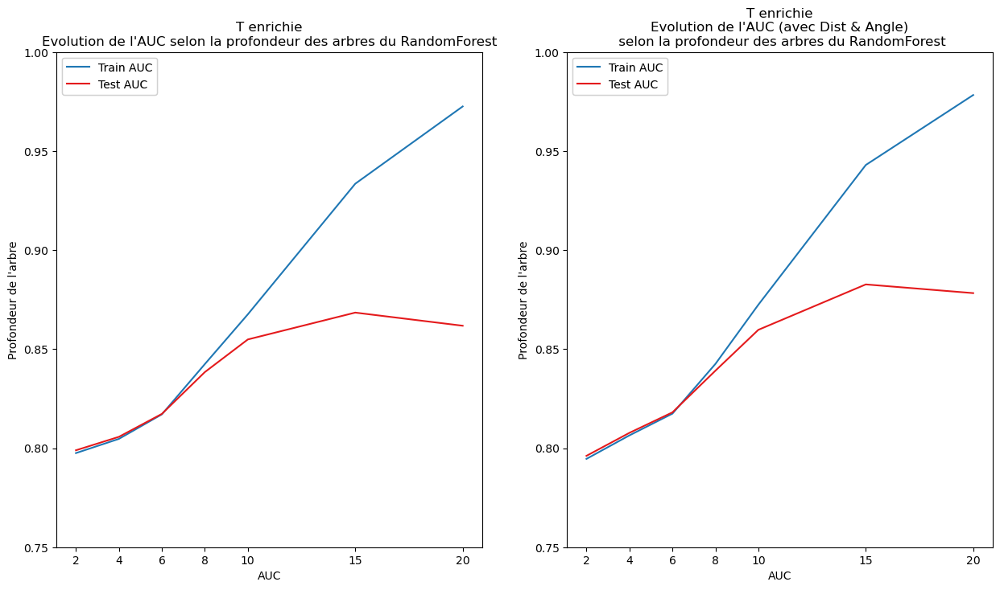

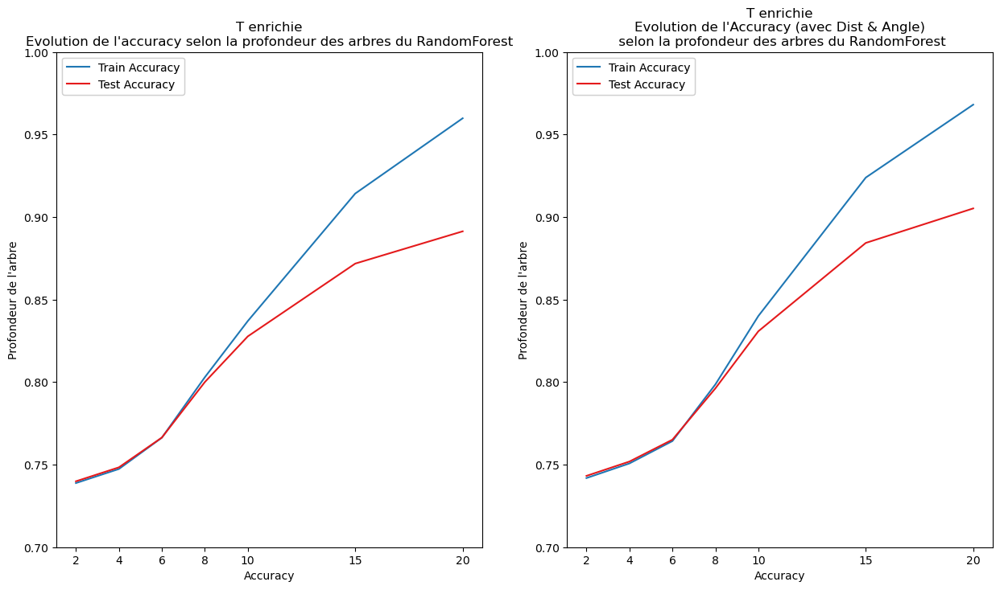

In [110]:
# Plot
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(15, 8))

plots.plot(
    results_t_enriched_rf["auc_train"],
    results_t_enriched_rf["auc_test"],
    indices=max_depths_rd,
    label=("Train AUC", "Test AUC"),
    title="T enrichie\nEvolution de l'AUC selon la profondeur des arbres du RandomForest",
    xlabel="AUC", ylabel="Profondeur de l'arbre",
    xticks=max_depths_rd, showR2=False, showY=False,
    ytop=1, ybottom=0.75, figure=(fig, ax1)
)

plots.plot(
    results_dist_t_enriched_rf["auc_train"],
    results_dist_t_enriched_rf["auc_test"],
    indices=max_depths_rd,
    label=("Train AUC", "Test AUC"),
    title="T enrichie\nEvolution de l'AUC (avec Dist & Angle)\n selon la profondeur des arbres du RandomForest",
    xlabel="AUC", ylabel="Profondeur de l'arbre",
    xticks=max_depths_rd, showR2=False, showY=False,
    ytop=1, ybottom=0.75, figure=(fig, ax2)
)

plt.show()

# Plot
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(15, 8))

plots.plot(
    results_t_enriched_rf["acc_train"],
    results_t_enriched_rf["acc_test"],
    indices=max_depths_clf,
    label=("Train Accuracy", "Test Accuracy"),
    title="T enrichie\nEvolution de l'accuracy selon la profondeur des arbres du RandomForest",
    xlabel="Accuracy", ylabel="Profondeur de l'arbre",
    xticks=max_depths_rd, showR2=False, showY=False,
    ytop=1, ybottom=0.7, figure=(fig, ax1)
)

plots.plot(
    results_dist_t_enriched_rf["acc_train"],
    results_dist_t_enriched_rf["acc_test"],
    indices=max_depths_rd,
    label=("Train Accuracy", "Test Accuracy"),
    title="T enrichie\nEvolution de l'Accuracy (avec Dist & Angle)\n selon la profondeur des arbres du RandomForest",
    xlabel="Accuracy", ylabel="Profondeur de l'arbre",
    xticks=max_depths_rd, showR2=False, showY=False,
    ytop=1, ybottom=0.7, figure=(fig, ax2)
)

plt.show()

In [111]:
print("----- Résumé des performances T enrichie, arbre de décision -----")
print(f"{'Profondeur':<20s}:", end=" ") ; [print(f"{i:<4d}", end="  ") for i in results_t_enriched_rf["depths"]] ; print("\n")
print(f"{'AUC_train':<20s}:", end=" ") ; [print(f"{i:<.2f}", end="  ") for i in results_t_enriched_rf["auc_train"]] ; print()
print(f"{'AUC_test':<20s}:", end=" ") ; [print(f"{i:<.2f}", end="  ") for i in results_t_enriched_rf["auc_test"]] ; print("\n")

print(f"{'Accuracy_train':<20s}:", end=" ") ; [print(f"{i:<.2f}", end="  ") for i in results_t_enriched_rf["acc_train"]] ; print()
print(f"{'Accuracy_test':<20s}:", end=" ") ; [print(f"{i:<.2f}", end="  ") for i in results_t_enriched_rf["acc_test"]] ; print("\n")

print("---")
print(f"{'AUC_train_dist':<20s}:", end=" ") ; [print(f"{i:<.2f}", end="  ") for i in results_dist_t_enriched_rf["auc_train"]] ; print()
print(f"{'AUC_test_dist':<20s}:", end=" ") ; [print(f"{i:<.2f}", end="  ") for i in results_dist_t_enriched_rf["auc_test"]] ; print("\n")

print(f"{'Accuracy_train_dist':<20s}:", end=" ") ; [print(f"{i:<.2f}", end="  ") for i in results_dist_t_enriched_rf["acc_train"]] ; print()
print(f"{'Accuracy_test_dist':<20s}:", end=" ") ; [print(f"{i:<.2f}", end="  ") for i in results_dist_t_enriched_rf["acc_test"]] ; print()

----- Résumé des performances T enrichie, arbre de décision -----
Profondeur          : 2     4     6     8     10    15    20    

AUC_train           : 0.80  0.80  0.82  0.84  0.87  0.93  0.97  
AUC_test            : 0.80  0.81  0.82  0.84  0.85  0.87  0.86  

Accuracy_train      : 0.74  0.75  0.77  0.80  0.84  0.91  0.96  
Accuracy_test       : 0.74  0.75  0.77  0.80  0.83  0.87  0.89  

---
AUC_train_dist      : 0.79  0.81  0.82  0.84  0.87  0.94  0.98  
AUC_test_dist       : 0.80  0.81  0.82  0.84  0.86  0.88  0.88  

Accuracy_train_dist : 0.74  0.75  0.76  0.80  0.84  0.92  0.97  
Accuracy_test_dist  : 0.74  0.75  0.77  0.80  0.83  0.88  0.91  


Best hyperparameters: {'n_estimators': 20, 'max_depth': 15}
Test Accuracy: 0.8699987401234679
Elapsed time to compute the importances: 0.004 seconds
Elapsed time to compute the importances: 23.071 seconds


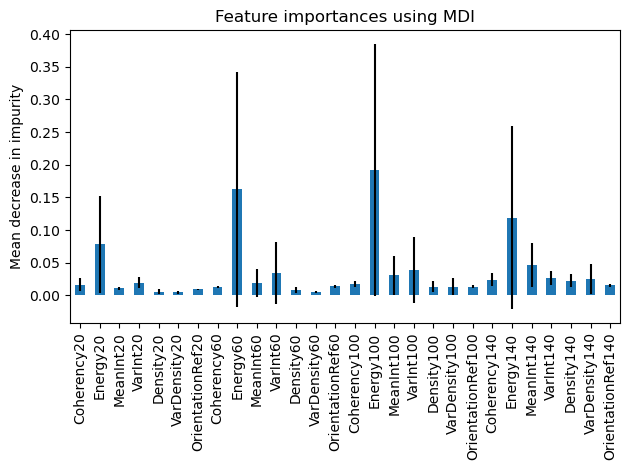

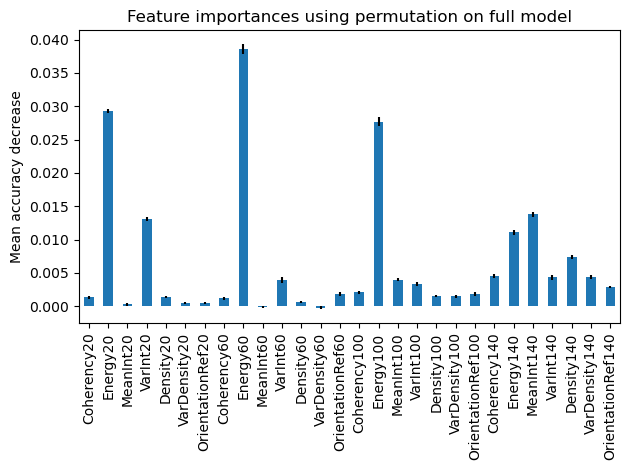

In [112]:
# RandomForest model
results_enriched = models.perform_random_forest(
    X_train=X_train,
    X_test=X_test,
    y_train=Y_train,
    y_test=Y_test,
    columns=x_columns,
    n_estimators=(10, 15, 20, 30),
    n_depths=(2, 4, 8, 10, 15),
    class_weight="balanced",
    scale=False
)

rf_enriched = results_enriched["model"]

In [113]:
df_mdi = pd.DataFrame(
    {
        "mean": results_enriched["importance_mdi"]["mean"],
        "std": results_enriched["importance_mdi"]["std"]
    }, index=x_columns
)

df_mdi.to_csv("WT_CD3_enriched_importance-mdi.csv")

df_permutation = pd.DataFrame(
    {
        "mean": results_enriched["importance_permutation"]["mean"],
        "std": results_enriched["importance_permutation"]["std"]
    }, index=x_columns
)

df_permutation.to_csv("WT_CD3_enriched_importance-permutation.csv")

Best hyperparameters: {'n_estimators': 30, 'max_depth': 15}
Test Accuracy: 0.882399524846565
Elapsed time to compute the importances: 0.006 seconds
Elapsed time to compute the importances: 33.159 seconds


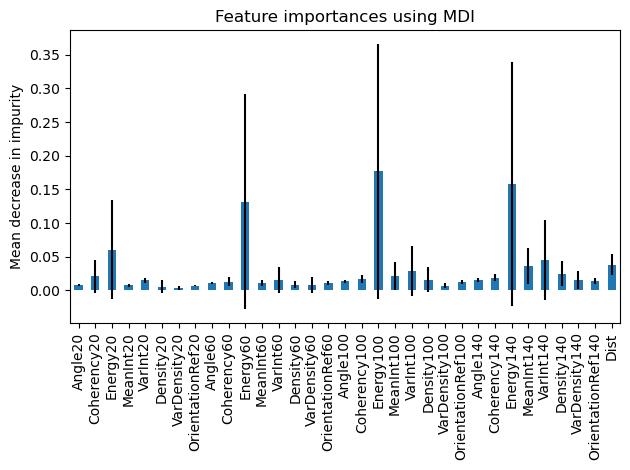

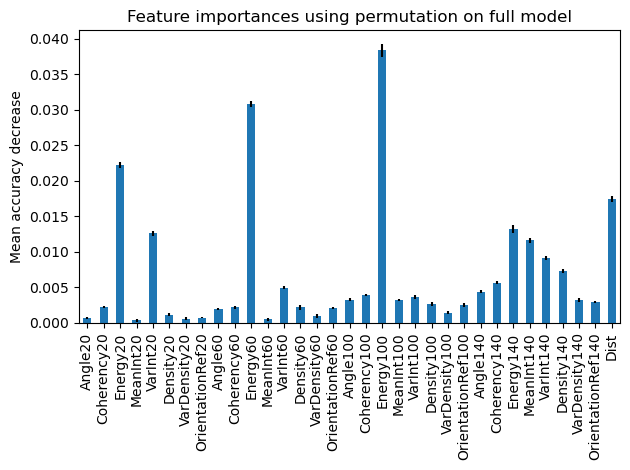

In [114]:
# RandomForest model with Dist & Angle columns
results_dist_enriched = models.perform_random_forest(
    X_train=X_dist_train,
    X_test=X_dist_test,
    y_train=Y_dist_train,
    y_test=Y_dist_test,
    columns=x_columns_dist,
    n_estimators=(10, 15, 20, 30),
    n_depths=(2, 4, 8, 10, 15),
    class_weight="balanced",
    scale=False
)

rf_dist_enriched = results_dist_enriched["model"]

In [115]:
df_mdi = pd.DataFrame(
    {
        "mean": results_dist_enriched["importance_mdi"]["mean"],
        "std": results_dist_enriched["importance_mdi"]["std"]
    }, index=x_columns_dist
)

df_mdi.to_csv("WT_CD3_enriched-dist_importance-mdi.csv")

df_permutation = pd.DataFrame(
    {
        "mean": results_dist_enriched["importance_permutation"]["mean"],
        "std": results_dist_enriched["importance_permutation"]["std"]
    }, index=x_columns_dist
)

df_permutation.to_csv("WT_CD3_enriched-dist_importance-permutation.csv")

In [116]:
# Model Accuracy, how often is the classifier correct?
y_train_pred = rf_enriched.predict(X_train)
y_test_pred = rf_enriched.predict(X_test)
y_dist_train_pred = rf_dist_enriched.predict(X_dist_train)
y_dist_test_pred = rf_dist_enriched.predict(X_dist_test)

In [117]:
false_pos_rate_train, true_pos_rate_train, _ = roc_curve(Y_train, y_train_pred)
false_pos_rate_test, true_pos_rate_test, _ = roc_curve(Y_test, y_test_pred)

false_pos_rate_dist_train, true_pos_rate_dist_train, _ = roc_curve(Y_dist_train, y_dist_train_pred)
false_pos_rate_dist_test, true_pos_rate_dist_test, _ = roc_curve(Y_dist_test, y_dist_test_pred)

In [118]:
labels_class = pd.Series(rf_enriched.classes_).map({0: 'not_enriched', 1: 'enriched'}).values

----- Random Forest -----
Accuracy Train: 0.9114098825997747
AUC Train: 0.9293527790290338

Accuracy Test: 0.8699987401234679
AUC Test: 0.8658371407072927



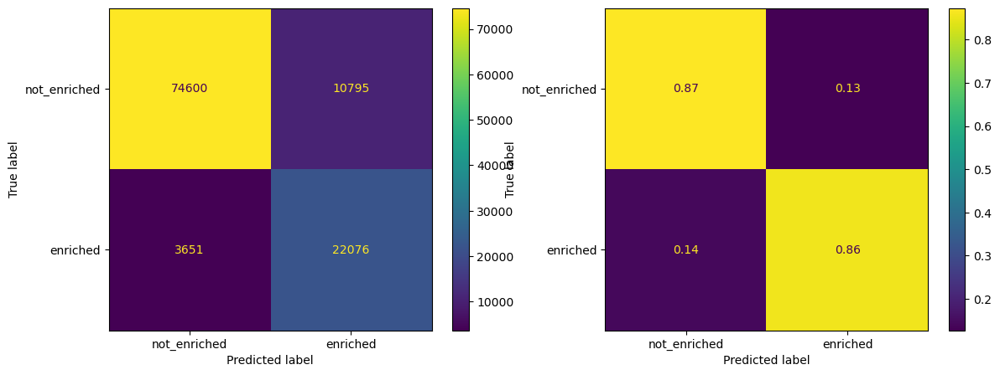

In [119]:
print("----- Random Forest -----")
print("Accuracy Train:", accuracy_score(Y_train, y_train_pred))
print("AUC Train:", auc(false_pos_rate_train, true_pos_rate_train))
print()
print("Accuracy Test:", accuracy_score(Y_test, y_test_pred))
print("AUC Test:", auc(false_pos_rate_test, true_pos_rate_test))
print()

fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(14, 5))
cm = confusion_matrix(Y_test, y_test_pred)
cm2 = confusion_matrix(Y_test, y_test_pred, normalize="true")
ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=labels_class).plot(ax=ax1)
ConfusionMatrixDisplay(confusion_matrix=cm2, display_labels=labels_class).plot(ax=ax2)
plt.show()

Random Forest, Angle avec Dist
Accuracy Train: 0.9199989201030531
AUC Train: 0.9391022067094098

Accuracy Test: 0.882399524846565
AUC Test: 0.8815508949624877


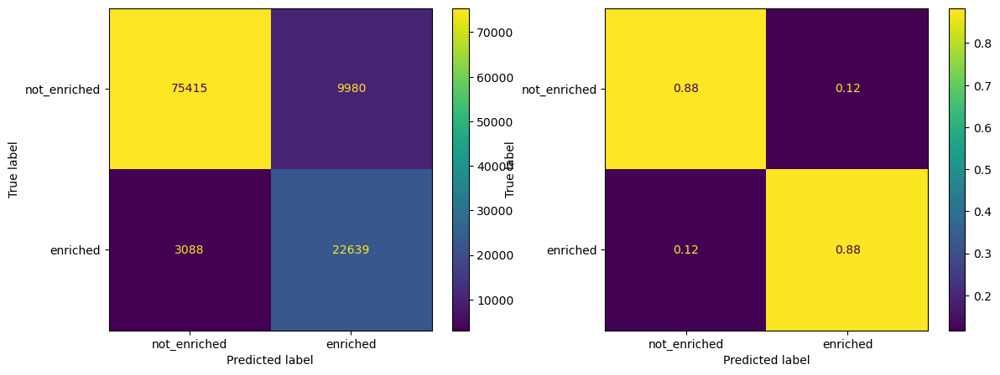

In [120]:
print("Random Forest, Angle avec Dist")
print("Accuracy Train:", accuracy_score(Y_dist_train, y_dist_train_pred))
print("AUC Train:", auc(false_pos_rate_dist_train, true_pos_rate_dist_train))
print()
print("Accuracy Test:", accuracy_score(Y_dist_test, y_dist_test_pred))
print("AUC Test:", auc(false_pos_rate_dist_test, true_pos_rate_dist_test))

fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(14, 5))
cm_dist = confusion_matrix(Y_dist_test, y_dist_test_pred)
cm2_dist = confusion_matrix(Y_dist_test, y_dist_test_pred, normalize="true")
ConfusionMatrixDisplay(confusion_matrix=cm_dist, display_labels=labels_class).plot(ax=ax1)
ConfusionMatrixDisplay(confusion_matrix=cm2_dist, display_labels=labels_class).plot(ax=ax2)
plt.show()

#### T enrichie & Density20 > 0

##### Jeu de données d'apprentissage et de validation (à densité20 > 0)

In [121]:
# Features columns
x_columns = [
    *constantes.float20_columns,
    *constantes.float60_columns,
    *constantes.float100_columns,
    *constantes.float140_columns
]
x_columns.remove("Angle20") ; x_columns.remove("Angle60") ; x_columns.remove("Angle100") ; x_columns.remove("Angle140")

# Features columns with Dist & Angle attributes
x_columns_dist = [
    *constantes.float20_columns,
    *constantes.float60_columns,
    *constantes.float100_columns,
    *constantes.float140_columns,
    *constantes.dist_columns
]

# Target column
y_column = "class_t_enriched_2"

# Define X and Y dataframe
dt_XY = data[mask_cd3_density_in][[*x_columns_dist, y_column]].dropna()
X_density = dt_XY[x_columns].values  # X
X_density_dist = dt_XY[x_columns_dist].values  # X_dist
Y_density = dt_XY[y_column].values  # Y

# Train and Validation set
X_density_train, X_density_test, Y_density_train, Y_density_test = train_test_split(
    X_density, Y_density, test_size=0.3, random_state=42, stratify=Y_density
)

# Train and Validation set (with Angle & Dist)
X_density_dist_train, X_density_dist_test, Y_density_dist_train, Y_density_dist_test = train_test_split(
    X_density_dist, Y_density, test_size=0.3, random_state=42, stratify=Y_density
)

In [122]:
print(f"----- T enrichie 2 (density20 > 0)-----")
print(f"{'Classe :':^45s}{'0':>6s}{'':2s}{'1':>6s}")
print(f"{'Comptage des classes au sein de Y:':45s}{sum(Y_density == 0):>6d}{'':2s}{sum(Y_density == 1):>6d}")
print(f"{'Comptage des classes au sein de Y_train:':45s}{sum(Y_density_train == 0):>6d}{'':2s}{sum(Y_density_train == 1):>6d}")
print(f"{'Comptage des classes au sein de Y_test:':45s}{sum(Y_density_test == 0):>6d}{'':2s}{sum(Y_density_test == 1):>6d}")
print(f"\nNombre d'observations totales : {Y_density.shape[0]:_}")

----- T enrichie 2 (density20 > 0)-----
                  Classe :                        0       1
Comptage des classes au sein de Y:           285326   85814
Comptage des classes au sein de Y_train:     199728   60070
Comptage des classes au sein de Y_test:       85598   25744

Nombre d'observations totales : 371_140


#### Arbre de décision

In [123]:
max_depths_clf = [2, 4, 6, 8, 10, 15, 20]

# Best number of depth
results_density_t_enriched_2 = models.forest_depth_acc(
    X_density_train, Y_density_train,
    X_density_test, Y_density_test,
    depths=max_depths_clf, 
    classifier=DecisionTreeClassifier,
    class_weight="balanced",
)

# Best number of depth with Dist & Angle
results_density_dist_t_enriched_2 = models.forest_depth_acc(
    X_density_dist_train, Y_density_dist_train,
    X_density_dist_test, Y_density_dist_test,
    depths=max_depths_clf, 
    classifier=DecisionTreeClassifier,
    class_weight="balanced",
)

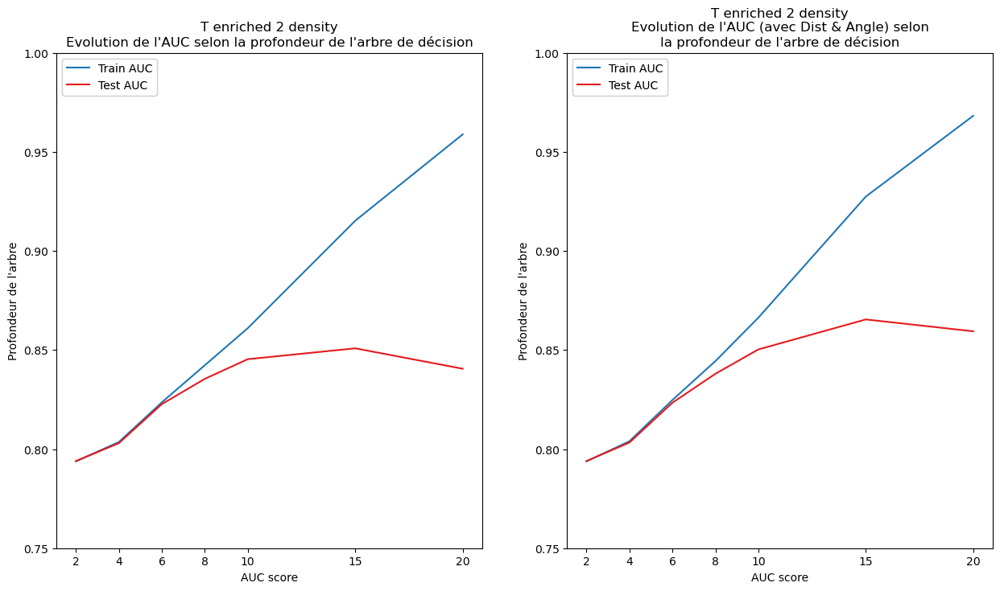

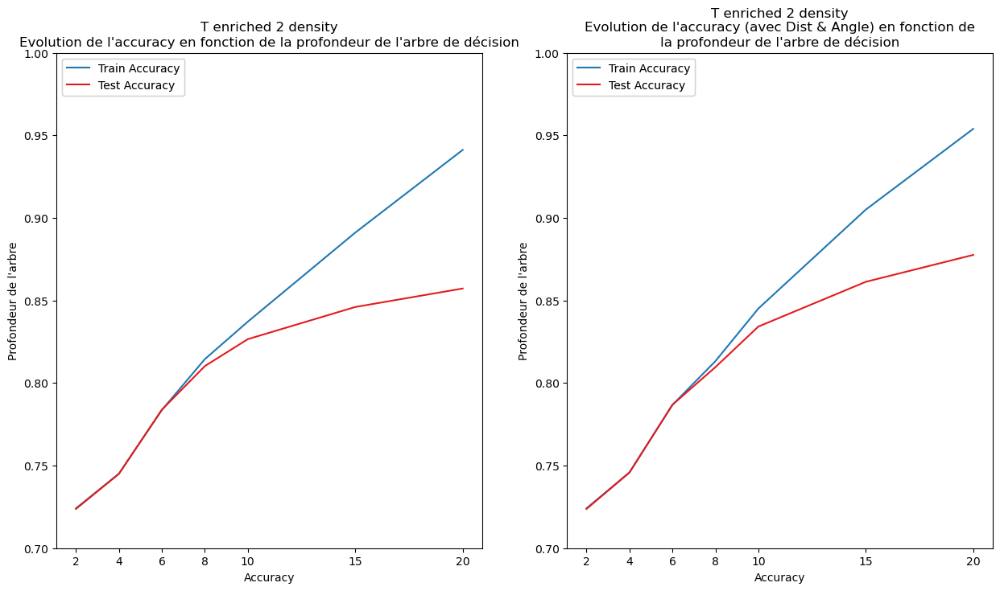

In [124]:
# Plot AUC
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(15, 8))
plots.plot(
    results_density_t_enriched_2["auc_train"],
    results_density_t_enriched_2["auc_test"],
    indices=max_depths_clf,
    label=("Train AUC", "Test AUC"),
    title="T enriched 2 density\nEvolution de l'AUC selon la profondeur de l'arbre de décision",
    xlabel="AUC score", ylabel="Profondeur de l'arbre",
    xticks=max_depths_clf, showR2=False, showY=False,
    ytop=1, ybottom=0.75, figure=(fig, ax1)
)

plots.plot(
    results_density_dist_t_enriched_2["auc_train"],
    results_density_dist_t_enriched_2["auc_test"],
    indices=max_depths_clf,
    label=("Train AUC", "Test AUC"),
    title="T enriched 2 density\nEvolution de l'AUC (avec Dist & Angle) selon\nla profondeur de l'arbre de décision",
    xlabel="AUC score", ylabel="Profondeur de l'arbre",
    xticks=max_depths_clf, showR2=False, showY=False,
    ytop=1, ybottom=0.75, figure=(fig, ax2)
)
plt.show()

# Plot accuracy
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(15, 8))

plots.plot(
    results_density_t_enriched_2["acc_train"],
    results_density_t_enriched_2["acc_test"],
    indices=max_depths_clf,
    label=("Train Accuracy", "Test Accuracy"),
    title="T enriched 2 density\nEvolution de l'accuracy en fonction de la profondeur de l'arbre de décision",
    xlabel="Accuracy", ylabel="Profondeur de l'arbre",
    xticks=max_depths_clf, showR2=False, showY=False,
    ytop=1, ybottom=0.7, figure=(fig, ax1)
)

plots.plot(
    results_density_dist_t_enriched_2["acc_train"],
    results_density_dist_t_enriched_2["acc_test"],
    indices=max_depths_clf,
    label=("Train Accuracy", "Test Accuracy"),
    title="T enriched 2 density\nEvolution de l'accuracy (avec Dist & Angle) en fonction de\nla profondeur de l'arbre de décision",
    xlabel="Accuracy", ylabel="Profondeur de l'arbre",
    xticks=max_depths_clf, showR2=False, showY=False,
    ytop=1, ybottom=0.7, figure=(fig, ax2)
)
plt.show()

In [125]:
print("----- Résumé des performances T plus (density20 > 0), arbre de décision -----")
print(f"{'Profondeur':<20s}:", end=" ") ; [print(f"{i:<4d}", end="  ") for i in results_density_t_enriched_2["depths"]] ; print("\n")
print(f"{'AUC_train':<20s}:", end=" ") ; [print(f"{i:<.2f}", end="  ") for i in results_density_t_enriched_2["auc_train"]] ; print()
print(f"{'AUC_test':<20s}:", end=" ") ; [print(f"{i:<.2f}", end="  ") for i in results_density_t_enriched_2["auc_test"]] ; print("\n")

print(f"{'Accuracy_train':<20s}:", end=" ") ; [print(f"{i:<.2f}", end="  ") for i in results_density_t_enriched_2["acc_train"]] ; print()
print(f"{'Accuracy_test':<20s}:", end=" ") ; [print(f"{i:<.2f}", end="  ") for i in results_density_t_enriched_2["acc_test"]] ; print("\n")

print("---")
print(f"{'AUC_train_dist':<20s}:", end=" ") ; [print(f"{i:<.2f}", end="  ") for i in results_density_dist_t_enriched_2["auc_train"]] ; print()
print(f"{'AUC_test_dist':<20s}:", end=" ") ; [print(f"{i:<.2f}", end="  ") for i in results_density_dist_t_enriched_2["auc_test"]] ; print("\n")

print(f"{'Accuracy_train_dist':<20s}:", end=" ") ; [print(f"{i:<.2f}", end="  ") for i in results_density_dist_t_enriched_2["acc_train"]] ; print()
print(f"{'Accuracy_test_dist':<20s}:", end=" ") ; [print(f"{i:<.2f}", end="  ") for i in results_density_dist_t_enriched_2["acc_test"]] ; print()

----- Résumé des performances T plus (density20 > 0), arbre de décision -----
Profondeur          : 2     4     6     8     10    15    20    

AUC_train           : 0.79  0.80  0.82  0.84  0.86  0.92  0.96  
AUC_test            : 0.79  0.80  0.82  0.84  0.85  0.85  0.84  

Accuracy_train      : 0.72  0.75  0.78  0.81  0.84  0.89  0.94  
Accuracy_test       : 0.72  0.75  0.78  0.81  0.83  0.85  0.86  

---
AUC_train_dist      : 0.79  0.80  0.82  0.84  0.87  0.93  0.97  
AUC_test_dist       : 0.79  0.80  0.82  0.84  0.85  0.87  0.86  

Accuracy_train_dist : 0.72  0.75  0.79  0.81  0.85  0.91  0.95  
Accuracy_test_dist  : 0.72  0.75  0.79  0.81  0.83  0.86  0.88  


In [126]:
# Decision Tree (CART)
clf_density_enriched_2 = DecisionTreeClassifier(
    criterion="entropy",
    max_depth=10,
    random_state=42,
    class_weight="balanced",
)

clf_density_enriched_2.fit(X_density_train, Y_density_train)
y_density_train_pred = clf_density_enriched_2.predict(X_density_train)
y_density_test_pred = clf_density_enriched_2.predict(X_density_test)

# Decision Tree (CART) with Dist column
clf_density_dist_enriched_2 = DecisionTreeClassifier(
    criterion="entropy",
    max_depth=10,
    random_state=42,
    class_weight="balanced",
)

clf_density_dist_enriched_2.fit(X_density_dist_train, Y_density_dist_train)
y_density_dist_train_pred = clf_density_dist_enriched_2.predict(X_density_dist_train)
y_density_dist_test_pred = clf_density_dist_enriched_2.predict(X_density_dist_test)

# Performance
false_pos_rate_train, true_pos_rate_train, _ = roc_curve(Y_density_train, y_density_train_pred)
false_pos_rate_test, true_pos_rate_test, _ = roc_curve(Y_density_test, y_density_test_pred)

false_pos_rate_dist_train, true_pos_rate_dist_train, _ = roc_curve(Y_density_dist_train, y_density_dist_train_pred)
false_pos_rate_dist_test, true_pos_rate_dist_test, _ = roc_curve(Y_density_dist_test, y_density_dist_test_pred)

In [127]:
labels_class = pd.Series(clf_density_enriched_2.classes_).map({0: 'not_enriched_2', 1: 'enriched_2'}).values

----- Arbre de décision (density20 > 0) -----
Accuracy Train: 0.8300448810229486
AUC Train: 0.8558587343178267

Accuracy Test: 0.8202654883152809
AUC Test: 0.8421859659663986



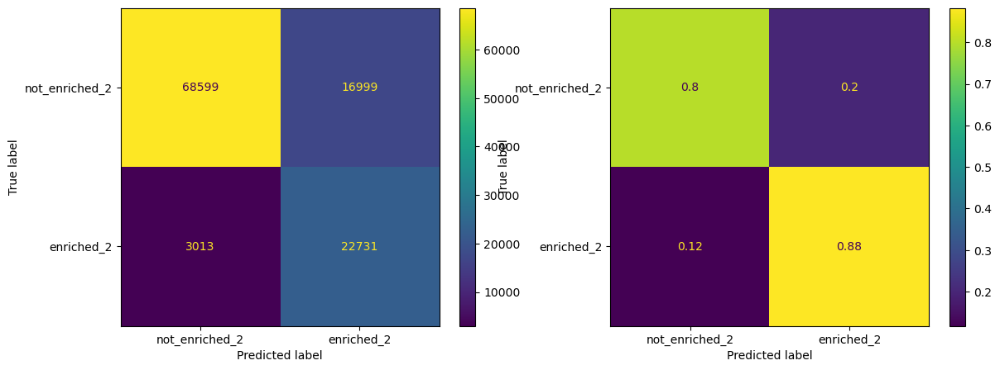

In [128]:
# Model Accuracy, how often is the classifier correct?
print("----- Arbre de décision (density20 > 0) -----")
print("Accuracy Train:", accuracy_score(Y_density_train, y_density_train_pred))
print("AUC Train:", auc(false_pos_rate_train, true_pos_rate_train))
print()
print("Accuracy Test:", accuracy_score(Y_density_test, y_density_test_pred))
print("AUC Test:", auc(false_pos_rate_test, true_pos_rate_test))
print()

fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(14, 5))
cm = confusion_matrix(Y_density_test, y_density_test_pred)
cm2 = confusion_matrix(Y_density_test, y_density_test_pred, normalize="true")
ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=labels_class).plot(ax=ax1)
ConfusionMatrixDisplay(confusion_matrix=cm2, display_labels=labels_class).plot(ax=ax2)
plt.show()

Arbre de décision acc, Angle avec Dist
Accuracy Train: 0.8338863270694925
AUC Train: 0.8600158942147669

Accuracy Test: 0.8250615221569578
AUC Test: 0.8472744054982551


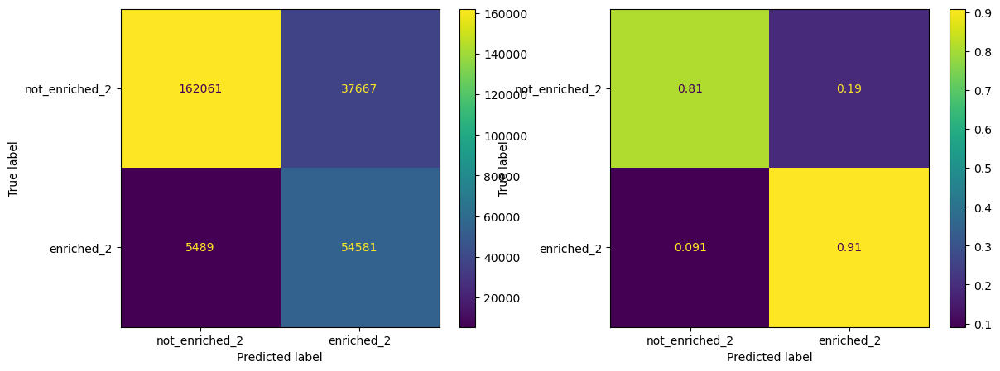

In [129]:
print("Arbre de décision acc, Angle avec Dist")
print("Accuracy Train:", accuracy_score(Y_density_dist_train, y_density_dist_train_pred))
print("AUC Train:", auc(false_pos_rate_dist_train, true_pos_rate_dist_train))
print()
print("Accuracy Test:", accuracy_score(Y_density_dist_test, y_density_dist_test_pred))
print("AUC Test:", auc(false_pos_rate_dist_test, true_pos_rate_dist_test))

fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(14, 5))
cm_dist = confusion_matrix(Y_density_dist_train, y_density_dist_train_pred)
cm2_dist = confusion_matrix(Y_density_dist_train, y_density_dist_train_pred, normalize="true")
ConfusionMatrixDisplay(confusion_matrix=cm_dist, display_labels=labels_class).plot(ax=ax1)
ConfusionMatrixDisplay(confusion_matrix=cm2_dist, display_labels=labels_class).plot(ax=ax2)
plt.show()

In [130]:
# Arbre de Décision
fig = plt.figure(figsize=(10, 30))
dot_data = tree.export_graphviz(
    clf_density_enriched_2,
    feature_names=x_columns,
    class_names=labels_class,
    filled=True
)
graph = graphviz.Source(dot_data, format="png")
#graph.render("../out/WT_decision_tree_density_t-plus_dist")
graph

<Figure size 1000x3000 with 0 Axes>

In [131]:
# Arbre de décision avec l'ajout de Dist & Angle
fig = plt.figure(figsize=(10, 30))
dot_data = tree.export_graphviz(
    clf_density_dist_enriched_2,
    feature_names=x_columns_dist,
    class_names=labels_class,
    filled=True
)

graph = graphviz.Source(dot_data, format="png")
graph.render("../out/WT_decision_tree_density_t-plus_dist")
graph

dot: graph is too large for cairo-renderer bitmaps. Scaling by 0.19744 to fit


<Figure size 1000x3000 with 0 Axes>

##### Random Forest

In [132]:
max_depths_rd = [2, 6, 10, 15, 20]
results_density_t_enriched_2_rf = models.forest_depth_acc(
    X_density_train, Y_density_train,
    X_density_test, Y_density_test,
    depths=max_depths_rd, 
    classifier=RandomForestClassifier,
    n_estimators = 100,
    class_weight="balanced",
    n_jobs=-1
)

results_density_dist_t_enriched_2_rf = models.forest_depth_acc(
    X_density_dist_train, Y_density_dist_train,
    X_density_dist_test, Y_density_dist_test,
    depths=max_depths_rd, 
    classifier=RandomForestClassifier,
    n_estimators = 100,
    class_weight="balanced",
    n_jobs=-1
)

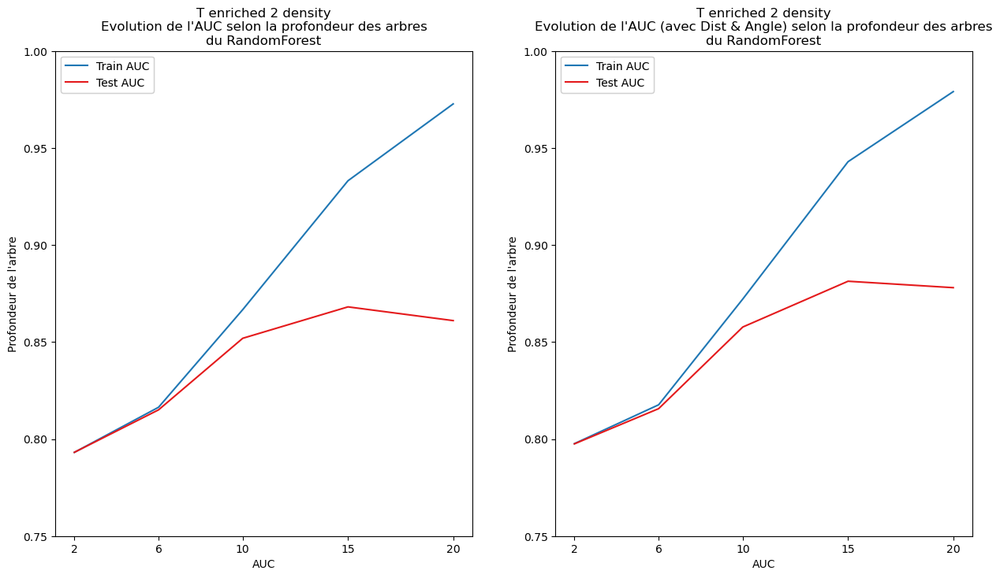

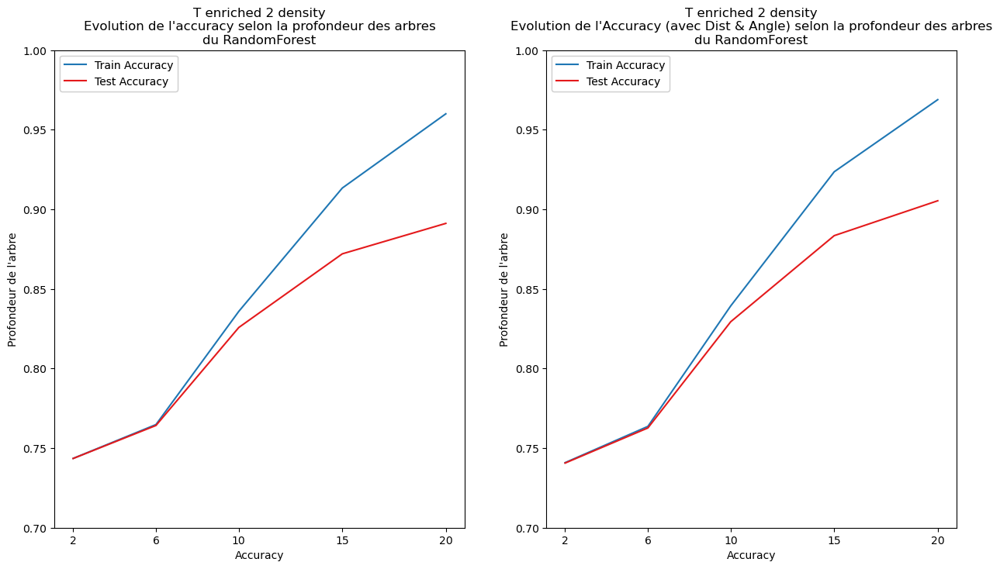

In [133]:
# Plot
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(15, 8))

plots.plot(
    results_density_t_enriched_2_rf["auc_train"],
    results_density_t_enriched_2_rf["auc_test"],
    indices=results_density_t_enriched_2_rf["depths"],
    label=("Train AUC", "Test AUC"),
    title="T enriched 2 density\nEvolution de l'AUC selon la profondeur des arbres\ndu RandomForest",
    xlabel="AUC", ylabel="Profondeur de l'arbre",
    xticks=results_density_t_enriched_2_rf["depths"], showR2=False, showY=False,
    ytop=1, ybottom=0.75, figure=(fig, ax1)
)

plots.plot(
    results_density_dist_t_enriched_2_rf["auc_train"],
    results_density_dist_t_enriched_2_rf["auc_test"],
    indices=results_density_dist_t_enriched_2_rf["depths"],
    label=("Train AUC", "Test AUC"),
    title="T enriched 2 density\nEvolution de l'AUC (avec Dist & Angle) selon la profondeur des arbres\ndu RandomForest",
    xlabel="AUC", ylabel="Profondeur de l'arbre",
    xticks=results_density_dist_t_enriched_2_rf["depths"], showR2=False, showY=False,
    ytop=1, ybottom=0.75, figure=(fig, ax2)
)

plt.show()

# Plot
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(15, 8))

plots.plot(
    results_density_t_enriched_2_rf["acc_train"],
    results_density_t_enriched_2_rf["acc_test"],
    indices=results_density_t_enriched_2_rf["depths"],
    label=("Train Accuracy", "Test Accuracy"),
    title="T enriched 2 density\nEvolution de l'accuracy selon la profondeur des arbres\ndu RandomForest",
    xlabel="Accuracy", ylabel="Profondeur de l'arbre",
    xticks=results_density_t_enriched_2_rf["depths"], showR2=False, showY=False,
    ytop=1, ybottom=0.7, figure=(fig, ax1)
)

plots.plot(
    results_density_dist_t_enriched_2_rf["acc_train"],
    results_density_dist_t_enriched_2_rf["acc_test"],
    indices=results_density_dist_t_enriched_2_rf["depths"],
    label=("Train Accuracy", "Test Accuracy"),
    title="T enriched 2 density\nEvolution de l'Accuracy (avec Dist & Angle) selon la profondeur des arbres\ndu RandomForest",
    xlabel="Accuracy", ylabel="Profondeur de l'arbre",
    xticks=results_density_dist_t_enriched_2_rf["depths"], showR2=False, showY=False,
    ytop=1, ybottom=0.7, figure=(fig, ax2)
)

plt.show()

In [134]:
print("----- Résumé des performances T enrichie (density20 > 0), Random Forest -----")
print(f"{'Profondeur':<20s}:", end=" ") ; [print(f"{i:<4d}", end="  ") for i in results_density_t_enriched_2_rf["depths"]] ; print("\n")
print(f"{'AUC_train':<20s}:", end=" ") ; [print(f"{i:<.2f}", end="  ") for i in results_density_t_enriched_2_rf["auc_train"]] ; print()
print(f"{'AUC_test':<20s}:", end=" ") ; [print(f"{i:<.2f}", end="  ") for i in results_density_t_enriched_2_rf["auc_test"]] ; print("\n")

print(f"{'Accuracy_train':<20s}:", end=" ") ; [print(f"{i:<.2f}", end="  ") for i in results_density_t_enriched_2_rf["acc_train"]] ; print()
print(f"{'Accuracy_test':<20s}:", end=" ") ; [print(f"{i:<.2f}", end="  ") for i in results_density_t_enriched_2_rf["acc_test"]] ; print("\n")

print("---")
print(f"{'AUC_train_dist':<20s}:", end=" ") ; [print(f"{i:<.2f}", end="  ") for i in results_density_dist_t_enriched_2_rf["auc_train"]] ; print()
print(f"{'AUC_test_dist':<20s}:", end=" ") ; [print(f"{i:<.2f}", end="  ") for i in results_density_dist_t_enriched_2_rf["auc_test"]] ; print("\n")

print(f"{'Accuracy_train_dist':<20s}:", end=" ") ; [print(f"{i:<.2f}", end="  ") for i in results_density_dist_t_enriched_2_rf["acc_train"]] ; print()
print(f"{'Accuracy_test_dist':<20s}:", end=" ") ; [print(f"{i:<.2f}", end="  ") for i in results_density_dist_t_enriched_2_rf["acc_test"]] ; print()

----- Résumé des performances T enrichie (density20 > 0), Random Forest -----
Profondeur          : 2     6     10    15    20    

AUC_train           : 0.79  0.82  0.87  0.93  0.97  
AUC_test            : 0.79  0.82  0.85  0.87  0.86  

Accuracy_train      : 0.74  0.76  0.84  0.91  0.96  
Accuracy_test       : 0.74  0.76  0.83  0.87  0.89  

---
AUC_train_dist      : 0.80  0.82  0.87  0.94  0.98  
AUC_test_dist       : 0.80  0.82  0.86  0.88  0.88  

Accuracy_train_dist : 0.74  0.76  0.84  0.92  0.97  
Accuracy_test_dist  : 0.74  0.76  0.83  0.88  0.91  


Best hyperparameters: {'n_estimators': 30, 'max_depth': 15}
Test Accuracy: 0.8698155233424943
Elapsed time to compute the importances: 0.006 seconds
Elapsed time to compute the importances: 30.028 seconds


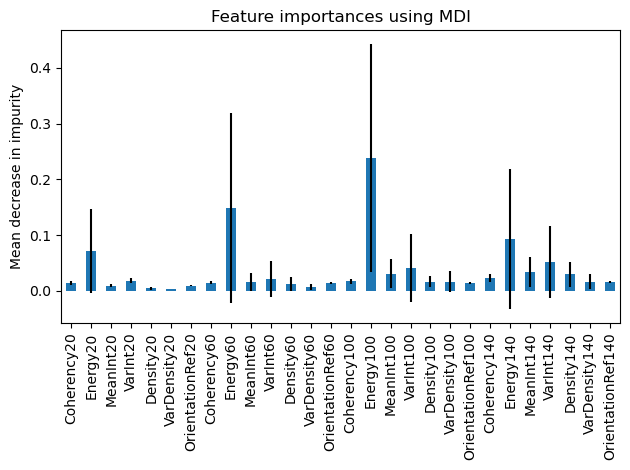

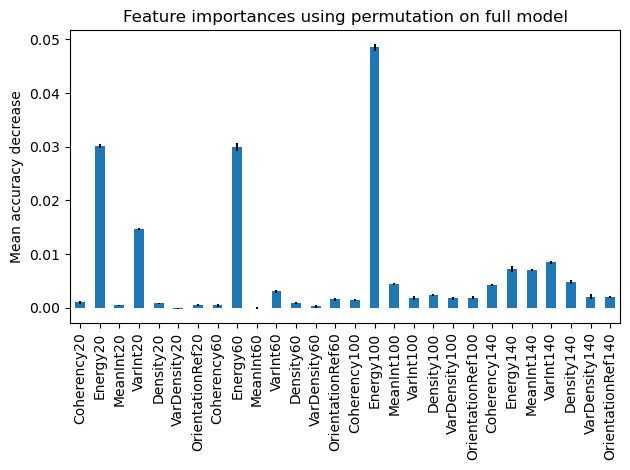

In [135]:
# Random forest
results_density_enriched_2 = models.perform_random_forest(
    X_train=X_density_train,
    X_test=X_density_test,
    y_train=Y_density_train,
    y_test=Y_density_test,
    columns=x_columns,
    n_estimators=(10, 15, 20, 30),
    n_depths=(2, 4, 8, 10, 15),
    class_weight="balanced",
    scale=False
)

rf_density_enriched_2 = results_density_enriched_2["model"]

In [136]:
df_mdi = pd.DataFrame(
    {
        "mean": results_density_enriched_2["importance_mdi"]["mean"],
        "std": results_density_enriched_2["importance_mdi"]["std"]
    }, index=x_columns
)

df_mdi.to_csv("WT_CD3_enriched_2_density_importance-mdi.csv")

df_permutation = pd.DataFrame(
    {
        "mean": results_density_enriched_2["importance_permutation"]["mean"],
        "std": results_density_enriched_2["importance_permutation"]["std"]
    }, index=x_columns
)

df_permutation.to_csv("WT_CD3_enriched_2_density_importance-permutation.csv")

Best hyperparameters: {'n_estimators': 20, 'max_depth': 15}
Test Accuracy: 0.88111404501446
Elapsed time to compute the importances: 0.004 seconds
Elapsed time to compute the importances: 21.508 seconds


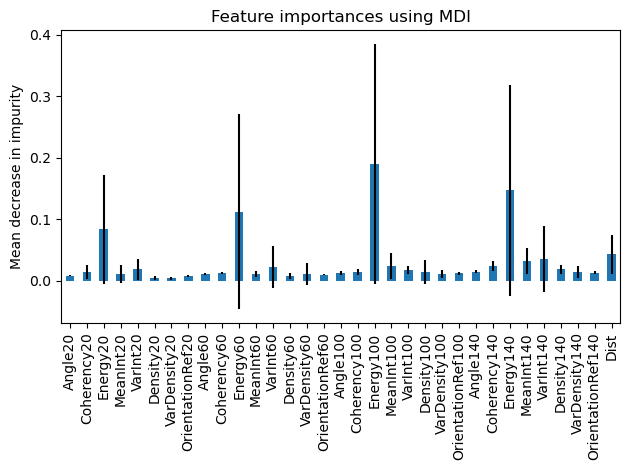

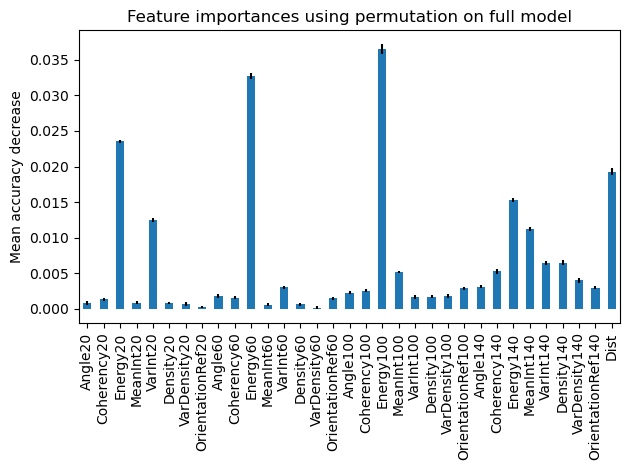

In [137]:
# Random forest with Dist & Angle
results_density_dist_enriched_2 = models.perform_random_forest(
    X_train=X_density_dist_train,
    X_test=X_density_dist_test,
    y_train=Y_density_dist_train,
    y_test=Y_density_dist_test,
    columns=x_columns_dist,
    n_estimators=(10, 15, 20, 30),
    n_depths=(2, 4, 8, 10, 15),
    class_weight="balanced",
    scale=False
)

rf_density_dist_enriched_2 = results_density_dist_enriched_2["model"]

In [138]:
df_mdi = pd.DataFrame(
    {
        "mean": results_density_dist_enriched_2["importance_mdi"]["mean"],
        "std": results_density_dist_enriched_2["importance_mdi"]["std"]
    }, index=x_columns_dist
)

df_mdi.to_csv("WT_CD3_enriched_2-dist_density_importance-mdi.csv")

df_permutation = pd.DataFrame(
    {
        "mean": results_density_dist_enriched_2["importance_permutation"]["mean"],
        "std": results_density_dist_enriched_2["importance_permutation"]["std"]
    }, index=x_columns_dist
)

df_permutation.to_csv("WT_CD3_enriched_2-dist_density_importance-permutation.csv")

In [139]:
# Model Accuracy, how often is the classifier correct?
y_density_train_pred = rf_density_enriched_2.predict(X_density_train)
y_density_test_pred = rf_density_enriched_2.predict(X_density_test)
y_density_dist_train_pred = rf_density_dist_enriched_2.predict(X_density_dist_train)
y_density_dist_test_pred = rf_density_dist_enriched_2.predict(X_density_dist_test)

# Performance
# Model Accuracy, how often is the classifier correct?
false_pos_rate_train, true_pos_rate_train, _ = roc_curve(Y_density_train, y_density_train_pred)
false_pos_rate_test, true_pos_rate_test, _ = roc_curve(Y_density_test, y_density_test_pred)

false_pos_rate_dist_train, true_pos_rate_dist_train, _ = roc_curve(Y_density_dist_train, y_density_dist_train_pred)
false_pos_rate_dist_test, true_pos_rate_dist_test, _ = roc_curve(Y_density_dist_test, y_density_dist_test_pred)

# Model Accuracy, how often is the classifier correct?
print("----- Random Forest (density20 > 0) -----")
print("Accuracy Train:", accuracy_score(Y_density_train, y_density_train_pred))
print("AUC Train:", auc(false_pos_rate_train, true_pos_rate_train))
print()
print("Accuracy Test:", accuracy_score(Y_density_test, y_density_test_pred))
print("AUC Test:", auc(false_pos_rate_test, true_pos_rate_test))
print()

print("Random Forest, Angle avec Dist")
print("Accuracy Train:", accuracy_score(Y_density_dist_train, y_density_dist_train_pred))
print("AUC Train:", auc(false_pos_rate_dist_train, true_pos_rate_dist_train))
print()
print("Accuracy Test:", accuracy_score(Y_density_dist_test, y_density_dist_test_pred))
print("AUC Test:", auc(false_pos_rate_dist_test, true_pos_rate_dist_test))

----- Random Forest (density20 > 0) -----
Accuracy Train: 0.9110616709905388
AUC Train: 0.9301143019630719

Accuracy Test: 0.8698155233424943
AUC Test: 0.865720510512587

Random Forest, Angle avec Dist
Accuracy Train: 0.9222588318616771
AUC Train: 0.9399285007800388

Accuracy Test: 0.88111404501446
AUC Test: 0.8775912005518272


In [140]:
labels_class = pd.Series(rf_density_enriched_2.classes_).map({0: 'not_enriched_2', 1: 'enriched_2'}).values

----- Random Forest (density20 > 0) -----
Accuracy Train: 0.9110616709905388
AUC Train: 0.9301143019630719

Accuracy Test: 0.8698155233424943
AUC Test: 0.865720510512587



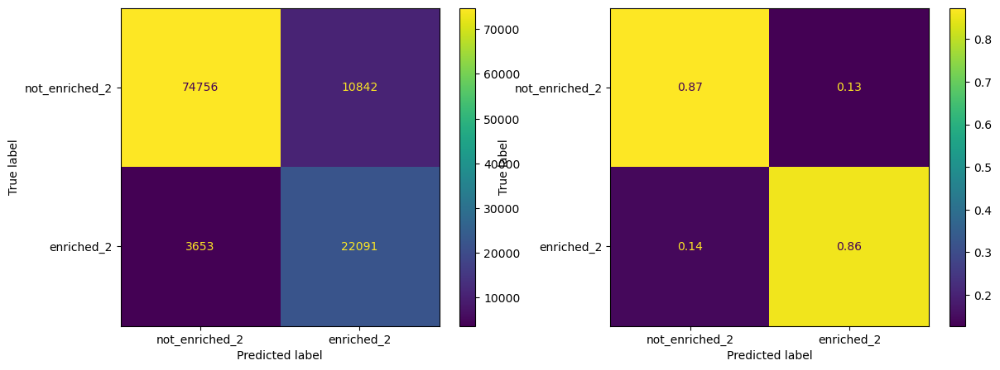

In [141]:
print("----- Random Forest (density20 > 0) -----")
print("Accuracy Train:", accuracy_score(Y_density_train, y_density_train_pred))
print("AUC Train:", auc(false_pos_rate_train, true_pos_rate_train))
print()
print("Accuracy Test:", accuracy_score(Y_density_test, y_density_test_pred))
print("AUC Test:", auc(false_pos_rate_test, true_pos_rate_test))
print()

fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(14, 5))
cm = confusion_matrix(Y_density_test, y_density_test_pred)
cm2 = confusion_matrix(Y_density_test, y_density_test_pred, normalize="true")
ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=labels_class).plot(ax=ax1)
ConfusionMatrixDisplay(confusion_matrix=cm2, display_labels=labels_class).plot(ax=ax2)
plt.show()

Random Forest, Angle avec Dist
Accuracy Train: 0.9222588318616771
AUC Train: 0.9399285007800388

Accuracy Test: 0.88111404501446
AUC Test: 0.8775912005518272


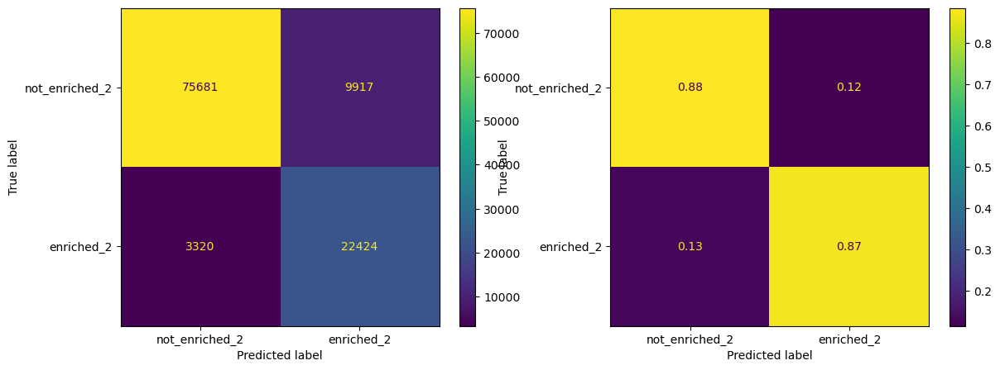

In [142]:
print("Random Forest, Angle avec Dist")
print("Accuracy Train:", accuracy_score(Y_density_dist_train, y_density_dist_train_pred))
print("AUC Train:", auc(false_pos_rate_dist_train, true_pos_rate_dist_train))
print()
print("Accuracy Test:", accuracy_score(Y_density_dist_test, y_density_dist_test_pred))
print("AUC Test:", auc(false_pos_rate_dist_test, true_pos_rate_dist_test))

fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(14, 5))
cm_dist = confusion_matrix(Y_density_dist_test, y_density_dist_test_pred)
cm2_dist = confusion_matrix(Y_density_dist_test, y_density_dist_test_pred, normalize="true")
ConfusionMatrixDisplay(confusion_matrix=cm_dist, display_labels=labels_class).plot(ax=ax1)
ConfusionMatrixDisplay(confusion_matrix=cm2_dist, display_labels=labels_class).plot(ax=ax2)
plt.show()